In [5]:
from src.time_series_prep import *
import pandas as pd
from models.generalized_model import GeneralizedModel
from models.shared_layer import *

from torchviz import make_dot
from torchsummary import summary
from src.data_preprocessing import *
from src.visualizations import *
from src.global_configs import *
from src.time_series_prep import *
import logging

# Initialize logger
logging.basicConfig(
    filename='training.log',  # File where logs will be saved
    level=logging.INFO,  # Set logging level to INFO
    format='%(asctime)s - %(levelname)s - %(message)s',  # Log format
    # filemode='w'  # Overwrite log file on each run
)
logger = logging.getLogger()

In [6]:
model_type = "generalized"
patients_list = ['559', '563', '570', '575', '588', '591', '540', '544', '552', '567', '584', '596']

scaler = process_all_csv_files(input_folder, output_folder_train, timestamp_col='ts', freq='5min', agg_func='mean')

In [7]:
# prediction_horizons = [15,30,60,90,120,150,180]
prediction_horizons = [3, 6, 12, 18, 24, 30, 36]
histories_withval_PHs =  {key: [] for key in prediction_horizons}
histories_noval_PHs = {key: [] for key in prediction_horizons}
abs_patients_errors_PHs =  {key: [] for key in prediction_horizons}
squared_patients_errors_PHs =  {key: [] for key in prediction_horizons}

MAE_Patients_PHs =  {key: [] for key in prediction_horizons}
RMSE_Patients_PHs =  {key: [] for key in prediction_horizons}


In [8]:
for prediction_horizon in prediction_horizons:
    logger.info(f"Start Prediction Horizon {prediction_horizon} of {model_type} model")
    print(f"Start Prediction Horizon {prediction_horizon} of {model_type} model")

    train_loader, validation_loader,all_train_loader, test_loader, input_shape, input_shape_test, output_shape, output_shape_test =  prepare_data_loader(
                                                                                    window_size,BATCH_SIZE, prediction_horizon,
                                                                                    model_type , split_ratio=0.7, df = None, df_test = None, output_folder_train = output_folder_train, shuffle = True)
    
    # model = GeneralizedModel(input_shape=input_shape, output_shape=output_shape)
    # model = model.to(device)
    # model, history = train_model(model, train_loader,validation_loader, epochs=100, learning_rate=0.00001, model_type = model_type)
    # histories_withval_PHs[prediction_horizon] = history

    model_all_train = GeneralizedModel(input_shape =input_shape , output_shape=output_shape) 
    model_all_train = model_all_train.to(device)
    model_all_train, history2 = train_model(model_all_train, all_train_loader, val_loader = test_loader, epochs=100, learning_rate=0.00001, model_type = model_type)
    histories_noval_PHs[prediction_horizon] = history2

    model_all_train.eval()
    # mae, rmse, each_patient_mae, each_patient_rmse= evaluate_test(model_all_train,test_loader, device ,scaler, mask_value, model_type = model_type)
    each_patient_mae, each_patient_rmse= evaluate_test(model_all_train,test_loader, device ,scaler, mask_value, model_type = model_type)

    # logger.info(f"Average MAE of Prediction Horizon {str(prediction_horizon)}: {mae}")
    # logger.info(f"Average RMSE of Prediction Horizon {str(prediction_horizon)}: {rmse}") 
    # print(f"Average MAE of Prediction Horizon: {mae}")
    # print(f"Average RMSE of Prediction Horizon: {rmse}")

    abs_patients_errors_PHs[prediction_horizon] = each_patient_mae
    squared_patients_errors_PHs[prediction_horizon] = each_patient_rmse
    # MAE_Patients_PHs[prediction_horizon] = mae
    # RMSE_Patients_PHs[prediction_horizon] = rmse

    logger.info(f"End Prediction Horizon of {prediction_horizon} of {model_type} Model")
    print(f"End Prediction Horizon of {prediction_horizon} of {model_type} Model")
    torch.save(model_all_train.state_dict(), f'saved_models//model_{model_type}_{str(prediction_horizon)}.pth')
    print(f"model_{model_type}_{str(prediction_horizon)} saved")
    logger.info(f"model_{model_type}_{str(prediction_horizon)} saved")


Start Prediction Horizon 3 of generalized model
Shape of X (features): (12, 13621, 6)
Shape of y (targets): (12, 13621)
Shape of X_test (features): (12, 3942, 6)
Shape of y_test (targets): (12, 3942)


Epoch 1/100: 100%|██████████| 213/213 [00:07<00:00, 28.13batch/s, mae_loss=0.666]


Epoch [1/100], Training MAE: 0.6698, Training RMSE: 0.9078
Epoch [1/100], Validation MAE: 0.5494, Validation RMSE: 0.8144


Epoch 2/100: 100%|██████████| 213/213 [00:08<00:00, 25.13batch/s, mae_loss=0.685]


Epoch [2/100], Training MAE: 0.6638, Training RMSE: 0.9009
Epoch [2/100], Validation MAE: 0.5440, Validation RMSE: 0.8083


Epoch 3/100: 100%|██████████| 213/213 [00:08<00:00, 25.60batch/s, mae_loss=0.61] 


Epoch [3/100], Training MAE: 0.6575, Training RMSE: 0.8937
Epoch [3/100], Validation MAE: 0.5383, Validation RMSE: 0.8014


Epoch 4/100: 100%|██████████| 213/213 [00:07<00:00, 27.79batch/s, mae_loss=0.648]


Epoch [4/100], Training MAE: 0.6511, Training RMSE: 0.8858
Epoch [4/100], Validation MAE: 0.5319, Validation RMSE: 0.7938


Epoch 5/100: 100%|██████████| 213/213 [00:07<00:00, 28.60batch/s, mae_loss=0.657]


Epoch [5/100], Training MAE: 0.6438, Training RMSE: 0.8768
Epoch [5/100], Validation MAE: 0.5253, Validation RMSE: 0.7850


Epoch 6/100: 100%|██████████| 213/213 [00:07<00:00, 27.88batch/s, mae_loss=0.61] 


Epoch [6/100], Training MAE: 0.6357, Training RMSE: 0.8662
Epoch [6/100], Validation MAE: 0.5175, Validation RMSE: 0.7745


Epoch 7/100: 100%|██████████| 213/213 [00:07<00:00, 28.58batch/s, mae_loss=0.621]


Epoch [7/100], Training MAE: 0.6269, Training RMSE: 0.8544
Epoch [7/100], Validation MAE: 0.5101, Validation RMSE: 0.7635


Epoch 8/100: 100%|██████████| 213/213 [00:07<00:00, 29.64batch/s, mae_loss=0.571]


Epoch [8/100], Training MAE: 0.6169, Training RMSE: 0.8411
Epoch [8/100], Validation MAE: 0.5021, Validation RMSE: 0.7510


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 30.97batch/s, mae_loss=0.646]


Epoch [9/100], Training MAE: 0.6063, Training RMSE: 0.8264
Epoch [9/100], Validation MAE: 0.4930, Validation RMSE: 0.7371


Epoch 10/100: 100%|██████████| 213/213 [00:07<00:00, 27.75batch/s, mae_loss=0.61] 


Epoch [10/100], Training MAE: 0.5948, Training RMSE: 0.8107
Epoch [10/100], Validation MAE: 0.4840, Validation RMSE: 0.7225


Epoch 11/100: 100%|██████████| 213/213 [00:08<00:00, 24.77batch/s, mae_loss=0.528]


Epoch [11/100], Training MAE: 0.5827, Training RMSE: 0.7942
Epoch [11/100], Validation MAE: 0.4747, Validation RMSE: 0.7074


Epoch 12/100: 100%|██████████| 213/213 [00:06<00:00, 31.24batch/s, mae_loss=0.574]


Epoch [12/100], Training MAE: 0.5698, Training RMSE: 0.7770
Epoch [12/100], Validation MAE: 0.4642, Validation RMSE: 0.6907


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 31.95batch/s, mae_loss=0.562]


Epoch [13/100], Training MAE: 0.5573, Training RMSE: 0.7596
Epoch [13/100], Validation MAE: 0.4540, Validation RMSE: 0.6744


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 31.24batch/s, mae_loss=0.555]


Epoch [14/100], Training MAE: 0.5439, Training RMSE: 0.7415
Epoch [14/100], Validation MAE: 0.4434, Validation RMSE: 0.6575


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 31.56batch/s, mae_loss=0.56] 


Epoch [15/100], Training MAE: 0.5314, Training RMSE: 0.7247
Epoch [15/100], Validation MAE: 0.4325, Validation RMSE: 0.6406


Epoch 16/100: 100%|██████████| 213/213 [00:07<00:00, 30.00batch/s, mae_loss=0.499]


Epoch [16/100], Training MAE: 0.5182, Training RMSE: 0.7064
Epoch [16/100], Validation MAE: 0.4216, Validation RMSE: 0.6237


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 31.83batch/s, mae_loss=0.495]


Epoch [17/100], Training MAE: 0.5057, Training RMSE: 0.6891
Epoch [17/100], Validation MAE: 0.4109, Validation RMSE: 0.6073


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 31.38batch/s, mae_loss=0.497]


Epoch [18/100], Training MAE: 0.4939, Training RMSE: 0.6729
Epoch [18/100], Validation MAE: 0.4006, Validation RMSE: 0.5917


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 30.51batch/s, mae_loss=0.458]


Epoch [19/100], Training MAE: 0.4819, Training RMSE: 0.6567
Epoch [19/100], Validation MAE: 0.3899, Validation RMSE: 0.5757


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 31.20batch/s, mae_loss=0.431]


Epoch [20/100], Training MAE: 0.4705, Training RMSE: 0.6415
Epoch [20/100], Validation MAE: 0.3796, Validation RMSE: 0.5605


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 31.84batch/s, mae_loss=0.476]


Epoch [21/100], Training MAE: 0.4590, Training RMSE: 0.6260
Epoch [21/100], Validation MAE: 0.3696, Validation RMSE: 0.5455


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 31.24batch/s, mae_loss=0.443]


Epoch [22/100], Training MAE: 0.4492, Training RMSE: 0.6123
Epoch [22/100], Validation MAE: 0.3596, Validation RMSE: 0.5308


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 31.58batch/s, mae_loss=0.433]


Epoch [23/100], Training MAE: 0.4390, Training RMSE: 0.5983
Epoch [23/100], Validation MAE: 0.3504, Validation RMSE: 0.5171


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 30.98batch/s, mae_loss=0.438]


Epoch [24/100], Training MAE: 0.4307, Training RMSE: 0.5863
Epoch [24/100], Validation MAE: 0.3416, Validation RMSE: 0.5037


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 31.16batch/s, mae_loss=0.391]


Epoch [25/100], Training MAE: 0.4209, Training RMSE: 0.5733
Epoch [25/100], Validation MAE: 0.3324, Validation RMSE: 0.4904


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 31.91batch/s, mae_loss=0.382]


Epoch [26/100], Training MAE: 0.4128, Training RMSE: 0.5617
Epoch [26/100], Validation MAE: 0.3246, Validation RMSE: 0.4783


Epoch 27/100: 100%|██████████| 213/213 [00:07<00:00, 30.42batch/s, mae_loss=0.402]


Epoch [27/100], Training MAE: 0.4054, Training RMSE: 0.5511
Epoch [27/100], Validation MAE: 0.3161, Validation RMSE: 0.4658


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 31.43batch/s, mae_loss=0.395]


Epoch [28/100], Training MAE: 0.3988, Training RMSE: 0.5416
Epoch [28/100], Validation MAE: 0.3083, Validation RMSE: 0.4546


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 30.82batch/s, mae_loss=0.408]


Epoch [29/100], Training MAE: 0.3910, Training RMSE: 0.5305
Epoch [29/100], Validation MAE: 0.3004, Validation RMSE: 0.4428


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 31.78batch/s, mae_loss=0.409]


Epoch [30/100], Training MAE: 0.3856, Training RMSE: 0.5224
Epoch [30/100], Validation MAE: 0.2927, Validation RMSE: 0.4319


Epoch 31/100: 100%|██████████| 213/213 [00:07<00:00, 28.15batch/s, mae_loss=0.383]


Epoch [31/100], Training MAE: 0.3797, Training RMSE: 0.5141
Epoch [31/100], Validation MAE: 0.2857, Validation RMSE: 0.4220


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 31.38batch/s, mae_loss=0.345]


Epoch [32/100], Training MAE: 0.3726, Training RMSE: 0.5045
Epoch [32/100], Validation MAE: 0.2790, Validation RMSE: 0.4123


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 31.09batch/s, mae_loss=0.36] 


Epoch [33/100], Training MAE: 0.3690, Training RMSE: 0.4987
Epoch [33/100], Validation MAE: 0.2723, Validation RMSE: 0.4033


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 31.88batch/s, mae_loss=0.37] 


Epoch [34/100], Training MAE: 0.3645, Training RMSE: 0.4926
Epoch [34/100], Validation MAE: 0.2657, Validation RMSE: 0.3942


Epoch 35/100: 100%|██████████| 213/213 [00:07<00:00, 29.38batch/s, mae_loss=0.355]


Epoch [35/100], Training MAE: 0.3599, Training RMSE: 0.4860
Epoch [35/100], Validation MAE: 0.2602, Validation RMSE: 0.3866


Epoch 36/100: 100%|██████████| 213/213 [00:07<00:00, 28.86batch/s, mae_loss=0.336]


Epoch [36/100], Training MAE: 0.3560, Training RMSE: 0.4803
Epoch [36/100], Validation MAE: 0.2550, Validation RMSE: 0.3793


Epoch 37/100: 100%|██████████| 213/213 [00:08<00:00, 25.66batch/s, mae_loss=0.353]


Epoch [37/100], Training MAE: 0.3522, Training RMSE: 0.4749
Epoch [37/100], Validation MAE: 0.2501, Validation RMSE: 0.3725


Epoch 38/100: 100%|██████████| 213/213 [00:07<00:00, 29.81batch/s, mae_loss=0.323]


Epoch [38/100], Training MAE: 0.3501, Training RMSE: 0.4716
Epoch [38/100], Validation MAE: 0.2457, Validation RMSE: 0.3672


Epoch 39/100: 100%|██████████| 213/213 [00:07<00:00, 28.14batch/s, mae_loss=0.327]


Epoch [39/100], Training MAE: 0.3475, Training RMSE: 0.4680
Epoch [39/100], Validation MAE: 0.2418, Validation RMSE: 0.3619


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 31.87batch/s, mae_loss=0.323]


Epoch [40/100], Training MAE: 0.3444, Training RMSE: 0.4634
Epoch [40/100], Validation MAE: 0.2386, Validation RMSE: 0.3574


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 32.16batch/s, mae_loss=0.36] 


Epoch [41/100], Training MAE: 0.3426, Training RMSE: 0.4608
Epoch [41/100], Validation MAE: 0.2359, Validation RMSE: 0.3539


Epoch 42/100: 100%|██████████| 213/213 [00:06<00:00, 31.07batch/s, mae_loss=0.351]


Epoch [42/100], Training MAE: 0.3409, Training RMSE: 0.4585
Epoch [42/100], Validation MAE: 0.2333, Validation RMSE: 0.3507


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 32.04batch/s, mae_loss=0.35] 


Epoch [43/100], Training MAE: 0.3394, Training RMSE: 0.4566
Epoch [43/100], Validation MAE: 0.2316, Validation RMSE: 0.3486


Epoch 44/100: 100%|██████████| 213/213 [00:07<00:00, 30.10batch/s, mae_loss=0.313]


Epoch [44/100], Training MAE: 0.3373, Training RMSE: 0.4531
Epoch [44/100], Validation MAE: 0.2297, Validation RMSE: 0.3459


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 31.90batch/s, mae_loss=0.343]


Epoch [45/100], Training MAE: 0.3360, Training RMSE: 0.4522
Epoch [45/100], Validation MAE: 0.2278, Validation RMSE: 0.3438


Epoch 46/100: 100%|██████████| 213/213 [00:07<00:00, 29.02batch/s, mae_loss=0.339]


Epoch [46/100], Training MAE: 0.3348, Training RMSE: 0.4501
Epoch [46/100], Validation MAE: 0.2270, Validation RMSE: 0.3423


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 31.08batch/s, mae_loss=0.355]


Epoch [47/100], Training MAE: 0.3342, Training RMSE: 0.4488
Epoch [47/100], Validation MAE: 0.2257, Validation RMSE: 0.3410


Epoch 48/100: 100%|██████████| 213/213 [00:07<00:00, 30.37batch/s, mae_loss=0.325]


Epoch [48/100], Training MAE: 0.3341, Training RMSE: 0.4492
Epoch [48/100], Validation MAE: 0.2251, Validation RMSE: 0.3399


Epoch 49/100: 100%|██████████| 213/213 [00:07<00:00, 30.11batch/s, mae_loss=0.341]


Epoch [49/100], Training MAE: 0.3331, Training RMSE: 0.4480
Epoch [49/100], Validation MAE: 0.2239, Validation RMSE: 0.3388


Epoch 50/100: 100%|██████████| 213/213 [00:07<00:00, 29.66batch/s, mae_loss=0.36] 


Epoch [50/100], Training MAE: 0.3327, Training RMSE: 0.4473
Epoch [50/100], Validation MAE: 0.2231, Validation RMSE: 0.3380


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 31.32batch/s, mae_loss=0.339]


Epoch [51/100], Training MAE: 0.3317, Training RMSE: 0.4463
Epoch [51/100], Validation MAE: 0.2224, Validation RMSE: 0.3371


Epoch 52/100: 100%|██████████| 213/213 [00:07<00:00, 29.96batch/s, mae_loss=0.311]


Epoch [52/100], Training MAE: 0.3304, Training RMSE: 0.4450
Epoch [52/100], Validation MAE: 0.2220, Validation RMSE: 0.3365


Epoch 53/100: 100%|██████████| 213/213 [00:07<00:00, 29.95batch/s, mae_loss=0.302]


Epoch [53/100], Training MAE: 0.3290, Training RMSE: 0.4426
Epoch [53/100], Validation MAE: 0.2218, Validation RMSE: 0.3358


Epoch 54/100: 100%|██████████| 213/213 [00:07<00:00, 27.82batch/s, mae_loss=0.294]


Epoch [54/100], Training MAE: 0.3287, Training RMSE: 0.4427
Epoch [54/100], Validation MAE: 0.2215, Validation RMSE: 0.3354


Epoch 55/100: 100%|██████████| 213/213 [00:07<00:00, 28.80batch/s, mae_loss=0.37] 


Epoch [55/100], Training MAE: 0.3294, Training RMSE: 0.4429
Epoch [55/100], Validation MAE: 0.2206, Validation RMSE: 0.3346


Epoch 56/100: 100%|██████████| 213/213 [00:07<00:00, 27.21batch/s, mae_loss=0.346]


Epoch [56/100], Training MAE: 0.3280, Training RMSE: 0.4414
Epoch [56/100], Validation MAE: 0.2205, Validation RMSE: 0.3343


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 31.03batch/s, mae_loss=0.323]


Epoch [57/100], Training MAE: 0.3272, Training RMSE: 0.4408
Epoch [57/100], Validation MAE: 0.2205, Validation RMSE: 0.3340


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 31.78batch/s, mae_loss=0.305]


Epoch [58/100], Training MAE: 0.3284, Training RMSE: 0.4418
Epoch [58/100], Validation MAE: 0.2198, Validation RMSE: 0.3334


Epoch 59/100: 100%|██████████| 213/213 [00:09<00:00, 23.18batch/s, mae_loss=0.325]


Epoch [59/100], Training MAE: 0.3271, Training RMSE: 0.4404
Epoch [59/100], Validation MAE: 0.2191, Validation RMSE: 0.3325


Epoch 60/100: 100%|██████████| 213/213 [00:08<00:00, 25.12batch/s, mae_loss=0.336]


Epoch [60/100], Training MAE: 0.3256, Training RMSE: 0.4392
Epoch [60/100], Validation MAE: 0.2191, Validation RMSE: 0.3325


Epoch 61/100: 100%|██████████| 213/213 [00:07<00:00, 26.74batch/s, mae_loss=0.328]


Epoch [61/100], Training MAE: 0.3259, Training RMSE: 0.4389
Epoch [61/100], Validation MAE: 0.2188, Validation RMSE: 0.3322


Epoch 62/100: 100%|██████████| 213/213 [00:08<00:00, 26.29batch/s, mae_loss=0.356]


Epoch [62/100], Training MAE: 0.3251, Training RMSE: 0.4377
Epoch [62/100], Validation MAE: 0.2186, Validation RMSE: 0.3317


Epoch 63/100: 100%|██████████| 213/213 [00:07<00:00, 30.34batch/s, mae_loss=0.322]


Epoch [63/100], Training MAE: 0.3244, Training RMSE: 0.4370
Epoch [63/100], Validation MAE: 0.2180, Validation RMSE: 0.3310


Epoch 64/100: 100%|██████████| 213/213 [00:07<00:00, 29.62batch/s, mae_loss=0.311]


Epoch [64/100], Training MAE: 0.3249, Training RMSE: 0.4386
Epoch [64/100], Validation MAE: 0.2178, Validation RMSE: 0.3308


Epoch 65/100: 100%|██████████| 213/213 [00:09<00:00, 23.33batch/s, mae_loss=0.324]


Epoch [65/100], Training MAE: 0.3236, Training RMSE: 0.4359
Epoch [65/100], Validation MAE: 0.2174, Validation RMSE: 0.3305


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 32.53batch/s, mae_loss=0.301]


Epoch [66/100], Training MAE: 0.3243, Training RMSE: 0.4367
Epoch [66/100], Validation MAE: 0.2171, Validation RMSE: 0.3298


Epoch 67/100: 100%|██████████| 213/213 [00:07<00:00, 27.46batch/s, mae_loss=0.307]


Epoch [67/100], Training MAE: 0.3223, Training RMSE: 0.4347
Epoch [67/100], Validation MAE: 0.2165, Validation RMSE: 0.3290


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 31.34batch/s, mae_loss=0.318]


Epoch [68/100], Training MAE: 0.3206, Training RMSE: 0.4325
Epoch [68/100], Validation MAE: 0.2163, Validation RMSE: 0.3287


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 31.36batch/s, mae_loss=0.311]


Epoch [69/100], Training MAE: 0.3213, Training RMSE: 0.4331
Epoch [69/100], Validation MAE: 0.2162, Validation RMSE: 0.3283


Epoch 70/100: 100%|██████████| 213/213 [00:07<00:00, 30.25batch/s, mae_loss=0.31] 


Epoch [70/100], Training MAE: 0.3211, Training RMSE: 0.4328
Epoch [70/100], Validation MAE: 0.2160, Validation RMSE: 0.3279


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 30.69batch/s, mae_loss=0.308]


Epoch [71/100], Training MAE: 0.3194, Training RMSE: 0.4311
Epoch [71/100], Validation MAE: 0.2156, Validation RMSE: 0.3273


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 32.51batch/s, mae_loss=0.323]


Epoch [72/100], Training MAE: 0.3199, Training RMSE: 0.4316
Epoch [72/100], Validation MAE: 0.2151, Validation RMSE: 0.3267


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.305]


Epoch [73/100], Training MAE: 0.3195, Training RMSE: 0.4304
Epoch [73/100], Validation MAE: 0.2148, Validation RMSE: 0.3265


Epoch 74/100: 100%|██████████| 213/213 [00:07<00:00, 29.57batch/s, mae_loss=0.297]


Epoch [74/100], Training MAE: 0.3204, Training RMSE: 0.4317
Epoch [74/100], Validation MAE: 0.2145, Validation RMSE: 0.3258


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 30.97batch/s, mae_loss=0.325]


Epoch [75/100], Training MAE: 0.3182, Training RMSE: 0.4293
Epoch [75/100], Validation MAE: 0.2145, Validation RMSE: 0.3258


Epoch 76/100: 100%|██████████| 213/213 [00:07<00:00, 30.09batch/s, mae_loss=0.303]


Epoch [76/100], Training MAE: 0.3188, Training RMSE: 0.4301
Epoch [76/100], Validation MAE: 0.2143, Validation RMSE: 0.3255


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 32.39batch/s, mae_loss=0.313]


Epoch [77/100], Training MAE: 0.3176, Training RMSE: 0.4290
Epoch [77/100], Validation MAE: 0.2140, Validation RMSE: 0.3252


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 32.07batch/s, mae_loss=0.33] 


Epoch [78/100], Training MAE: 0.3174, Training RMSE: 0.4286
Epoch [78/100], Validation MAE: 0.2133, Validation RMSE: 0.3243


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 32.00batch/s, mae_loss=0.309]


Epoch [79/100], Training MAE: 0.3170, Training RMSE: 0.4281
Epoch [79/100], Validation MAE: 0.2129, Validation RMSE: 0.3237


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 30.88batch/s, mae_loss=0.349]


Epoch [80/100], Training MAE: 0.3143, Training RMSE: 0.4245
Epoch [80/100], Validation MAE: 0.2127, Validation RMSE: 0.3234


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 31.83batch/s, mae_loss=0.292]


Epoch [81/100], Training MAE: 0.3164, Training RMSE: 0.4270
Epoch [81/100], Validation MAE: 0.2126, Validation RMSE: 0.3230


Epoch 82/100: 100%|██████████| 213/213 [00:07<00:00, 30.08batch/s, mae_loss=0.301]


Epoch [82/100], Training MAE: 0.3159, Training RMSE: 0.4267
Epoch [82/100], Validation MAE: 0.2120, Validation RMSE: 0.3227


Epoch 83/100: 100%|██████████| 213/213 [00:07<00:00, 28.86batch/s, mae_loss=0.326]


Epoch [83/100], Training MAE: 0.3152, Training RMSE: 0.4256
Epoch [83/100], Validation MAE: 0.2118, Validation RMSE: 0.3221


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 31.44batch/s, mae_loss=0.297]


Epoch [84/100], Training MAE: 0.3144, Training RMSE: 0.4251
Epoch [84/100], Validation MAE: 0.2116, Validation RMSE: 0.3217


Epoch 85/100: 100%|██████████| 213/213 [00:09<00:00, 22.42batch/s, mae_loss=0.312]


Epoch [85/100], Training MAE: 0.3141, Training RMSE: 0.4249
Epoch [85/100], Validation MAE: 0.2114, Validation RMSE: 0.3213


Epoch 86/100: 100%|██████████| 213/213 [00:08<00:00, 25.13batch/s, mae_loss=0.317]


Epoch [86/100], Training MAE: 0.3136, Training RMSE: 0.4239
Epoch [86/100], Validation MAE: 0.2110, Validation RMSE: 0.3209


Epoch 87/100: 100%|██████████| 213/213 [00:07<00:00, 29.57batch/s, mae_loss=0.302]


Epoch [87/100], Training MAE: 0.3130, Training RMSE: 0.4230
Epoch [87/100], Validation MAE: 0.2106, Validation RMSE: 0.3203


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 31.21batch/s, mae_loss=0.319]


Epoch [88/100], Training MAE: 0.3129, Training RMSE: 0.4227
Epoch [88/100], Validation MAE: 0.2102, Validation RMSE: 0.3198


Epoch 89/100: 100%|██████████| 213/213 [00:07<00:00, 27.81batch/s, mae_loss=0.323]


Epoch [89/100], Training MAE: 0.3124, Training RMSE: 0.4221
Epoch [89/100], Validation MAE: 0.2098, Validation RMSE: 0.3194


Epoch 90/100: 100%|██████████| 213/213 [00:07<00:00, 29.98batch/s, mae_loss=0.312]


Epoch [90/100], Training MAE: 0.3124, Training RMSE: 0.4221
Epoch [90/100], Validation MAE: 0.2095, Validation RMSE: 0.3191


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 31.63batch/s, mae_loss=0.33] 


Epoch [91/100], Training MAE: 0.3118, Training RMSE: 0.4217
Epoch [91/100], Validation MAE: 0.2095, Validation RMSE: 0.3188


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 33.01batch/s, mae_loss=0.33] 


Epoch [92/100], Training MAE: 0.3109, Training RMSE: 0.4206
Epoch [92/100], Validation MAE: 0.2091, Validation RMSE: 0.3182


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 31.76batch/s, mae_loss=0.314]


Epoch [93/100], Training MAE: 0.3117, Training RMSE: 0.4211
Epoch [93/100], Validation MAE: 0.2086, Validation RMSE: 0.3177


Epoch 94/100: 100%|██████████| 213/213 [00:07<00:00, 29.37batch/s, mae_loss=0.295]


Epoch [94/100], Training MAE: 0.3109, Training RMSE: 0.4201
Epoch [94/100], Validation MAE: 0.2085, Validation RMSE: 0.3174


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 30.91batch/s, mae_loss=0.302]


Epoch [95/100], Training MAE: 0.3095, Training RMSE: 0.4190
Epoch [95/100], Validation MAE: 0.2079, Validation RMSE: 0.3169


Epoch 96/100: 100%|██████████| 213/213 [00:07<00:00, 29.97batch/s, mae_loss=0.296]


Epoch [96/100], Training MAE: 0.3109, Training RMSE: 0.4200
Epoch [96/100], Validation MAE: 0.2079, Validation RMSE: 0.3165


Epoch 97/100: 100%|██████████| 213/213 [00:08<00:00, 25.88batch/s, mae_loss=0.326]


Epoch [97/100], Training MAE: 0.3094, Training RMSE: 0.4187
Epoch [97/100], Validation MAE: 0.2072, Validation RMSE: 0.3157


Epoch 98/100: 100%|██████████| 213/213 [00:07<00:00, 27.05batch/s, mae_loss=0.332]


Epoch [98/100], Training MAE: 0.3100, Training RMSE: 0.4191
Epoch [98/100], Validation MAE: 0.2069, Validation RMSE: 0.3154


Epoch 99/100: 100%|██████████| 213/213 [00:07<00:00, 29.79batch/s, mae_loss=0.305]


Epoch [99/100], Training MAE: 0.3087, Training RMSE: 0.4176
Epoch [99/100], Validation MAE: 0.2065, Validation RMSE: 0.3149


Epoch 100/100: 100%|██████████| 213/213 [00:07<00:00, 30.00batch/s, mae_loss=0.303]


Epoch [100/100], Training MAE: 0.3076, Training RMSE: 0.4164
Epoch [100/100], Validation MAE: 0.2064, Validation RMSE: 0.3145
182.8705560773198
193.9285632669406
136.91988819035893
116.87464430071438
187.556018130928
180.04276883115222
115.16848611403786
103.60887302470655
201.67528573145196
209.86357100328297
113.05708186200152
124.34422242445865
199.99956191477708
204.6534818789889
107.13294858877043
103.0364524164221
149.4762357119873
147.19435506113817
165.63002904721793
176.5571608063876
142.2900192612097
182.58435018054917
155.40750084702438
164.9282653046742
158.42881357633357
161.5289594922757
138.28449858424426
147.19435506113817
110.23535328265606
105.7850685774676
144.6718155770859
147.19435506113817
139.7404385323641
157.19668069247496
152.39132417474966
151.19484802895425
96.03395578154456
90.6626332512387
116.64306336751785
129.43112991998615
153.9854330187519
121.14545201972692
244.76075733669126
255.46552838404546
131.131793583405
135.56984636328772
147.42549782814177
1

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 31.88batch/s, mae_loss=0.681]


Epoch [1/100], Training MAE: 0.6650, Training RMSE: 0.9064
Epoch [1/100], Validation MAE: 0.5448, Validation RMSE: 0.8129


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 31.20batch/s, mae_loss=0.693]


Epoch [2/100], Training MAE: 0.6599, Training RMSE: 0.9001
Epoch [2/100], Validation MAE: 0.5411, Validation RMSE: 0.8079


Epoch 3/100: 100%|██████████| 213/213 [00:07<00:00, 29.40batch/s, mae_loss=0.675]


Epoch [3/100], Training MAE: 0.6547, Training RMSE: 0.8935
Epoch [3/100], Validation MAE: 0.5361, Validation RMSE: 0.8013


Epoch 4/100: 100%|██████████| 213/213 [00:07<00:00, 28.33batch/s, mae_loss=0.66] 


Epoch [4/100], Training MAE: 0.6493, Training RMSE: 0.8865
Epoch [4/100], Validation MAE: 0.5325, Validation RMSE: 0.7953


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 32.05batch/s, mae_loss=0.681]


Epoch [5/100], Training MAE: 0.6435, Training RMSE: 0.8786
Epoch [5/100], Validation MAE: 0.5283, Validation RMSE: 0.7884


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 31.18batch/s, mae_loss=0.644]


Epoch [6/100], Training MAE: 0.6370, Training RMSE: 0.8699
Epoch [6/100], Validation MAE: 0.5225, Validation RMSE: 0.7794


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 31.66batch/s, mae_loss=0.604]


Epoch [7/100], Training MAE: 0.6294, Training RMSE: 0.8595
Epoch [7/100], Validation MAE: 0.5177, Validation RMSE: 0.7709


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 31.35batch/s, mae_loss=0.633]


Epoch [8/100], Training MAE: 0.6212, Training RMSE: 0.8481
Epoch [8/100], Validation MAE: 0.5113, Validation RMSE: 0.7597


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 31.95batch/s, mae_loss=0.597]


Epoch [9/100], Training MAE: 0.6123, Training RMSE: 0.8355
Epoch [9/100], Validation MAE: 0.5059, Validation RMSE: 0.7492


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 31.80batch/s, mae_loss=0.632]


Epoch [10/100], Training MAE: 0.6026, Training RMSE: 0.8219
Epoch [10/100], Validation MAE: 0.4993, Validation RMSE: 0.7371


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 31.80batch/s, mae_loss=0.634]


Epoch [11/100], Training MAE: 0.5925, Training RMSE: 0.8078
Epoch [11/100], Validation MAE: 0.4921, Validation RMSE: 0.7245


Epoch 12/100: 100%|██████████| 213/213 [00:07<00:00, 30.27batch/s, mae_loss=0.571]


Epoch [12/100], Training MAE: 0.5820, Training RMSE: 0.7930
Epoch [12/100], Validation MAE: 0.4841, Validation RMSE: 0.7112


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 31.19batch/s, mae_loss=0.564]


Epoch [13/100], Training MAE: 0.5712, Training RMSE: 0.7780
Epoch [13/100], Validation MAE: 0.4766, Validation RMSE: 0.6983


Epoch 14/100: 100%|██████████| 213/213 [00:07<00:00, 29.77batch/s, mae_loss=0.573]


Epoch [14/100], Training MAE: 0.5603, Training RMSE: 0.7628
Epoch [14/100], Validation MAE: 0.4683, Validation RMSE: 0.6847


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 31.57batch/s, mae_loss=0.522]


Epoch [15/100], Training MAE: 0.5499, Training RMSE: 0.7482
Epoch [15/100], Validation MAE: 0.4597, Validation RMSE: 0.6709


Epoch 16/100: 100%|██████████| 213/213 [00:07<00:00, 30.02batch/s, mae_loss=0.531]


Epoch [16/100], Training MAE: 0.5389, Training RMSE: 0.7331
Epoch [16/100], Validation MAE: 0.4510, Validation RMSE: 0.6574


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 31.73batch/s, mae_loss=0.479]


Epoch [17/100], Training MAE: 0.5290, Training RMSE: 0.7196
Epoch [17/100], Validation MAE: 0.4419, Validation RMSE: 0.6438


Epoch 18/100: 100%|██████████| 213/213 [00:07<00:00, 29.31batch/s, mae_loss=0.5]  


Epoch [18/100], Training MAE: 0.5185, Training RMSE: 0.7049
Epoch [18/100], Validation MAE: 0.4331, Validation RMSE: 0.6302


Epoch 19/100: 100%|██████████| 213/213 [00:07<00:00, 30.25batch/s, mae_loss=0.497]


Epoch [19/100], Training MAE: 0.5088, Training RMSE: 0.6915
Epoch [19/100], Validation MAE: 0.4244, Validation RMSE: 0.6168


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 30.78batch/s, mae_loss=0.504]


Epoch [20/100], Training MAE: 0.5002, Training RMSE: 0.6792
Epoch [20/100], Validation MAE: 0.4155, Validation RMSE: 0.6036


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 31.16batch/s, mae_loss=0.5]  


Epoch [21/100], Training MAE: 0.4908, Training RMSE: 0.6665
Epoch [21/100], Validation MAE: 0.4070, Validation RMSE: 0.5908


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 31.07batch/s, mae_loss=0.497]


Epoch [22/100], Training MAE: 0.4821, Training RMSE: 0.6548
Epoch [22/100], Validation MAE: 0.3985, Validation RMSE: 0.5787


Epoch 23/100: 100%|██████████| 213/213 [00:07<00:00, 28.87batch/s, mae_loss=0.51] 


Epoch [23/100], Training MAE: 0.4759, Training RMSE: 0.6456
Epoch [23/100], Validation MAE: 0.3904, Validation RMSE: 0.5665


Epoch 24/100: 100%|██████████| 213/213 [00:07<00:00, 29.81batch/s, mae_loss=0.486]


Epoch [24/100], Training MAE: 0.4663, Training RMSE: 0.6333
Epoch [24/100], Validation MAE: 0.3824, Validation RMSE: 0.5552


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 31.17batch/s, mae_loss=0.433]


Epoch [25/100], Training MAE: 0.4597, Training RMSE: 0.6241
Epoch [25/100], Validation MAE: 0.3757, Validation RMSE: 0.5451


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 31.77batch/s, mae_loss=0.459]


Epoch [26/100], Training MAE: 0.4539, Training RMSE: 0.6158
Epoch [26/100], Validation MAE: 0.3684, Validation RMSE: 0.5351


Epoch 27/100: 100%|██████████| 213/213 [00:07<00:00, 29.45batch/s, mae_loss=0.502]


Epoch [27/100], Training MAE: 0.4474, Training RMSE: 0.6080
Epoch [27/100], Validation MAE: 0.3617, Validation RMSE: 0.5254


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 30.95batch/s, mae_loss=0.456]


Epoch [28/100], Training MAE: 0.4429, Training RMSE: 0.6012
Epoch [28/100], Validation MAE: 0.3553, Validation RMSE: 0.5166


Epoch 29/100: 100%|██████████| 213/213 [00:07<00:00, 30.02batch/s, mae_loss=0.489]


Epoch [29/100], Training MAE: 0.4375, Training RMSE: 0.5938
Epoch [29/100], Validation MAE: 0.3499, Validation RMSE: 0.5089


Epoch 30/100: 100%|██████████| 213/213 [00:07<00:00, 28.67batch/s, mae_loss=0.422]


Epoch [30/100], Training MAE: 0.4336, Training RMSE: 0.5885
Epoch [30/100], Validation MAE: 0.3444, Validation RMSE: 0.5015


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 31.66batch/s, mae_loss=0.404]


Epoch [31/100], Training MAE: 0.4295, Training RMSE: 0.5830
Epoch [31/100], Validation MAE: 0.3393, Validation RMSE: 0.4948


Epoch 32/100: 100%|██████████| 213/213 [00:07<00:00, 28.21batch/s, mae_loss=0.399]


Epoch [32/100], Training MAE: 0.4263, Training RMSE: 0.5789
Epoch [32/100], Validation MAE: 0.3346, Validation RMSE: 0.4888


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 31.09batch/s, mae_loss=0.436]


Epoch [33/100], Training MAE: 0.4221, Training RMSE: 0.5735
Epoch [33/100], Validation MAE: 0.3296, Validation RMSE: 0.4827


Epoch 34/100: 100%|██████████| 213/213 [00:07<00:00, 30.04batch/s, mae_loss=0.425]


Epoch [34/100], Training MAE: 0.4198, Training RMSE: 0.5702
Epoch [34/100], Validation MAE: 0.3258, Validation RMSE: 0.4779


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 30.64batch/s, mae_loss=0.412]


Epoch [35/100], Training MAE: 0.4168, Training RMSE: 0.5664
Epoch [35/100], Validation MAE: 0.3221, Validation RMSE: 0.4733


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 30.72batch/s, mae_loss=0.411]


Epoch [36/100], Training MAE: 0.4140, Training RMSE: 0.5629
Epoch [36/100], Validation MAE: 0.3186, Validation RMSE: 0.4693


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 32.14batch/s, mae_loss=0.443]


Epoch [37/100], Training MAE: 0.4133, Training RMSE: 0.5616
Epoch [37/100], Validation MAE: 0.3158, Validation RMSE: 0.4661


Epoch 38/100: 100%|██████████| 213/213 [00:07<00:00, 29.93batch/s, mae_loss=0.425]


Epoch [38/100], Training MAE: 0.4110, Training RMSE: 0.5582
Epoch [38/100], Validation MAE: 0.3124, Validation RMSE: 0.4624


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 31.81batch/s, mae_loss=0.41] 


Epoch [39/100], Training MAE: 0.4089, Training RMSE: 0.5558
Epoch [39/100], Validation MAE: 0.3098, Validation RMSE: 0.4598


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 31.05batch/s, mae_loss=0.392]


Epoch [40/100], Training MAE: 0.4076, Training RMSE: 0.5539
Epoch [40/100], Validation MAE: 0.3072, Validation RMSE: 0.4568


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 31.41batch/s, mae_loss=0.415]


Epoch [41/100], Training MAE: 0.4067, Training RMSE: 0.5523
Epoch [41/100], Validation MAE: 0.3051, Validation RMSE: 0.4543


Epoch 42/100: 100%|██████████| 213/213 [00:07<00:00, 29.48batch/s, mae_loss=0.389]


Epoch [42/100], Training MAE: 0.4052, Training RMSE: 0.5503
Epoch [42/100], Validation MAE: 0.3026, Validation RMSE: 0.4517


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 32.61batch/s, mae_loss=0.4]  


Epoch [43/100], Training MAE: 0.4046, Training RMSE: 0.5497
Epoch [43/100], Validation MAE: 0.3007, Validation RMSE: 0.4497


Epoch 44/100: 100%|██████████| 213/213 [00:07<00:00, 30.21batch/s, mae_loss=0.414]


Epoch [44/100], Training MAE: 0.4029, Training RMSE: 0.5475
Epoch [44/100], Validation MAE: 0.2994, Validation RMSE: 0.4483


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 32.02batch/s, mae_loss=0.42] 


Epoch [45/100], Training MAE: 0.4013, Training RMSE: 0.5452
Epoch [45/100], Validation MAE: 0.2982, Validation RMSE: 0.4472


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 31.51batch/s, mae_loss=0.439]


Epoch [46/100], Training MAE: 0.4019, Training RMSE: 0.5462
Epoch [46/100], Validation MAE: 0.2971, Validation RMSE: 0.4462


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 31.61batch/s, mae_loss=0.358]


Epoch [47/100], Training MAE: 0.4002, Training RMSE: 0.5439
Epoch [47/100], Validation MAE: 0.2955, Validation RMSE: 0.4442


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 31.56batch/s, mae_loss=0.394]


Epoch [48/100], Training MAE: 0.3996, Training RMSE: 0.5428
Epoch [48/100], Validation MAE: 0.2942, Validation RMSE: 0.4432


Epoch 49/100: 100%|██████████| 213/213 [00:06<00:00, 31.24batch/s, mae_loss=0.413]


Epoch [49/100], Training MAE: 0.3989, Training RMSE: 0.5423
Epoch [49/100], Validation MAE: 0.2931, Validation RMSE: 0.4419


Epoch 50/100: 100%|██████████| 213/213 [00:07<00:00, 26.63batch/s, mae_loss=0.399]


Epoch [50/100], Training MAE: 0.3990, Training RMSE: 0.5421
Epoch [50/100], Validation MAE: 0.2929, Validation RMSE: 0.4418


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 31.03batch/s, mae_loss=0.391]


Epoch [51/100], Training MAE: 0.3979, Training RMSE: 0.5406
Epoch [51/100], Validation MAE: 0.2919, Validation RMSE: 0.4406


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 32.51batch/s, mae_loss=0.403]


Epoch [52/100], Training MAE: 0.3974, Training RMSE: 0.5404
Epoch [52/100], Validation MAE: 0.2909, Validation RMSE: 0.4396


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 31.12batch/s, mae_loss=0.399]


Epoch [53/100], Training MAE: 0.3961, Training RMSE: 0.5388
Epoch [53/100], Validation MAE: 0.2907, Validation RMSE: 0.4389


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 30.90batch/s, mae_loss=0.382]


Epoch [54/100], Training MAE: 0.3955, Training RMSE: 0.5381
Epoch [54/100], Validation MAE: 0.2902, Validation RMSE: 0.4388


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.396]


Epoch [55/100], Training MAE: 0.3959, Training RMSE: 0.5379
Epoch [55/100], Validation MAE: 0.2895, Validation RMSE: 0.4378


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 31.19batch/s, mae_loss=0.401]


Epoch [56/100], Training MAE: 0.3947, Training RMSE: 0.5371
Epoch [56/100], Validation MAE: 0.2891, Validation RMSE: 0.4372


Epoch 57/100: 100%|██████████| 213/213 [00:07<00:00, 30.22batch/s, mae_loss=0.385]


Epoch [57/100], Training MAE: 0.3947, Training RMSE: 0.5365
Epoch [57/100], Validation MAE: 0.2888, Validation RMSE: 0.4368


Epoch 58/100: 100%|██████████| 213/213 [00:07<00:00, 29.07batch/s, mae_loss=0.386]


Epoch [58/100], Training MAE: 0.3941, Training RMSE: 0.5356
Epoch [58/100], Validation MAE: 0.2887, Validation RMSE: 0.4364


Epoch 59/100: 100%|██████████| 213/213 [00:06<00:00, 30.50batch/s, mae_loss=0.373]


Epoch [59/100], Training MAE: 0.3939, Training RMSE: 0.5352
Epoch [59/100], Validation MAE: 0.2882, Validation RMSE: 0.4359


Epoch 60/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.405]


Epoch [60/100], Training MAE: 0.3934, Training RMSE: 0.5350
Epoch [60/100], Validation MAE: 0.2877, Validation RMSE: 0.4356


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 32.81batch/s, mae_loss=0.404]


Epoch [61/100], Training MAE: 0.3927, Training RMSE: 0.5340
Epoch [61/100], Validation MAE: 0.2875, Validation RMSE: 0.4351


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 32.58batch/s, mae_loss=0.405]


Epoch [62/100], Training MAE: 0.3929, Training RMSE: 0.5344
Epoch [62/100], Validation MAE: 0.2875, Validation RMSE: 0.4350


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 32.80batch/s, mae_loss=0.395]


Epoch [63/100], Training MAE: 0.3920, Training RMSE: 0.5332
Epoch [63/100], Validation MAE: 0.2869, Validation RMSE: 0.4344


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 32.01batch/s, mae_loss=0.434]


Epoch [64/100], Training MAE: 0.3921, Training RMSE: 0.5336
Epoch [64/100], Validation MAE: 0.2872, Validation RMSE: 0.4347


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 32.57batch/s, mae_loss=0.394]


Epoch [65/100], Training MAE: 0.3909, Training RMSE: 0.5318
Epoch [65/100], Validation MAE: 0.2870, Validation RMSE: 0.4341


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 31.52batch/s, mae_loss=0.373]


Epoch [66/100], Training MAE: 0.3907, Training RMSE: 0.5322
Epoch [66/100], Validation MAE: 0.2866, Validation RMSE: 0.4336


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 31.71batch/s, mae_loss=0.36] 


Epoch [67/100], Training MAE: 0.3903, Training RMSE: 0.5315
Epoch [67/100], Validation MAE: 0.2861, Validation RMSE: 0.4330


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 30.68batch/s, mae_loss=0.38] 


Epoch [68/100], Training MAE: 0.3895, Training RMSE: 0.5310
Epoch [68/100], Validation MAE: 0.2865, Validation RMSE: 0.4333


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 30.72batch/s, mae_loss=0.385]


Epoch [69/100], Training MAE: 0.3887, Training RMSE: 0.5288
Epoch [69/100], Validation MAE: 0.2861, Validation RMSE: 0.4327


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 32.03batch/s, mae_loss=0.355]


Epoch [70/100], Training MAE: 0.3879, Training RMSE: 0.5288
Epoch [70/100], Validation MAE: 0.2856, Validation RMSE: 0.4321


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 32.11batch/s, mae_loss=0.405]


Epoch [71/100], Training MAE: 0.3877, Training RMSE: 0.5288
Epoch [71/100], Validation MAE: 0.2855, Validation RMSE: 0.4320


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 31.03batch/s, mae_loss=0.383]


Epoch [72/100], Training MAE: 0.3885, Training RMSE: 0.5289
Epoch [72/100], Validation MAE: 0.2855, Validation RMSE: 0.4318


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 32.20batch/s, mae_loss=0.375]


Epoch [73/100], Training MAE: 0.3880, Training RMSE: 0.5282
Epoch [73/100], Validation MAE: 0.2854, Validation RMSE: 0.4314


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 30.58batch/s, mae_loss=0.382]


Epoch [74/100], Training MAE: 0.3879, Training RMSE: 0.5290
Epoch [74/100], Validation MAE: 0.2852, Validation RMSE: 0.4313


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.386]


Epoch [75/100], Training MAE: 0.3874, Training RMSE: 0.5280
Epoch [75/100], Validation MAE: 0.2850, Validation RMSE: 0.4307


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 32.20batch/s, mae_loss=0.379]


Epoch [76/100], Training MAE: 0.3865, Training RMSE: 0.5264
Epoch [76/100], Validation MAE: 0.2851, Validation RMSE: 0.4311


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.397]


Epoch [77/100], Training MAE: 0.3859, Training RMSE: 0.5262
Epoch [77/100], Validation MAE: 0.2842, Validation RMSE: 0.4300


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 32.49batch/s, mae_loss=0.382]


Epoch [78/100], Training MAE: 0.3857, Training RMSE: 0.5259
Epoch [78/100], Validation MAE: 0.2846, Validation RMSE: 0.4303


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 32.73batch/s, mae_loss=0.374]


Epoch [79/100], Training MAE: 0.3860, Training RMSE: 0.5260
Epoch [79/100], Validation MAE: 0.2842, Validation RMSE: 0.4298


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 32.28batch/s, mae_loss=0.381]


Epoch [80/100], Training MAE: 0.3848, Training RMSE: 0.5252
Epoch [80/100], Validation MAE: 0.2835, Validation RMSE: 0.4291


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 31.89batch/s, mae_loss=0.358]


Epoch [81/100], Training MAE: 0.3846, Training RMSE: 0.5248
Epoch [81/100], Validation MAE: 0.2838, Validation RMSE: 0.4293


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 31.87batch/s, mae_loss=0.392]


Epoch [82/100], Training MAE: 0.3850, Training RMSE: 0.5248
Epoch [82/100], Validation MAE: 0.2833, Validation RMSE: 0.4284


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 33.09batch/s, mae_loss=0.378]


Epoch [83/100], Training MAE: 0.3832, Training RMSE: 0.5232
Epoch [83/100], Validation MAE: 0.2835, Validation RMSE: 0.4286


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 32.46batch/s, mae_loss=0.381]


Epoch [84/100], Training MAE: 0.3826, Training RMSE: 0.5224
Epoch [84/100], Validation MAE: 0.2831, Validation RMSE: 0.4282


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.407]


Epoch [85/100], Training MAE: 0.3834, Training RMSE: 0.5234
Epoch [85/100], Validation MAE: 0.2835, Validation RMSE: 0.4287


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.383]


Epoch [86/100], Training MAE: 0.3824, Training RMSE: 0.5221
Epoch [86/100], Validation MAE: 0.2829, Validation RMSE: 0.4278


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.373]


Epoch [87/100], Training MAE: 0.3821, Training RMSE: 0.5224
Epoch [87/100], Validation MAE: 0.2828, Validation RMSE: 0.4274


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 32.27batch/s, mae_loss=0.398]


Epoch [88/100], Training MAE: 0.3818, Training RMSE: 0.5217
Epoch [88/100], Validation MAE: 0.2828, Validation RMSE: 0.4275


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 31.82batch/s, mae_loss=0.352]


Epoch [89/100], Training MAE: 0.3812, Training RMSE: 0.5205
Epoch [89/100], Validation MAE: 0.2826, Validation RMSE: 0.4271


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 31.46batch/s, mae_loss=0.389]


Epoch [90/100], Training MAE: 0.3818, Training RMSE: 0.5221
Epoch [90/100], Validation MAE: 0.2823, Validation RMSE: 0.4264


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 33.17batch/s, mae_loss=0.382]


Epoch [91/100], Training MAE: 0.3812, Training RMSE: 0.5210
Epoch [91/100], Validation MAE: 0.2824, Validation RMSE: 0.4270


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 32.24batch/s, mae_loss=0.381]


Epoch [92/100], Training MAE: 0.3803, Training RMSE: 0.5194
Epoch [92/100], Validation MAE: 0.2821, Validation RMSE: 0.4262


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.382]


Epoch [93/100], Training MAE: 0.3808, Training RMSE: 0.5196
Epoch [93/100], Validation MAE: 0.2819, Validation RMSE: 0.4260


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 32.70batch/s, mae_loss=0.403]


Epoch [94/100], Training MAE: 0.3800, Training RMSE: 0.5183
Epoch [94/100], Validation MAE: 0.2816, Validation RMSE: 0.4257


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 33.09batch/s, mae_loss=0.382]


Epoch [95/100], Training MAE: 0.3807, Training RMSE: 0.5195
Epoch [95/100], Validation MAE: 0.2812, Validation RMSE: 0.4254


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 32.37batch/s, mae_loss=0.357]


Epoch [96/100], Training MAE: 0.3800, Training RMSE: 0.5181
Epoch [96/100], Validation MAE: 0.2804, Validation RMSE: 0.4246


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 33.12batch/s, mae_loss=0.361]


Epoch [97/100], Training MAE: 0.3786, Training RMSE: 0.5167
Epoch [97/100], Validation MAE: 0.2808, Validation RMSE: 0.4247


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 30.80batch/s, mae_loss=0.377]


Epoch [98/100], Training MAE: 0.3796, Training RMSE: 0.5181
Epoch [98/100], Validation MAE: 0.2808, Validation RMSE: 0.4244


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 33.11batch/s, mae_loss=0.367]


Epoch [99/100], Training MAE: 0.3788, Training RMSE: 0.5175
Epoch [99/100], Validation MAE: 0.2804, Validation RMSE: 0.4241


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.37] 


Epoch [100/100], Training MAE: 0.3783, Training RMSE: 0.5171
Epoch [100/100], Validation MAE: 0.2802, Validation RMSE: 0.4236
130.64231970857742
153.42905891589044
178.78854546628716
166.03185352309455
138.33520465990662
122.86434016469966
151.6854983047173
145.16244840700304
171.86027190735206
172.38905366033003
120.18815327935656
109.95995719928918
101.85381945753213
73.01243809294131
86.06324128842583
118.50919445192943
154.39550809425825
147.19435506113817
148.3419687899024
135.30960649628122
180.42996230245043
208.52338920103634
245.24113145829475
293.134839798598
151.5181731765964
144.59280297370086
159.29369487624686
167.1004883465024
231.6296459542126
206.0329656828905
148.68233090791375
138.6442407415501
112.72702849433549
98.45283884392674
176.09381089213974
204.8960988706645
108.80364506357691
98.01688221327854
194.65817425235852
204.97451482611962
139.77480207414453
135.2070770762566
112.96789722861091
113.78914334602739
125.06448684384303
113.68378365887553
117.18557555214

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 32.85batch/s, mae_loss=0.664]


Epoch [1/100], Training MAE: 0.6697, Training RMSE: 0.9109
Epoch [1/100], Validation MAE: 0.5504, Validation RMSE: 0.8179


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 31.29batch/s, mae_loss=0.64] 


Epoch [2/100], Training MAE: 0.6645, Training RMSE: 0.9048
Epoch [2/100], Validation MAE: 0.5453, Validation RMSE: 0.8120


Epoch 3/100: 100%|██████████| 213/213 [00:06<00:00, 31.71batch/s, mae_loss=0.681]


Epoch [3/100], Training MAE: 0.6597, Training RMSE: 0.8990
Epoch [3/100], Validation MAE: 0.5407, Validation RMSE: 0.8071


Epoch 4/100: 100%|██████████| 213/213 [00:07<00:00, 30.06batch/s, mae_loss=0.686]


Epoch [4/100], Training MAE: 0.6551, Training RMSE: 0.8934
Epoch [4/100], Validation MAE: 0.5363, Validation RMSE: 0.8016


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 33.11batch/s, mae_loss=0.682]


Epoch [5/100], Training MAE: 0.6506, Training RMSE: 0.8876
Epoch [5/100], Validation MAE: 0.5315, Validation RMSE: 0.7960


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 31.94batch/s, mae_loss=0.611]


Epoch [6/100], Training MAE: 0.6460, Training RMSE: 0.8815
Epoch [6/100], Validation MAE: 0.5281, Validation RMSE: 0.7915


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 33.11batch/s, mae_loss=0.676]


Epoch [7/100], Training MAE: 0.6414, Training RMSE: 0.8750
Epoch [7/100], Validation MAE: 0.5230, Validation RMSE: 0.7848


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.6]  


Epoch [8/100], Training MAE: 0.6365, Training RMSE: 0.8682
Epoch [8/100], Validation MAE: 0.5192, Validation RMSE: 0.7792


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 31.05batch/s, mae_loss=0.599]


Epoch [9/100], Training MAE: 0.6314, Training RMSE: 0.8608
Epoch [9/100], Validation MAE: 0.5141, Validation RMSE: 0.7721


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 32.63batch/s, mae_loss=0.617]


Epoch [10/100], Training MAE: 0.6261, Training RMSE: 0.8530
Epoch [10/100], Validation MAE: 0.5108, Validation RMSE: 0.7665


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 32.86batch/s, mae_loss=0.59] 


Epoch [11/100], Training MAE: 0.6207, Training RMSE: 0.8450
Epoch [11/100], Validation MAE: 0.5055, Validation RMSE: 0.7587


Epoch 12/100: 100%|██████████| 213/213 [00:07<00:00, 29.49batch/s, mae_loss=0.6]  


Epoch [12/100], Training MAE: 0.6151, Training RMSE: 0.8369
Epoch [12/100], Validation MAE: 0.5020, Validation RMSE: 0.7521


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 32.81batch/s, mae_loss=0.604]


Epoch [13/100], Training MAE: 0.6093, Training RMSE: 0.8288
Epoch [13/100], Validation MAE: 0.4975, Validation RMSE: 0.7445


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 32.49batch/s, mae_loss=0.556]


Epoch [14/100], Training MAE: 0.6033, Training RMSE: 0.8201
Epoch [14/100], Validation MAE: 0.4931, Validation RMSE: 0.7371


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.608]


Epoch [15/100], Training MAE: 0.5972, Training RMSE: 0.8118
Epoch [15/100], Validation MAE: 0.4892, Validation RMSE: 0.7302


Epoch 16/100: 100%|██████████| 213/213 [00:06<00:00, 31.42batch/s, mae_loss=0.601]


Epoch [16/100], Training MAE: 0.5915, Training RMSE: 0.8037
Epoch [16/100], Validation MAE: 0.4849, Validation RMSE: 0.7228


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.545]


Epoch [17/100], Training MAE: 0.5853, Training RMSE: 0.7954
Epoch [17/100], Validation MAE: 0.4810, Validation RMSE: 0.7159


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 31.81batch/s, mae_loss=0.59] 


Epoch [18/100], Training MAE: 0.5800, Training RMSE: 0.7882
Epoch [18/100], Validation MAE: 0.4775, Validation RMSE: 0.7099


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 33.16batch/s, mae_loss=0.573]


Epoch [19/100], Training MAE: 0.5745, Training RMSE: 0.7807
Epoch [19/100], Validation MAE: 0.4730, Validation RMSE: 0.7028


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 30.80batch/s, mae_loss=0.598]


Epoch [20/100], Training MAE: 0.5700, Training RMSE: 0.7742
Epoch [20/100], Validation MAE: 0.4694, Validation RMSE: 0.6968


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 32.58batch/s, mae_loss=0.613]


Epoch [21/100], Training MAE: 0.5650, Training RMSE: 0.7676
Epoch [21/100], Validation MAE: 0.4656, Validation RMSE: 0.6908


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 32.37batch/s, mae_loss=0.539]


Epoch [22/100], Training MAE: 0.5605, Training RMSE: 0.7614
Epoch [22/100], Validation MAE: 0.4624, Validation RMSE: 0.6853


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 33.09batch/s, mae_loss=0.577]


Epoch [23/100], Training MAE: 0.5558, Training RMSE: 0.7557
Epoch [23/100], Validation MAE: 0.4585, Validation RMSE: 0.6789


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 32.17batch/s, mae_loss=0.549]


Epoch [24/100], Training MAE: 0.5520, Training RMSE: 0.7501
Epoch [24/100], Validation MAE: 0.4556, Validation RMSE: 0.6740


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.581]


Epoch [25/100], Training MAE: 0.5483, Training RMSE: 0.7447
Epoch [25/100], Validation MAE: 0.4528, Validation RMSE: 0.6693


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.542]


Epoch [26/100], Training MAE: 0.5439, Training RMSE: 0.7394
Epoch [26/100], Validation MAE: 0.4494, Validation RMSE: 0.6640


Epoch 27/100: 100%|██████████| 213/213 [00:06<00:00, 32.53batch/s, mae_loss=0.559]


Epoch [27/100], Training MAE: 0.5412, Training RMSE: 0.7352
Epoch [27/100], Validation MAE: 0.4468, Validation RMSE: 0.6597


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 31.31batch/s, mae_loss=0.541]


Epoch [28/100], Training MAE: 0.5374, Training RMSE: 0.7307
Epoch [28/100], Validation MAE: 0.4441, Validation RMSE: 0.6553


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 33.07batch/s, mae_loss=0.527]


Epoch [29/100], Training MAE: 0.5346, Training RMSE: 0.7263
Epoch [29/100], Validation MAE: 0.4412, Validation RMSE: 0.6512


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 32.03batch/s, mae_loss=0.516]


Epoch [30/100], Training MAE: 0.5319, Training RMSE: 0.7231
Epoch [30/100], Validation MAE: 0.4396, Validation RMSE: 0.6478


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 33.17batch/s, mae_loss=0.547]


Epoch [31/100], Training MAE: 0.5297, Training RMSE: 0.7201
Epoch [31/100], Validation MAE: 0.4363, Validation RMSE: 0.6434


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 32.47batch/s, mae_loss=0.532]


Epoch [32/100], Training MAE: 0.5270, Training RMSE: 0.7167
Epoch [32/100], Validation MAE: 0.4343, Validation RMSE: 0.6402


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 32.59batch/s, mae_loss=0.537]


Epoch [33/100], Training MAE: 0.5252, Training RMSE: 0.7142
Epoch [33/100], Validation MAE: 0.4324, Validation RMSE: 0.6369


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 32.78batch/s, mae_loss=0.534]


Epoch [34/100], Training MAE: 0.5227, Training RMSE: 0.7111
Epoch [34/100], Validation MAE: 0.4307, Validation RMSE: 0.6345


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 33.26batch/s, mae_loss=0.516]


Epoch [35/100], Training MAE: 0.5207, Training RMSE: 0.7084
Epoch [35/100], Validation MAE: 0.4285, Validation RMSE: 0.6312


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 31.68batch/s, mae_loss=0.561]


Epoch [36/100], Training MAE: 0.5189, Training RMSE: 0.7060
Epoch [36/100], Validation MAE: 0.4268, Validation RMSE: 0.6286


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 32.20batch/s, mae_loss=0.521]


Epoch [37/100], Training MAE: 0.5183, Training RMSE: 0.7046
Epoch [37/100], Validation MAE: 0.4247, Validation RMSE: 0.6257


Epoch 38/100: 100%|██████████| 213/213 [00:06<00:00, 32.12batch/s, mae_loss=0.57] 


Epoch [38/100], Training MAE: 0.5160, Training RMSE: 0.7023
Epoch [38/100], Validation MAE: 0.4231, Validation RMSE: 0.6236


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 32.48batch/s, mae_loss=0.513]


Epoch [39/100], Training MAE: 0.5139, Training RMSE: 0.6994
Epoch [39/100], Validation MAE: 0.4217, Validation RMSE: 0.6219


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 32.02batch/s, mae_loss=0.53] 


Epoch [40/100], Training MAE: 0.5129, Training RMSE: 0.6986
Epoch [40/100], Validation MAE: 0.4197, Validation RMSE: 0.6193


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 31.64batch/s, mae_loss=0.51] 


Epoch [41/100], Training MAE: 0.5118, Training RMSE: 0.6965
Epoch [41/100], Validation MAE: 0.4188, Validation RMSE: 0.6178


Epoch 42/100: 100%|██████████| 213/213 [00:07<00:00, 30.40batch/s, mae_loss=0.475]


Epoch [42/100], Training MAE: 0.5101, Training RMSE: 0.6948
Epoch [42/100], Validation MAE: 0.4169, Validation RMSE: 0.6157


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 32.65batch/s, mae_loss=0.482]


Epoch [43/100], Training MAE: 0.5098, Training RMSE: 0.6939
Epoch [43/100], Validation MAE: 0.4159, Validation RMSE: 0.6145


Epoch 44/100: 100%|██████████| 213/213 [00:06<00:00, 31.16batch/s, mae_loss=0.504]


Epoch [44/100], Training MAE: 0.5085, Training RMSE: 0.6923
Epoch [44/100], Validation MAE: 0.4145, Validation RMSE: 0.6129


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 31.94batch/s, mae_loss=0.55] 


Epoch [45/100], Training MAE: 0.5076, Training RMSE: 0.6910
Epoch [45/100], Validation MAE: 0.4137, Validation RMSE: 0.6116


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 32.11batch/s, mae_loss=0.499]


Epoch [46/100], Training MAE: 0.5066, Training RMSE: 0.6899
Epoch [46/100], Validation MAE: 0.4124, Validation RMSE: 0.6097


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 32.31batch/s, mae_loss=0.48] 


Epoch [47/100], Training MAE: 0.5057, Training RMSE: 0.6885
Epoch [47/100], Validation MAE: 0.4108, Validation RMSE: 0.6079


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 31.94batch/s, mae_loss=0.521]


Epoch [48/100], Training MAE: 0.5049, Training RMSE: 0.6878
Epoch [48/100], Validation MAE: 0.4109, Validation RMSE: 0.6075


Epoch 49/100: 100%|██████████| 213/213 [00:06<00:00, 31.33batch/s, mae_loss=0.528]


Epoch [49/100], Training MAE: 0.5041, Training RMSE: 0.6871
Epoch [49/100], Validation MAE: 0.4097, Validation RMSE: 0.6058


Epoch 50/100: 100%|██████████| 213/213 [00:06<00:00, 32.36batch/s, mae_loss=0.472]


Epoch [50/100], Training MAE: 0.5030, Training RMSE: 0.6851
Epoch [50/100], Validation MAE: 0.4094, Validation RMSE: 0.6060


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 32.96batch/s, mae_loss=0.511]


Epoch [51/100], Training MAE: 0.5021, Training RMSE: 0.6848
Epoch [51/100], Validation MAE: 0.4075, Validation RMSE: 0.6032


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 32.16batch/s, mae_loss=0.512]


Epoch [52/100], Training MAE: 0.5019, Training RMSE: 0.6844
Epoch [52/100], Validation MAE: 0.4081, Validation RMSE: 0.6039


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 33.21batch/s, mae_loss=0.505]


Epoch [53/100], Training MAE: 0.5011, Training RMSE: 0.6832
Epoch [53/100], Validation MAE: 0.4071, Validation RMSE: 0.6029


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 32.75batch/s, mae_loss=0.468]


Epoch [54/100], Training MAE: 0.5010, Training RMSE: 0.6831
Epoch [54/100], Validation MAE: 0.4071, Validation RMSE: 0.6026


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 33.53batch/s, mae_loss=0.509]


Epoch [55/100], Training MAE: 0.4999, Training RMSE: 0.6818
Epoch [55/100], Validation MAE: 0.4058, Validation RMSE: 0.6015


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.47] 


Epoch [56/100], Training MAE: 0.4993, Training RMSE: 0.6810
Epoch [56/100], Validation MAE: 0.4057, Validation RMSE: 0.6014


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 32.97batch/s, mae_loss=0.499]


Epoch [57/100], Training MAE: 0.4991, Training RMSE: 0.6812
Epoch [57/100], Validation MAE: 0.4049, Validation RMSE: 0.6001


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 32.73batch/s, mae_loss=0.506]


Epoch [58/100], Training MAE: 0.4983, Training RMSE: 0.6799
Epoch [58/100], Validation MAE: 0.4048, Validation RMSE: 0.6002


Epoch 59/100: 100%|██████████| 213/213 [00:06<00:00, 33.63batch/s, mae_loss=0.529]


Epoch [59/100], Training MAE: 0.4973, Training RMSE: 0.6795
Epoch [59/100], Validation MAE: 0.4040, Validation RMSE: 0.5989


Epoch 60/100: 100%|██████████| 213/213 [00:06<00:00, 32.45batch/s, mae_loss=0.478]


Epoch [60/100], Training MAE: 0.4974, Training RMSE: 0.6791
Epoch [60/100], Validation MAE: 0.4035, Validation RMSE: 0.5983


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.507]


Epoch [61/100], Training MAE: 0.4969, Training RMSE: 0.6786
Epoch [61/100], Validation MAE: 0.4038, Validation RMSE: 0.5989


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.497]


Epoch [62/100], Training MAE: 0.4961, Training RMSE: 0.6774
Epoch [62/100], Validation MAE: 0.4029, Validation RMSE: 0.5978


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 33.07batch/s, mae_loss=0.494]


Epoch [63/100], Training MAE: 0.4959, Training RMSE: 0.6774
Epoch [63/100], Validation MAE: 0.4022, Validation RMSE: 0.5971


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 33.08batch/s, mae_loss=0.505]


Epoch [64/100], Training MAE: 0.4963, Training RMSE: 0.6774
Epoch [64/100], Validation MAE: 0.4023, Validation RMSE: 0.5973


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 33.37batch/s, mae_loss=0.459]


Epoch [65/100], Training MAE: 0.4950, Training RMSE: 0.6767
Epoch [65/100], Validation MAE: 0.4024, Validation RMSE: 0.5971


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 32.56batch/s, mae_loss=0.521]


Epoch [66/100], Training MAE: 0.4949, Training RMSE: 0.6760
Epoch [66/100], Validation MAE: 0.4018, Validation RMSE: 0.5964


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 33.83batch/s, mae_loss=0.486]


Epoch [67/100], Training MAE: 0.4937, Training RMSE: 0.6757
Epoch [67/100], Validation MAE: 0.4018, Validation RMSE: 0.5965


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 32.85batch/s, mae_loss=0.464]


Epoch [68/100], Training MAE: 0.4942, Training RMSE: 0.6753
Epoch [68/100], Validation MAE: 0.4015, Validation RMSE: 0.5960


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 31.72batch/s, mae_loss=0.523]


Epoch [69/100], Training MAE: 0.4936, Training RMSE: 0.6750
Epoch [69/100], Validation MAE: 0.4014, Validation RMSE: 0.5958


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 33.38batch/s, mae_loss=0.532]


Epoch [70/100], Training MAE: 0.4943, Training RMSE: 0.6754
Epoch [70/100], Validation MAE: 0.3999, Validation RMSE: 0.5943


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 33.71batch/s, mae_loss=0.495]


Epoch [71/100], Training MAE: 0.4929, Training RMSE: 0.6739
Epoch [71/100], Validation MAE: 0.4012, Validation RMSE: 0.5956


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 33.00batch/s, mae_loss=0.508]


Epoch [72/100], Training MAE: 0.4924, Training RMSE: 0.6732
Epoch [72/100], Validation MAE: 0.4002, Validation RMSE: 0.5945


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 33.65batch/s, mae_loss=0.476]


Epoch [73/100], Training MAE: 0.4926, Training RMSE: 0.6737
Epoch [73/100], Validation MAE: 0.4008, Validation RMSE: 0.5949


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 33.01batch/s, mae_loss=0.5]  


Epoch [74/100], Training MAE: 0.4918, Training RMSE: 0.6729
Epoch [74/100], Validation MAE: 0.4004, Validation RMSE: 0.5947


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 33.36batch/s, mae_loss=0.508]


Epoch [75/100], Training MAE: 0.4921, Training RMSE: 0.6731
Epoch [75/100], Validation MAE: 0.4001, Validation RMSE: 0.5948


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.557]


Epoch [76/100], Training MAE: 0.4913, Training RMSE: 0.6719
Epoch [76/100], Validation MAE: 0.3999, Validation RMSE: 0.5939


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 31.98batch/s, mae_loss=0.47] 


Epoch [77/100], Training MAE: 0.4914, Training RMSE: 0.6722
Epoch [77/100], Validation MAE: 0.3999, Validation RMSE: 0.5940


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.536]


Epoch [78/100], Training MAE: 0.4910, Training RMSE: 0.6721
Epoch [78/100], Validation MAE: 0.4000, Validation RMSE: 0.5944


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 33.60batch/s, mae_loss=0.499]


Epoch [79/100], Training MAE: 0.4900, Training RMSE: 0.6705
Epoch [79/100], Validation MAE: 0.3997, Validation RMSE: 0.5940


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 33.61batch/s, mae_loss=0.484]


Epoch [80/100], Training MAE: 0.4895, Training RMSE: 0.6697
Epoch [80/100], Validation MAE: 0.3996, Validation RMSE: 0.5940


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 33.14batch/s, mae_loss=0.491]


Epoch [81/100], Training MAE: 0.4895, Training RMSE: 0.6703
Epoch [81/100], Validation MAE: 0.3993, Validation RMSE: 0.5935


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.551]


Epoch [82/100], Training MAE: 0.4898, Training RMSE: 0.6706
Epoch [82/100], Validation MAE: 0.3995, Validation RMSE: 0.5939


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.493]


Epoch [83/100], Training MAE: 0.4887, Training RMSE: 0.6690
Epoch [83/100], Validation MAE: 0.3987, Validation RMSE: 0.5927


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.483]


Epoch [84/100], Training MAE: 0.4892, Training RMSE: 0.6703
Epoch [84/100], Validation MAE: 0.3991, Validation RMSE: 0.5932


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.73batch/s, mae_loss=0.45] 


Epoch [85/100], Training MAE: 0.4882, Training RMSE: 0.6689
Epoch [85/100], Validation MAE: 0.3988, Validation RMSE: 0.5928


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 33.20batch/s, mae_loss=0.457]


Epoch [86/100], Training MAE: 0.4870, Training RMSE: 0.6676
Epoch [86/100], Validation MAE: 0.3994, Validation RMSE: 0.5931


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.78batch/s, mae_loss=0.476]


Epoch [87/100], Training MAE: 0.4883, Training RMSE: 0.6687
Epoch [87/100], Validation MAE: 0.3984, Validation RMSE: 0.5924


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 33.64batch/s, mae_loss=0.532]


Epoch [88/100], Training MAE: 0.4881, Training RMSE: 0.6683
Epoch [88/100], Validation MAE: 0.3991, Validation RMSE: 0.5931


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 33.69batch/s, mae_loss=0.479]


Epoch [89/100], Training MAE: 0.4870, Training RMSE: 0.6678
Epoch [89/100], Validation MAE: 0.3985, Validation RMSE: 0.5926


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.513]


Epoch [90/100], Training MAE: 0.4872, Training RMSE: 0.6677
Epoch [90/100], Validation MAE: 0.3980, Validation RMSE: 0.5923


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 33.82batch/s, mae_loss=0.499]


Epoch [91/100], Training MAE: 0.4869, Training RMSE: 0.6672
Epoch [91/100], Validation MAE: 0.3981, Validation RMSE: 0.5920


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 33.79batch/s, mae_loss=0.449]


Epoch [92/100], Training MAE: 0.4872, Training RMSE: 0.6681
Epoch [92/100], Validation MAE: 0.3983, Validation RMSE: 0.5920


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 33.73batch/s, mae_loss=0.5]  


Epoch [93/100], Training MAE: 0.4858, Training RMSE: 0.6663
Epoch [93/100], Validation MAE: 0.3973, Validation RMSE: 0.5914


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.515]


Epoch [94/100], Training MAE: 0.4857, Training RMSE: 0.6660
Epoch [94/100], Validation MAE: 0.3979, Validation RMSE: 0.5918


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 33.54batch/s, mae_loss=0.49] 


Epoch [95/100], Training MAE: 0.4856, Training RMSE: 0.6661
Epoch [95/100], Validation MAE: 0.3971, Validation RMSE: 0.5914


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.496]


Epoch [96/100], Training MAE: 0.4851, Training RMSE: 0.6654
Epoch [96/100], Validation MAE: 0.3978, Validation RMSE: 0.5917


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 33.68batch/s, mae_loss=0.46] 


Epoch [97/100], Training MAE: 0.4845, Training RMSE: 0.6652
Epoch [97/100], Validation MAE: 0.3981, Validation RMSE: 0.5918


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 32.72batch/s, mae_loss=0.502]


Epoch [98/100], Training MAE: 0.4849, Training RMSE: 0.6651
Epoch [98/100], Validation MAE: 0.3973, Validation RMSE: 0.5911


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.483]


Epoch [99/100], Training MAE: 0.4844, Training RMSE: 0.6648
Epoch [99/100], Validation MAE: 0.3979, Validation RMSE: 0.5918


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 33.54batch/s, mae_loss=0.47] 


Epoch [100/100], Training MAE: 0.4850, Training RMSE: 0.6654
Epoch [100/100], Validation MAE: 0.3973, Validation RMSE: 0.5912
115.46820207387739
95.99339620986058
99.21188225686987
61.305624668763286
122.07227231637964
100.58702920711994
135.6998520724104
159.82841629701386
85.18434087402419
73.13221869995878
146.59799324305743
174.20967128738252
175.98544537755868
195.09295852216192
133.3008859222754
125.7904852536752
153.14779625364687
147.19435506113817
131.60172664169502
147.19435506113817
161.2651386358466
172.85721054786646
144.15145961675861
113.05843345595795
215.22145986496093
316.89978705169983
185.56819364022584
154.27686826192246
112.29596404616002
105.7850685774676
164.47896609107778
212.7888551856732
128.16224176069375
118.70933613440019
155.80460355879669
144.4821917196506
128.29559266485862
138.46524856624984
106.9376873357815
91.20435798547344
151.16954347221065
147.19435506113817
146.55753632640358
111.99577209018801
147.49179424626683
147.19435506113817
158.286525257

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 33.68batch/s, mae_loss=0.651]


Epoch [1/100], Training MAE: 0.6762, Training RMSE: 0.9100
Epoch [1/100], Validation MAE: 0.5603, Validation RMSE: 0.8179


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.656]


Epoch [2/100], Training MAE: 0.6715, Training RMSE: 0.9060
Epoch [2/100], Validation MAE: 0.5547, Validation RMSE: 0.8137


Epoch 3/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.7]  


Epoch [3/100], Training MAE: 0.6671, Training RMSE: 0.9022
Epoch [3/100], Validation MAE: 0.5512, Validation RMSE: 0.8119


Epoch 4/100: 100%|██████████| 213/213 [00:06<00:00, 33.02batch/s, mae_loss=0.629]


Epoch [4/100], Training MAE: 0.6625, Training RMSE: 0.8981
Epoch [4/100], Validation MAE: 0.5456, Validation RMSE: 0.8073


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 33.03batch/s, mae_loss=0.666]


Epoch [5/100], Training MAE: 0.6581, Training RMSE: 0.8939
Epoch [5/100], Validation MAE: 0.5412, Validation RMSE: 0.8037


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 32.80batch/s, mae_loss=0.662]


Epoch [6/100], Training MAE: 0.6539, Training RMSE: 0.8896
Epoch [6/100], Validation MAE: 0.5373, Validation RMSE: 0.8008


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.696]


Epoch [7/100], Training MAE: 0.6500, Training RMSE: 0.8853
Epoch [7/100], Validation MAE: 0.5328, Validation RMSE: 0.7967


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 32.10batch/s, mae_loss=0.709]


Epoch [8/100], Training MAE: 0.6464, Training RMSE: 0.8807
Epoch [8/100], Validation MAE: 0.5304, Validation RMSE: 0.7944


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 33.08batch/s, mae_loss=0.674]


Epoch [9/100], Training MAE: 0.6426, Training RMSE: 0.8759
Epoch [9/100], Validation MAE: 0.5283, Validation RMSE: 0.7915


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.587]


Epoch [10/100], Training MAE: 0.6389, Training RMSE: 0.8713
Epoch [10/100], Validation MAE: 0.5246, Validation RMSE: 0.7862


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 32.59batch/s, mae_loss=0.614]


Epoch [11/100], Training MAE: 0.6355, Training RMSE: 0.8668
Epoch [11/100], Validation MAE: 0.5228, Validation RMSE: 0.7828


Epoch 12/100: 100%|██████████| 213/213 [00:06<00:00, 32.59batch/s, mae_loss=0.662]


Epoch [12/100], Training MAE: 0.6322, Training RMSE: 0.8624
Epoch [12/100], Validation MAE: 0.5211, Validation RMSE: 0.7798


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 32.82batch/s, mae_loss=0.625]


Epoch [13/100], Training MAE: 0.6289, Training RMSE: 0.8581
Epoch [13/100], Validation MAE: 0.5186, Validation RMSE: 0.7754


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 33.42batch/s, mae_loss=0.644]


Epoch [14/100], Training MAE: 0.6257, Training RMSE: 0.8539
Epoch [14/100], Validation MAE: 0.5161, Validation RMSE: 0.7720


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 32.14batch/s, mae_loss=0.575]


Epoch [15/100], Training MAE: 0.6223, Training RMSE: 0.8497
Epoch [15/100], Validation MAE: 0.5144, Validation RMSE: 0.7683


Epoch 16/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.586]


Epoch [16/100], Training MAE: 0.6197, Training RMSE: 0.8459
Epoch [16/100], Validation MAE: 0.5124, Validation RMSE: 0.7651


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 31.92batch/s, mae_loss=0.616]


Epoch [17/100], Training MAE: 0.6167, Training RMSE: 0.8423
Epoch [17/100], Validation MAE: 0.5098, Validation RMSE: 0.7608


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 33.54batch/s, mae_loss=0.598]


Epoch [18/100], Training MAE: 0.6139, Training RMSE: 0.8385
Epoch [18/100], Validation MAE: 0.5076, Validation RMSE: 0.7574


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 31.07batch/s, mae_loss=0.679]


Epoch [19/100], Training MAE: 0.6112, Training RMSE: 0.8348
Epoch [19/100], Validation MAE: 0.5054, Validation RMSE: 0.7539


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 33.39batch/s, mae_loss=0.633]


Epoch [20/100], Training MAE: 0.6087, Training RMSE: 0.8320
Epoch [20/100], Validation MAE: 0.5024, Validation RMSE: 0.7499


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 32.46batch/s, mae_loss=0.566]


Epoch [21/100], Training MAE: 0.6061, Training RMSE: 0.8282
Epoch [21/100], Validation MAE: 0.5013, Validation RMSE: 0.7473


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 33.45batch/s, mae_loss=0.644]


Epoch [22/100], Training MAE: 0.6038, Training RMSE: 0.8252
Epoch [22/100], Validation MAE: 0.4994, Validation RMSE: 0.7445


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 32.30batch/s, mae_loss=0.587]


Epoch [23/100], Training MAE: 0.6013, Training RMSE: 0.8223
Epoch [23/100], Validation MAE: 0.4988, Validation RMSE: 0.7431


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 33.69batch/s, mae_loss=0.576]


Epoch [24/100], Training MAE: 0.5992, Training RMSE: 0.8194
Epoch [24/100], Validation MAE: 0.4954, Validation RMSE: 0.7387


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 30.80batch/s, mae_loss=0.622]


Epoch [25/100], Training MAE: 0.5972, Training RMSE: 0.8171
Epoch [25/100], Validation MAE: 0.4944, Validation RMSE: 0.7368


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 33.62batch/s, mae_loss=0.642]


Epoch [26/100], Training MAE: 0.5959, Training RMSE: 0.8148
Epoch [26/100], Validation MAE: 0.4936, Validation RMSE: 0.7343


Epoch 27/100: 100%|██████████| 213/213 [00:06<00:00, 31.82batch/s, mae_loss=0.643]


Epoch [27/100], Training MAE: 0.5934, Training RMSE: 0.8118
Epoch [27/100], Validation MAE: 0.4929, Validation RMSE: 0.7328


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 33.47batch/s, mae_loss=0.576]


Epoch [28/100], Training MAE: 0.5920, Training RMSE: 0.8100
Epoch [28/100], Validation MAE: 0.4906, Validation RMSE: 0.7294


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.589]


Epoch [29/100], Training MAE: 0.5903, Training RMSE: 0.8078
Epoch [29/100], Validation MAE: 0.4898, Validation RMSE: 0.7276


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 32.61batch/s, mae_loss=0.619]


Epoch [30/100], Training MAE: 0.5890, Training RMSE: 0.8060
Epoch [30/100], Validation MAE: 0.4888, Validation RMSE: 0.7254


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 33.50batch/s, mae_loss=0.606]


Epoch [31/100], Training MAE: 0.5872, Training RMSE: 0.8035
Epoch [31/100], Validation MAE: 0.4879, Validation RMSE: 0.7242


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 32.56batch/s, mae_loss=0.601]


Epoch [32/100], Training MAE: 0.5856, Training RMSE: 0.8018
Epoch [32/100], Validation MAE: 0.4868, Validation RMSE: 0.7224


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 31.17batch/s, mae_loss=0.555]


Epoch [33/100], Training MAE: 0.5841, Training RMSE: 0.7998
Epoch [33/100], Validation MAE: 0.4873, Validation RMSE: 0.7218


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 32.50batch/s, mae_loss=0.641]


Epoch [34/100], Training MAE: 0.5832, Training RMSE: 0.7983
Epoch [34/100], Validation MAE: 0.4867, Validation RMSE: 0.7205


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 32.85batch/s, mae_loss=0.515]


Epoch [35/100], Training MAE: 0.5818, Training RMSE: 0.7966
Epoch [35/100], Validation MAE: 0.4839, Validation RMSE: 0.7170


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 33.01batch/s, mae_loss=0.626]


Epoch [36/100], Training MAE: 0.5810, Training RMSE: 0.7953
Epoch [36/100], Validation MAE: 0.4842, Validation RMSE: 0.7166


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 32.90batch/s, mae_loss=0.608]


Epoch [37/100], Training MAE: 0.5805, Training RMSE: 0.7946
Epoch [37/100], Validation MAE: 0.4847, Validation RMSE: 0.7165


Epoch 38/100: 100%|██████████| 213/213 [00:06<00:00, 33.02batch/s, mae_loss=0.591]


Epoch [38/100], Training MAE: 0.5789, Training RMSE: 0.7927
Epoch [38/100], Validation MAE: 0.4834, Validation RMSE: 0.7146


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 32.84batch/s, mae_loss=0.578]


Epoch [39/100], Training MAE: 0.5782, Training RMSE: 0.7920
Epoch [39/100], Validation MAE: 0.4827, Validation RMSE: 0.7130


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.582]


Epoch [40/100], Training MAE: 0.5772, Training RMSE: 0.7903
Epoch [40/100], Validation MAE: 0.4821, Validation RMSE: 0.7121


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 31.33batch/s, mae_loss=0.562]


Epoch [41/100], Training MAE: 0.5762, Training RMSE: 0.7892
Epoch [41/100], Validation MAE: 0.4819, Validation RMSE: 0.7109


Epoch 42/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.53] 


Epoch [42/100], Training MAE: 0.5754, Training RMSE: 0.7879
Epoch [42/100], Validation MAE: 0.4805, Validation RMSE: 0.7095


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 33.12batch/s, mae_loss=0.588]


Epoch [43/100], Training MAE: 0.5754, Training RMSE: 0.7880
Epoch [43/100], Validation MAE: 0.4800, Validation RMSE: 0.7083


Epoch 44/100: 100%|██████████| 213/213 [00:06<00:00, 32.48batch/s, mae_loss=0.608]


Epoch [44/100], Training MAE: 0.5742, Training RMSE: 0.7865
Epoch [44/100], Validation MAE: 0.4792, Validation RMSE: 0.7078


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 32.81batch/s, mae_loss=0.538]


Epoch [45/100], Training MAE: 0.5730, Training RMSE: 0.7851
Epoch [45/100], Validation MAE: 0.4787, Validation RMSE: 0.7065


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 32.70batch/s, mae_loss=0.571]


Epoch [46/100], Training MAE: 0.5726, Training RMSE: 0.7843
Epoch [46/100], Validation MAE: 0.4775, Validation RMSE: 0.7051


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 32.87batch/s, mae_loss=0.589]


Epoch [47/100], Training MAE: 0.5712, Training RMSE: 0.7828
Epoch [47/100], Validation MAE: 0.4784, Validation RMSE: 0.7057


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 33.55batch/s, mae_loss=0.508]


Epoch [48/100], Training MAE: 0.5715, Training RMSE: 0.7825
Epoch [48/100], Validation MAE: 0.4787, Validation RMSE: 0.7054


Epoch 49/100: 100%|██████████| 213/213 [00:06<00:00, 31.59batch/s, mae_loss=0.551]


Epoch [49/100], Training MAE: 0.5707, Training RMSE: 0.7819
Epoch [49/100], Validation MAE: 0.4772, Validation RMSE: 0.7040


Epoch 50/100: 100%|██████████| 213/213 [00:06<00:00, 32.71batch/s, mae_loss=0.571]


Epoch [50/100], Training MAE: 0.5697, Training RMSE: 0.7804
Epoch [50/100], Validation MAE: 0.4776, Validation RMSE: 0.7039


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 32.31batch/s, mae_loss=0.54] 


Epoch [51/100], Training MAE: 0.5688, Training RMSE: 0.7795
Epoch [51/100], Validation MAE: 0.4767, Validation RMSE: 0.7028


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 33.48batch/s, mae_loss=0.579]


Epoch [52/100], Training MAE: 0.5684, Training RMSE: 0.7788
Epoch [52/100], Validation MAE: 0.4769, Validation RMSE: 0.7032


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 31.35batch/s, mae_loss=0.578]


Epoch [53/100], Training MAE: 0.5686, Training RMSE: 0.7788
Epoch [53/100], Validation MAE: 0.4754, Validation RMSE: 0.7016


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 33.03batch/s, mae_loss=0.564]


Epoch [54/100], Training MAE: 0.5672, Training RMSE: 0.7776
Epoch [54/100], Validation MAE: 0.4757, Validation RMSE: 0.7014


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 32.44batch/s, mae_loss=0.493]


Epoch [55/100], Training MAE: 0.5666, Training RMSE: 0.7764
Epoch [55/100], Validation MAE: 0.4748, Validation RMSE: 0.7005


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 33.57batch/s, mae_loss=0.601]


Epoch [56/100], Training MAE: 0.5662, Training RMSE: 0.7761
Epoch [56/100], Validation MAE: 0.4751, Validation RMSE: 0.7004


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 32.17batch/s, mae_loss=0.512]


Epoch [57/100], Training MAE: 0.5652, Training RMSE: 0.7755
Epoch [57/100], Validation MAE: 0.4742, Validation RMSE: 0.6991


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 32.60batch/s, mae_loss=0.585]


Epoch [58/100], Training MAE: 0.5651, Training RMSE: 0.7747
Epoch [58/100], Validation MAE: 0.4739, Validation RMSE: 0.6986


Epoch 59/100: 100%|██████████| 213/213 [00:08<00:00, 25.30batch/s, mae_loss=0.56] 


Epoch [59/100], Training MAE: 0.5652, Training RMSE: 0.7744
Epoch [59/100], Validation MAE: 0.4743, Validation RMSE: 0.6990


Epoch 60/100: 100%|██████████| 213/213 [00:07<00:00, 26.91batch/s, mae_loss=0.498]


Epoch [60/100], Training MAE: 0.5638, Training RMSE: 0.7734
Epoch [60/100], Validation MAE: 0.4745, Validation RMSE: 0.6990


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 31.76batch/s, mae_loss=0.545]


Epoch [61/100], Training MAE: 0.5638, Training RMSE: 0.7733
Epoch [61/100], Validation MAE: 0.4726, Validation RMSE: 0.6969


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 33.26batch/s, mae_loss=0.576]


Epoch [62/100], Training MAE: 0.5635, Training RMSE: 0.7723
Epoch [62/100], Validation MAE: 0.4736, Validation RMSE: 0.6983


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.54] 


Epoch [63/100], Training MAE: 0.5630, Training RMSE: 0.7715
Epoch [63/100], Validation MAE: 0.4727, Validation RMSE: 0.6967


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 33.36batch/s, mae_loss=0.546]


Epoch [64/100], Training MAE: 0.5622, Training RMSE: 0.7710
Epoch [64/100], Validation MAE: 0.4734, Validation RMSE: 0.6971


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 31.86batch/s, mae_loss=0.615]


Epoch [65/100], Training MAE: 0.5619, Training RMSE: 0.7705
Epoch [65/100], Validation MAE: 0.4728, Validation RMSE: 0.6965


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.573]


Epoch [66/100], Training MAE: 0.5618, Training RMSE: 0.7704
Epoch [66/100], Validation MAE: 0.4720, Validation RMSE: 0.6954


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 32.73batch/s, mae_loss=0.564]


Epoch [67/100], Training MAE: 0.5610, Training RMSE: 0.7695
Epoch [67/100], Validation MAE: 0.4721, Validation RMSE: 0.6958


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 31.54batch/s, mae_loss=0.513]


Epoch [68/100], Training MAE: 0.5602, Training RMSE: 0.7689
Epoch [68/100], Validation MAE: 0.4722, Validation RMSE: 0.6958


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 32.80batch/s, mae_loss=0.563]


Epoch [69/100], Training MAE: 0.5603, Training RMSE: 0.7688
Epoch [69/100], Validation MAE: 0.4720, Validation RMSE: 0.6957


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 32.64batch/s, mae_loss=0.563]


Epoch [70/100], Training MAE: 0.5608, Training RMSE: 0.7690
Epoch [70/100], Validation MAE: 0.4717, Validation RMSE: 0.6953


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 32.86batch/s, mae_loss=0.587]


Epoch [71/100], Training MAE: 0.5588, Training RMSE: 0.7671
Epoch [71/100], Validation MAE: 0.4719, Validation RMSE: 0.6954


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 32.70batch/s, mae_loss=0.566]


Epoch [72/100], Training MAE: 0.5594, Training RMSE: 0.7674
Epoch [72/100], Validation MAE: 0.4704, Validation RMSE: 0.6933


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 31.63batch/s, mae_loss=0.54] 


Epoch [73/100], Training MAE: 0.5585, Training RMSE: 0.7664
Epoch [73/100], Validation MAE: 0.4702, Validation RMSE: 0.6931


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 32.65batch/s, mae_loss=0.537]


Epoch [74/100], Training MAE: 0.5582, Training RMSE: 0.7660
Epoch [74/100], Validation MAE: 0.4706, Validation RMSE: 0.6938


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 32.64batch/s, mae_loss=0.519]


Epoch [75/100], Training MAE: 0.5577, Training RMSE: 0.7656
Epoch [75/100], Validation MAE: 0.4691, Validation RMSE: 0.6919


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 32.69batch/s, mae_loss=0.586]


Epoch [76/100], Training MAE: 0.5578, Training RMSE: 0.7656
Epoch [76/100], Validation MAE: 0.4709, Validation RMSE: 0.6942


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.533]


Epoch [77/100], Training MAE: 0.5574, Training RMSE: 0.7652
Epoch [77/100], Validation MAE: 0.4688, Validation RMSE: 0.6918


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 32.80batch/s, mae_loss=0.551]


Epoch [78/100], Training MAE: 0.5568, Training RMSE: 0.7644
Epoch [78/100], Validation MAE: 0.4702, Validation RMSE: 0.6932


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.564]


Epoch [79/100], Training MAE: 0.5569, Training RMSE: 0.7645
Epoch [79/100], Validation MAE: 0.4699, Validation RMSE: 0.6925


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 33.57batch/s, mae_loss=0.559]


Epoch [80/100], Training MAE: 0.5563, Training RMSE: 0.7641
Epoch [80/100], Validation MAE: 0.4710, Validation RMSE: 0.6936


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 32.52batch/s, mae_loss=0.524]


Epoch [81/100], Training MAE: 0.5558, Training RMSE: 0.7632
Epoch [81/100], Validation MAE: 0.4690, Validation RMSE: 0.6917


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 32.69batch/s, mae_loss=0.568]


Epoch [82/100], Training MAE: 0.5557, Training RMSE: 0.7631
Epoch [82/100], Validation MAE: 0.4691, Validation RMSE: 0.6920


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 32.37batch/s, mae_loss=0.551]


Epoch [83/100], Training MAE: 0.5555, Training RMSE: 0.7631
Epoch [83/100], Validation MAE: 0.4703, Validation RMSE: 0.6927


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 33.21batch/s, mae_loss=0.522]


Epoch [84/100], Training MAE: 0.5551, Training RMSE: 0.7624
Epoch [84/100], Validation MAE: 0.4697, Validation RMSE: 0.6924


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.31batch/s, mae_loss=0.545]


Epoch [85/100], Training MAE: 0.5547, Training RMSE: 0.7620
Epoch [85/100], Validation MAE: 0.4690, Validation RMSE: 0.6912


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 32.05batch/s, mae_loss=0.587]


Epoch [86/100], Training MAE: 0.5543, Training RMSE: 0.7614
Epoch [86/100], Validation MAE: 0.4683, Validation RMSE: 0.6911


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.01batch/s, mae_loss=0.567]


Epoch [87/100], Training MAE: 0.5541, Training RMSE: 0.7616
Epoch [87/100], Validation MAE: 0.4696, Validation RMSE: 0.6921


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 33.13batch/s, mae_loss=0.527]


Epoch [88/100], Training MAE: 0.5540, Training RMSE: 0.7615
Epoch [88/100], Validation MAE: 0.4693, Validation RMSE: 0.6919


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 32.05batch/s, mae_loss=0.548]


Epoch [89/100], Training MAE: 0.5529, Training RMSE: 0.7599
Epoch [89/100], Validation MAE: 0.4688, Validation RMSE: 0.6913


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 32.02batch/s, mae_loss=0.567]


Epoch [90/100], Training MAE: 0.5533, Training RMSE: 0.7607
Epoch [90/100], Validation MAE: 0.4684, Validation RMSE: 0.6904


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 32.23batch/s, mae_loss=0.502]


Epoch [91/100], Training MAE: 0.5533, Training RMSE: 0.7606
Epoch [91/100], Validation MAE: 0.4684, Validation RMSE: 0.6902


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 33.34batch/s, mae_loss=0.559]


Epoch [92/100], Training MAE: 0.5529, Training RMSE: 0.7599
Epoch [92/100], Validation MAE: 0.4686, Validation RMSE: 0.6911


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 31.15batch/s, mae_loss=0.532]


Epoch [93/100], Training MAE: 0.5523, Training RMSE: 0.7591
Epoch [93/100], Validation MAE: 0.4682, Validation RMSE: 0.6899


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.525]


Epoch [94/100], Training MAE: 0.5521, Training RMSE: 0.7592
Epoch [94/100], Validation MAE: 0.4682, Validation RMSE: 0.6902


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 32.18batch/s, mae_loss=0.548]


Epoch [95/100], Training MAE: 0.5523, Training RMSE: 0.7591
Epoch [95/100], Validation MAE: 0.4684, Validation RMSE: 0.6902


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.54] 


Epoch [96/100], Training MAE: 0.5523, Training RMSE: 0.7593
Epoch [96/100], Validation MAE: 0.4690, Validation RMSE: 0.6908


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 32.76batch/s, mae_loss=0.563]


Epoch [97/100], Training MAE: 0.5514, Training RMSE: 0.7582
Epoch [97/100], Validation MAE: 0.4687, Validation RMSE: 0.6905


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 31.85batch/s, mae_loss=0.583]


Epoch [98/100], Training MAE: 0.5514, Training RMSE: 0.7581
Epoch [98/100], Validation MAE: 0.4686, Validation RMSE: 0.6900


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 32.99batch/s, mae_loss=0.528]


Epoch [99/100], Training MAE: 0.5508, Training RMSE: 0.7576
Epoch [99/100], Validation MAE: 0.4684, Validation RMSE: 0.6902


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 32.78batch/s, mae_loss=0.587]


Epoch [100/100], Training MAE: 0.5504, Training RMSE: 0.7573
Epoch [100/100], Validation MAE: 0.4684, Validation RMSE: 0.6902
122.74608597737861
95.99339620986058
176.07213543862534
170.30639281672595
111.77152796157674
122.12176416116702
143.15789022818967
83.2394735651548
114.58003442613096
170.36340363745794
160.59661969725957
212.56770503192308
187.5435188250787
250.98524123127186
124.43371263561332
127.61080758683067
140.58937763464886
94.89708309282312
122.61545148324142
123.65268966051559
169.41193878795823
183.39494514993936
129.96097091127132
100.3356444842139
179.26692451768105
231.48265129670708
133.11702947785582
117.94327912412223
188.52984451478738
218.65677096505976
130.75529092647741
101.16454473697063
130.6662091317574
112.63238753490769
126.72618934234376
103.247301073626
108.8333536863889
133.31727399899717
130.38540373431704
112.13806555132334
124.78758343938995
90.20987865831019
133.8491159369874
111.99577209018801
151.8577214918064
153.4029342207488
155.6825722540

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 33.31batch/s, mae_loss=0.674]


Epoch [1/100], Training MAE: 0.6757, Training RMSE: 0.9101
Epoch [1/100], Validation MAE: 0.5593, Validation RMSE: 0.8185


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.673]


Epoch [2/100], Training MAE: 0.6714, Training RMSE: 0.9069
Epoch [2/100], Validation MAE: 0.5547, Validation RMSE: 0.8162


Epoch 3/100: 100%|██████████| 213/213 [00:06<00:00, 33.08batch/s, mae_loss=0.653]


Epoch [3/100], Training MAE: 0.6674, Training RMSE: 0.9039
Epoch [3/100], Validation MAE: 0.5489, Validation RMSE: 0.8120


Epoch 4/100: 100%|██████████| 213/213 [00:06<00:00, 31.35batch/s, mae_loss=0.717]


Epoch [4/100], Training MAE: 0.6638, Training RMSE: 0.9009
Epoch [4/100], Validation MAE: 0.5443, Validation RMSE: 0.8098


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 33.11batch/s, mae_loss=0.643]


Epoch [5/100], Training MAE: 0.6600, Training RMSE: 0.8979
Epoch [5/100], Validation MAE: 0.5413, Validation RMSE: 0.8077


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 32.85batch/s, mae_loss=0.672]


Epoch [6/100], Training MAE: 0.6568, Training RMSE: 0.8950
Epoch [6/100], Validation MAE: 0.5384, Validation RMSE: 0.8063


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 33.23batch/s, mae_loss=0.628]


Epoch [7/100], Training MAE: 0.6537, Training RMSE: 0.8920
Epoch [7/100], Validation MAE: 0.5336, Validation RMSE: 0.8019


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 32.99batch/s, mae_loss=0.686]


Epoch [8/100], Training MAE: 0.6513, Training RMSE: 0.8892
Epoch [8/100], Validation MAE: 0.5341, Validation RMSE: 0.8027


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 32.66batch/s, mae_loss=0.656]


Epoch [9/100], Training MAE: 0.6488, Training RMSE: 0.8862
Epoch [9/100], Validation MAE: 0.5318, Validation RMSE: 0.7998


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 32.62batch/s, mae_loss=0.701]


Epoch [10/100], Training MAE: 0.6468, Training RMSE: 0.8838
Epoch [10/100], Validation MAE: 0.5309, Validation RMSE: 0.7982


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 33.02batch/s, mae_loss=0.659]


Epoch [11/100], Training MAE: 0.6446, Training RMSE: 0.8811
Epoch [11/100], Validation MAE: 0.5291, Validation RMSE: 0.7961


Epoch 12/100: 100%|██████████| 213/213 [00:06<00:00, 32.49batch/s, mae_loss=0.7]  


Epoch [12/100], Training MAE: 0.6425, Training RMSE: 0.8786
Epoch [12/100], Validation MAE: 0.5299, Validation RMSE: 0.7950


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 32.33batch/s, mae_loss=0.617]


Epoch [13/100], Training MAE: 0.6404, Training RMSE: 0.8761
Epoch [13/100], Validation MAE: 0.5315, Validation RMSE: 0.7963


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 32.62batch/s, mae_loss=0.66] 


Epoch [14/100], Training MAE: 0.6387, Training RMSE: 0.8739
Epoch [14/100], Validation MAE: 0.5297, Validation RMSE: 0.7929


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.617]


Epoch [15/100], Training MAE: 0.6371, Training RMSE: 0.8717
Epoch [15/100], Validation MAE: 0.5293, Validation RMSE: 0.7919


Epoch 16/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.59] 


Epoch [16/100], Training MAE: 0.6352, Training RMSE: 0.8695
Epoch [16/100], Validation MAE: 0.5283, Validation RMSE: 0.7905


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 32.74batch/s, mae_loss=0.662]


Epoch [17/100], Training MAE: 0.6337, Training RMSE: 0.8677
Epoch [17/100], Validation MAE: 0.5280, Validation RMSE: 0.7888


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 33.25batch/s, mae_loss=0.586]


Epoch [18/100], Training MAE: 0.6319, Training RMSE: 0.8656
Epoch [18/100], Validation MAE: 0.5266, Validation RMSE: 0.7876


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.611]


Epoch [19/100], Training MAE: 0.6309, Training RMSE: 0.8643
Epoch [19/100], Validation MAE: 0.5271, Validation RMSE: 0.7864


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 32.51batch/s, mae_loss=0.658]


Epoch [20/100], Training MAE: 0.6292, Training RMSE: 0.8624
Epoch [20/100], Validation MAE: 0.5259, Validation RMSE: 0.7849


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 31.67batch/s, mae_loss=0.643]


Epoch [21/100], Training MAE: 0.6280, Training RMSE: 0.8608
Epoch [21/100], Validation MAE: 0.5242, Validation RMSE: 0.7825


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.574]


Epoch [22/100], Training MAE: 0.6262, Training RMSE: 0.8586
Epoch [22/100], Validation MAE: 0.5254, Validation RMSE: 0.7822


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 33.39batch/s, mae_loss=0.597]


Epoch [23/100], Training MAE: 0.6255, Training RMSE: 0.8575
Epoch [23/100], Validation MAE: 0.5248, Validation RMSE: 0.7811


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 33.22batch/s, mae_loss=0.588]


Epoch [24/100], Training MAE: 0.6242, Training RMSE: 0.8559
Epoch [24/100], Validation MAE: 0.5231, Validation RMSE: 0.7795


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 32.97batch/s, mae_loss=0.631]


Epoch [25/100], Training MAE: 0.6231, Training RMSE: 0.8544
Epoch [25/100], Validation MAE: 0.5227, Validation RMSE: 0.7778


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 32.90batch/s, mae_loss=0.529]


Epoch [26/100], Training MAE: 0.6218, Training RMSE: 0.8529
Epoch [26/100], Validation MAE: 0.5236, Validation RMSE: 0.7781


Epoch 27/100: 100%|██████████| 213/213 [00:06<00:00, 33.42batch/s, mae_loss=0.678]


Epoch [27/100], Training MAE: 0.6213, Training RMSE: 0.8521
Epoch [27/100], Validation MAE: 0.5222, Validation RMSE: 0.7764


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 32.55batch/s, mae_loss=0.612]


Epoch [28/100], Training MAE: 0.6204, Training RMSE: 0.8509
Epoch [28/100], Validation MAE: 0.5216, Validation RMSE: 0.7752


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 32.23batch/s, mae_loss=0.541]


Epoch [29/100], Training MAE: 0.6190, Training RMSE: 0.8493
Epoch [29/100], Validation MAE: 0.5206, Validation RMSE: 0.7734


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.623]


Epoch [30/100], Training MAE: 0.6187, Training RMSE: 0.8485
Epoch [30/100], Validation MAE: 0.5200, Validation RMSE: 0.7724


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 33.02batch/s, mae_loss=0.562]


Epoch [31/100], Training MAE: 0.6174, Training RMSE: 0.8472
Epoch [31/100], Validation MAE: 0.5199, Validation RMSE: 0.7716


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 31.64batch/s, mae_loss=0.622]


Epoch [32/100], Training MAE: 0.6165, Training RMSE: 0.8460
Epoch [32/100], Validation MAE: 0.5202, Validation RMSE: 0.7717


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 33.44batch/s, mae_loss=0.587]


Epoch [33/100], Training MAE: 0.6159, Training RMSE: 0.8451
Epoch [33/100], Validation MAE: 0.5186, Validation RMSE: 0.7695


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.665]


Epoch [34/100], Training MAE: 0.6152, Training RMSE: 0.8442
Epoch [34/100], Validation MAE: 0.5168, Validation RMSE: 0.7674


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 33.49batch/s, mae_loss=0.626]


Epoch [35/100], Training MAE: 0.6143, Training RMSE: 0.8431
Epoch [35/100], Validation MAE: 0.5183, Validation RMSE: 0.7683


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 32.20batch/s, mae_loss=0.567]


Epoch [36/100], Training MAE: 0.6137, Training RMSE: 0.8420
Epoch [36/100], Validation MAE: 0.5169, Validation RMSE: 0.7669


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 31.32batch/s, mae_loss=0.635]


Epoch [37/100], Training MAE: 0.6128, Training RMSE: 0.8412
Epoch [37/100], Validation MAE: 0.5169, Validation RMSE: 0.7663


Epoch 38/100: 100%|██████████| 213/213 [00:06<00:00, 32.71batch/s, mae_loss=0.57] 


Epoch [38/100], Training MAE: 0.6119, Training RMSE: 0.8400
Epoch [38/100], Validation MAE: 0.5159, Validation RMSE: 0.7649


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 33.37batch/s, mae_loss=0.597]


Epoch [39/100], Training MAE: 0.6111, Training RMSE: 0.8388
Epoch [39/100], Validation MAE: 0.5156, Validation RMSE: 0.7641


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 32.18batch/s, mae_loss=0.57] 


Epoch [40/100], Training MAE: 0.6105, Training RMSE: 0.8381
Epoch [40/100], Validation MAE: 0.5151, Validation RMSE: 0.7628


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 33.14batch/s, mae_loss=0.612]


Epoch [41/100], Training MAE: 0.6103, Training RMSE: 0.8376
Epoch [41/100], Validation MAE: 0.5162, Validation RMSE: 0.7638


Epoch 42/100: 100%|██████████| 213/213 [00:06<00:00, 33.32batch/s, mae_loss=0.658]


Epoch [42/100], Training MAE: 0.6100, Training RMSE: 0.8370
Epoch [42/100], Validation MAE: 0.5153, Validation RMSE: 0.7632


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 33.32batch/s, mae_loss=0.633]


Epoch [43/100], Training MAE: 0.6091, Training RMSE: 0.8362
Epoch [43/100], Validation MAE: 0.5143, Validation RMSE: 0.7618


Epoch 44/100: 100%|██████████| 213/213 [00:06<00:00, 33.08batch/s, mae_loss=0.582]


Epoch [44/100], Training MAE: 0.6086, Training RMSE: 0.8354
Epoch [44/100], Validation MAE: 0.5117, Validation RMSE: 0.7586


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 31.11batch/s, mae_loss=0.596]


Epoch [45/100], Training MAE: 0.6082, Training RMSE: 0.8349
Epoch [45/100], Validation MAE: 0.5135, Validation RMSE: 0.7601


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.605]


Epoch [46/100], Training MAE: 0.6070, Training RMSE: 0.8335
Epoch [46/100], Validation MAE: 0.5116, Validation RMSE: 0.7579


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 32.90batch/s, mae_loss=0.588]


Epoch [47/100], Training MAE: 0.6069, Training RMSE: 0.8332
Epoch [47/100], Validation MAE: 0.5121, Validation RMSE: 0.7585


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 33.09batch/s, mae_loss=0.646]


Epoch [48/100], Training MAE: 0.6066, Training RMSE: 0.8326
Epoch [48/100], Validation MAE: 0.5121, Validation RMSE: 0.7579


Epoch 49/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.588]


Epoch [49/100], Training MAE: 0.6059, Training RMSE: 0.8319
Epoch [49/100], Validation MAE: 0.5095, Validation RMSE: 0.7561


Epoch 50/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.627]


Epoch [50/100], Training MAE: 0.6053, Training RMSE: 0.8309
Epoch [50/100], Validation MAE: 0.5100, Validation RMSE: 0.7559


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 32.64batch/s, mae_loss=0.597]


Epoch [51/100], Training MAE: 0.6046, Training RMSE: 0.8303
Epoch [51/100], Validation MAE: 0.5109, Validation RMSE: 0.7567


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 32.62batch/s, mae_loss=0.614]


Epoch [52/100], Training MAE: 0.6048, Training RMSE: 0.8305
Epoch [52/100], Validation MAE: 0.5123, Validation RMSE: 0.7573


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 31.72batch/s, mae_loss=0.579]


Epoch [53/100], Training MAE: 0.6041, Training RMSE: 0.8294
Epoch [53/100], Validation MAE: 0.5096, Validation RMSE: 0.7540


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.635]


Epoch [54/100], Training MAE: 0.6035, Training RMSE: 0.8286
Epoch [54/100], Validation MAE: 0.5107, Validation RMSE: 0.7550


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 32.96batch/s, mae_loss=0.561]


Epoch [55/100], Training MAE: 0.6035, Training RMSE: 0.8284
Epoch [55/100], Validation MAE: 0.5089, Validation RMSE: 0.7533


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.582]


Epoch [56/100], Training MAE: 0.6025, Training RMSE: 0.8274
Epoch [56/100], Validation MAE: 0.5109, Validation RMSE: 0.7549


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 32.63batch/s, mae_loss=0.617]


Epoch [57/100], Training MAE: 0.6027, Training RMSE: 0.8273
Epoch [57/100], Validation MAE: 0.5097, Validation RMSE: 0.7537


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.612]


Epoch [58/100], Training MAE: 0.6019, Training RMSE: 0.8267
Epoch [58/100], Validation MAE: 0.5099, Validation RMSE: 0.7535


Epoch 59/100: 100%|██████████| 213/213 [00:06<00:00, 33.23batch/s, mae_loss=0.58] 


Epoch [59/100], Training MAE: 0.6014, Training RMSE: 0.8256
Epoch [59/100], Validation MAE: 0.5107, Validation RMSE: 0.7545


Epoch 60/100: 100%|██████████| 213/213 [00:06<00:00, 33.26batch/s, mae_loss=0.569]


Epoch [60/100], Training MAE: 0.6009, Training RMSE: 0.8253
Epoch [60/100], Validation MAE: 0.5095, Validation RMSE: 0.7529


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 30.95batch/s, mae_loss=0.576]


Epoch [61/100], Training MAE: 0.6009, Training RMSE: 0.8253
Epoch [61/100], Validation MAE: 0.5106, Validation RMSE: 0.7546


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 30.58batch/s, mae_loss=0.568]


Epoch [62/100], Training MAE: 0.6001, Training RMSE: 0.8243
Epoch [62/100], Validation MAE: 0.5088, Validation RMSE: 0.7524


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 33.45batch/s, mae_loss=0.581]


Epoch [63/100], Training MAE: 0.5999, Training RMSE: 0.8240
Epoch [63/100], Validation MAE: 0.5082, Validation RMSE: 0.7521


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 32.49batch/s, mae_loss=0.622]


Epoch [64/100], Training MAE: 0.5998, Training RMSE: 0.8238
Epoch [64/100], Validation MAE: 0.5085, Validation RMSE: 0.7519


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 33.56batch/s, mae_loss=0.575]


Epoch [65/100], Training MAE: 0.5995, Training RMSE: 0.8233
Epoch [65/100], Validation MAE: 0.5086, Validation RMSE: 0.7512


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.597]


Epoch [66/100], Training MAE: 0.5993, Training RMSE: 0.8231
Epoch [66/100], Validation MAE: 0.5088, Validation RMSE: 0.7520


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 33.39batch/s, mae_loss=0.648]


Epoch [67/100], Training MAE: 0.5990, Training RMSE: 0.8228
Epoch [67/100], Validation MAE: 0.5080, Validation RMSE: 0.7508


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 32.43batch/s, mae_loss=0.6]  


Epoch [68/100], Training MAE: 0.5988, Training RMSE: 0.8223
Epoch [68/100], Validation MAE: 0.5091, Validation RMSE: 0.7523


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 31.68batch/s, mae_loss=0.541]


Epoch [69/100], Training MAE: 0.5979, Training RMSE: 0.8215
Epoch [69/100], Validation MAE: 0.5070, Validation RMSE: 0.7497


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 32.12batch/s, mae_loss=0.624]


Epoch [70/100], Training MAE: 0.5980, Training RMSE: 0.8217
Epoch [70/100], Validation MAE: 0.5078, Validation RMSE: 0.7507


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 33.31batch/s, mae_loss=0.599]


Epoch [71/100], Training MAE: 0.5971, Training RMSE: 0.8203
Epoch [71/100], Validation MAE: 0.5075, Validation RMSE: 0.7497


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 32.64batch/s, mae_loss=0.542]


Epoch [72/100], Training MAE: 0.5968, Training RMSE: 0.8205
Epoch [72/100], Validation MAE: 0.5102, Validation RMSE: 0.7523


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 33.48batch/s, mae_loss=0.606]


Epoch [73/100], Training MAE: 0.5966, Training RMSE: 0.8201
Epoch [73/100], Validation MAE: 0.5081, Validation RMSE: 0.7504


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 32.63batch/s, mae_loss=0.62] 


Epoch [74/100], Training MAE: 0.5963, Training RMSE: 0.8197
Epoch [74/100], Validation MAE: 0.5071, Validation RMSE: 0.7493


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.582]


Epoch [75/100], Training MAE: 0.5958, Training RMSE: 0.8191
Epoch [75/100], Validation MAE: 0.5086, Validation RMSE: 0.7504


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 32.43batch/s, mae_loss=0.61] 


Epoch [76/100], Training MAE: 0.5963, Training RMSE: 0.8195
Epoch [76/100], Validation MAE: 0.5062, Validation RMSE: 0.7483


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 33.44batch/s, mae_loss=0.601]


Epoch [77/100], Training MAE: 0.5958, Training RMSE: 0.8191
Epoch [77/100], Validation MAE: 0.5078, Validation RMSE: 0.7495


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 31.99batch/s, mae_loss=0.568]


Epoch [78/100], Training MAE: 0.5959, Training RMSE: 0.8189
Epoch [78/100], Validation MAE: 0.5074, Validation RMSE: 0.7490


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 33.12batch/s, mae_loss=0.545]


Epoch [79/100], Training MAE: 0.5948, Training RMSE: 0.8182
Epoch [79/100], Validation MAE: 0.5069, Validation RMSE: 0.7483


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 33.24batch/s, mae_loss=0.572]


Epoch [80/100], Training MAE: 0.5945, Training RMSE: 0.8177
Epoch [80/100], Validation MAE: 0.5067, Validation RMSE: 0.7488


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 32.78batch/s, mae_loss=0.618]


Epoch [81/100], Training MAE: 0.5945, Training RMSE: 0.8174
Epoch [81/100], Validation MAE: 0.5090, Validation RMSE: 0.7499


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.618]


Epoch [82/100], Training MAE: 0.5940, Training RMSE: 0.8170
Epoch [82/100], Validation MAE: 0.5065, Validation RMSE: 0.7476


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.573]


Epoch [83/100], Training MAE: 0.5935, Training RMSE: 0.8166
Epoch [83/100], Validation MAE: 0.5094, Validation RMSE: 0.7511


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 32.86batch/s, mae_loss=0.584]


Epoch [84/100], Training MAE: 0.5932, Training RMSE: 0.8162
Epoch [84/100], Validation MAE: 0.5076, Validation RMSE: 0.7487


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.64batch/s, mae_loss=0.601]


Epoch [85/100], Training MAE: 0.5936, Training RMSE: 0.8164
Epoch [85/100], Validation MAE: 0.5081, Validation RMSE: 0.7494


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 31.18batch/s, mae_loss=0.576]


Epoch [86/100], Training MAE: 0.5927, Training RMSE: 0.8156
Epoch [86/100], Validation MAE: 0.5083, Validation RMSE: 0.7498


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.80batch/s, mae_loss=0.578]


Epoch [87/100], Training MAE: 0.5926, Training RMSE: 0.8151
Epoch [87/100], Validation MAE: 0.5081, Validation RMSE: 0.7488


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 33.09batch/s, mae_loss=0.52] 


Epoch [88/100], Training MAE: 0.5919, Training RMSE: 0.8145
Epoch [88/100], Validation MAE: 0.5075, Validation RMSE: 0.7487


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.619]


Epoch [89/100], Training MAE: 0.5922, Training RMSE: 0.8148
Epoch [89/100], Validation MAE: 0.5075, Validation RMSE: 0.7484


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 32.74batch/s, mae_loss=0.619]


Epoch [90/100], Training MAE: 0.5923, Training RMSE: 0.8146
Epoch [90/100], Validation MAE: 0.5085, Validation RMSE: 0.7500


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.608]


Epoch [91/100], Training MAE: 0.5916, Training RMSE: 0.8141
Epoch [91/100], Validation MAE: 0.5080, Validation RMSE: 0.7484


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.633]


Epoch [92/100], Training MAE: 0.5919, Training RMSE: 0.8144
Epoch [92/100], Validation MAE: 0.5084, Validation RMSE: 0.7498


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 32.44batch/s, mae_loss=0.571]


Epoch [93/100], Training MAE: 0.5920, Training RMSE: 0.8141
Epoch [93/100], Validation MAE: 0.5072, Validation RMSE: 0.7481


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 31.25batch/s, mae_loss=0.655]


Epoch [94/100], Training MAE: 0.5910, Training RMSE: 0.8134
Epoch [94/100], Validation MAE: 0.5079, Validation RMSE: 0.7484


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.584]


Epoch [95/100], Training MAE: 0.5905, Training RMSE: 0.8127
Epoch [95/100], Validation MAE: 0.5088, Validation RMSE: 0.7493


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 31.34batch/s, mae_loss=0.633]


Epoch [96/100], Training MAE: 0.5907, Training RMSE: 0.8133
Epoch [96/100], Validation MAE: 0.5079, Validation RMSE: 0.7482


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 33.45batch/s, mae_loss=0.594]


Epoch [97/100], Training MAE: 0.5899, Training RMSE: 0.8125
Epoch [97/100], Validation MAE: 0.5084, Validation RMSE: 0.7487


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 32.51batch/s, mae_loss=0.58] 


Epoch [98/100], Training MAE: 0.5903, Training RMSE: 0.8127
Epoch [98/100], Validation MAE: 0.5067, Validation RMSE: 0.7476


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.626]


Epoch [99/100], Training MAE: 0.5898, Training RMSE: 0.8119
Epoch [99/100], Validation MAE: 0.5088, Validation RMSE: 0.7494


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 32.55batch/s, mae_loss=0.64] 


Epoch [100/100], Training MAE: 0.5901, Training RMSE: 0.8123
Epoch [100/100], Validation MAE: 0.5087, Validation RMSE: 0.7491
117.93189929065859
102.62058752376106
130.13434662603305
148.9336935939618
149.814212064661
205.290388210234
143.11691305804686
137.82946464563813
181.6897742145006
180.49165375181852
141.0852737844553
95.57569491236742
144.22558848513313
147.19435506113817
152.39828635274918
178.57983879167944
146.5582392562632
147.19435506113817
148.12896281612197
172.9704153564611
126.328074404228
90.98712745419697
168.3063672523192
272.5826313799429
168.64505613006776
137.22925629399606
144.57022400900905
163.894582407155
168.4310753007822
147.3693814054282
162.8087794022527
97.9054403533227
147.70528144993352
114.65803608865595
118.99055582477067
104.20625404746912
120.18145113628128
111.98995435967987
147.2447180963779
147.19435506113817
145.8936262130237
96.77196721722648
151.39013131880117
147.19435506113817
155.93171068653237
218.25052295722355
145.51444240504122
90.548

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 31.29batch/s, mae_loss=0.704]


Epoch [1/100], Training MAE: 0.6755, Training RMSE: 0.9106
Epoch [1/100], Validation MAE: 0.5552, Validation RMSE: 0.8179


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 32.22batch/s, mae_loss=0.706]


Epoch [2/100], Training MAE: 0.6720, Training RMSE: 0.9084
Epoch [2/100], Validation MAE: 0.5509, Validation RMSE: 0.8155


Epoch 3/100: 100%|██████████| 213/213 [00:06<00:00, 32.66batch/s, mae_loss=0.759]


Epoch [3/100], Training MAE: 0.6689, Training RMSE: 0.9065
Epoch [3/100], Validation MAE: 0.5510, Validation RMSE: 0.8160


Epoch 4/100: 100%|██████████| 213/213 [00:06<00:00, 32.56batch/s, mae_loss=0.611]


Epoch [4/100], Training MAE: 0.6658, Training RMSE: 0.9038
Epoch [4/100], Validation MAE: 0.5465, Validation RMSE: 0.8127


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 32.27batch/s, mae_loss=0.686]


Epoch [5/100], Training MAE: 0.6634, Training RMSE: 0.9020
Epoch [5/100], Validation MAE: 0.5457, Validation RMSE: 0.8145


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.681]


Epoch [6/100], Training MAE: 0.6610, Training RMSE: 0.9001
Epoch [6/100], Validation MAE: 0.5393, Validation RMSE: 0.8087


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.701]


Epoch [7/100], Training MAE: 0.6588, Training RMSE: 0.8980
Epoch [7/100], Validation MAE: 0.5385, Validation RMSE: 0.8087


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 31.29batch/s, mae_loss=0.566]


Epoch [8/100], Training MAE: 0.6564, Training RMSE: 0.8957
Epoch [8/100], Validation MAE: 0.5371, Validation RMSE: 0.8071


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 32.32batch/s, mae_loss=0.642]


Epoch [9/100], Training MAE: 0.6549, Training RMSE: 0.8942
Epoch [9/100], Validation MAE: 0.5375, Validation RMSE: 0.8087


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 32.20batch/s, mae_loss=0.656]


Epoch [10/100], Training MAE: 0.6532, Training RMSE: 0.8921
Epoch [10/100], Validation MAE: 0.5329, Validation RMSE: 0.8030


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 33.18batch/s, mae_loss=0.753]


Epoch [11/100], Training MAE: 0.6519, Training RMSE: 0.8907
Epoch [11/100], Validation MAE: 0.5355, Validation RMSE: 0.8045


Epoch 12/100: 100%|██████████| 213/213 [00:06<00:00, 32.93batch/s, mae_loss=0.667]


Epoch [12/100], Training MAE: 0.6500, Training RMSE: 0.8884
Epoch [12/100], Validation MAE: 0.5332, Validation RMSE: 0.8014


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 32.45batch/s, mae_loss=0.678]


Epoch [13/100], Training MAE: 0.6487, Training RMSE: 0.8868
Epoch [13/100], Validation MAE: 0.5347, Validation RMSE: 0.8029


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 33.13batch/s, mae_loss=0.642]


Epoch [14/100], Training MAE: 0.6473, Training RMSE: 0.8850
Epoch [14/100], Validation MAE: 0.5320, Validation RMSE: 0.7991


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 32.53batch/s, mae_loss=0.6]  


Epoch [15/100], Training MAE: 0.6460, Training RMSE: 0.8832
Epoch [15/100], Validation MAE: 0.5311, Validation RMSE: 0.7981


Epoch 16/100: 100%|██████████| 213/213 [00:06<00:00, 32.01batch/s, mae_loss=0.628]


Epoch [16/100], Training MAE: 0.6447, Training RMSE: 0.8817
Epoch [16/100], Validation MAE: 0.5335, Validation RMSE: 0.7990


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 31.54batch/s, mae_loss=0.604]


Epoch [17/100], Training MAE: 0.6436, Training RMSE: 0.8802
Epoch [17/100], Validation MAE: 0.5328, Validation RMSE: 0.7975


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 33.23batch/s, mae_loss=0.55] 


Epoch [18/100], Training MAE: 0.6421, Training RMSE: 0.8787
Epoch [18/100], Validation MAE: 0.5315, Validation RMSE: 0.7954


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 32.63batch/s, mae_loss=0.691]


Epoch [19/100], Training MAE: 0.6417, Training RMSE: 0.8779
Epoch [19/100], Validation MAE: 0.5322, Validation RMSE: 0.7965


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 32.77batch/s, mae_loss=0.649]


Epoch [20/100], Training MAE: 0.6403, Training RMSE: 0.8764
Epoch [20/100], Validation MAE: 0.5326, Validation RMSE: 0.7962


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 32.60batch/s, mae_loss=0.589]


Epoch [21/100], Training MAE: 0.6394, Training RMSE: 0.8755
Epoch [21/100], Validation MAE: 0.5318, Validation RMSE: 0.7944


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 32.56batch/s, mae_loss=0.676]


Epoch [22/100], Training MAE: 0.6389, Training RMSE: 0.8747
Epoch [22/100], Validation MAE: 0.5312, Validation RMSE: 0.7940


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 32.50batch/s, mae_loss=0.638]


Epoch [23/100], Training MAE: 0.6380, Training RMSE: 0.8734
Epoch [23/100], Validation MAE: 0.5315, Validation RMSE: 0.7936


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 32.82batch/s, mae_loss=0.681]


Epoch [24/100], Training MAE: 0.6372, Training RMSE: 0.8726
Epoch [24/100], Validation MAE: 0.5328, Validation RMSE: 0.7945


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 31.55batch/s, mae_loss=0.671]


Epoch [25/100], Training MAE: 0.6367, Training RMSE: 0.8721
Epoch [25/100], Validation MAE: 0.5312, Validation RMSE: 0.7928


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 33.15batch/s, mae_loss=0.638]


Epoch [26/100], Training MAE: 0.6358, Training RMSE: 0.8712
Epoch [26/100], Validation MAE: 0.5315, Validation RMSE: 0.7927


Epoch 27/100: 100%|██████████| 213/213 [00:06<00:00, 32.68batch/s, mae_loss=0.673]


Epoch [27/100], Training MAE: 0.6354, Training RMSE: 0.8704
Epoch [27/100], Validation MAE: 0.5304, Validation RMSE: 0.7906


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 32.43batch/s, mae_loss=0.618]


Epoch [28/100], Training MAE: 0.6345, Training RMSE: 0.8695
Epoch [28/100], Validation MAE: 0.5296, Validation RMSE: 0.7902


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 33.00batch/s, mae_loss=0.69] 


Epoch [29/100], Training MAE: 0.6338, Training RMSE: 0.8687
Epoch [29/100], Validation MAE: 0.5306, Validation RMSE: 0.7915


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 33.19batch/s, mae_loss=0.647]


Epoch [30/100], Training MAE: 0.6331, Training RMSE: 0.8680
Epoch [30/100], Validation MAE: 0.5301, Validation RMSE: 0.7904


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 32.70batch/s, mae_loss=0.644]


Epoch [31/100], Training MAE: 0.6328, Training RMSE: 0.8676
Epoch [31/100], Validation MAE: 0.5299, Validation RMSE: 0.7898


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 32.53batch/s, mae_loss=0.626]


Epoch [32/100], Training MAE: 0.6319, Training RMSE: 0.8665
Epoch [32/100], Validation MAE: 0.5301, Validation RMSE: 0.7903


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 31.53batch/s, mae_loss=0.577]


Epoch [33/100], Training MAE: 0.6317, Training RMSE: 0.8664
Epoch [33/100], Validation MAE: 0.5269, Validation RMSE: 0.7870


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 30.46batch/s, mae_loss=0.688]


Epoch [34/100], Training MAE: 0.6312, Training RMSE: 0.8657
Epoch [34/100], Validation MAE: 0.5296, Validation RMSE: 0.7892


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.65] 


Epoch [35/100], Training MAE: 0.6304, Training RMSE: 0.8650
Epoch [35/100], Validation MAE: 0.5268, Validation RMSE: 0.7868


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 32.42batch/s, mae_loss=0.64] 


Epoch [36/100], Training MAE: 0.6299, Training RMSE: 0.8646
Epoch [36/100], Validation MAE: 0.5267, Validation RMSE: 0.7860


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 32.57batch/s, mae_loss=0.604]


Epoch [37/100], Training MAE: 0.6296, Training RMSE: 0.8640
Epoch [37/100], Validation MAE: 0.5271, Validation RMSE: 0.7864


Epoch 38/100: 100%|██████████| 213/213 [00:06<00:00, 32.25batch/s, mae_loss=0.671]


Epoch [38/100], Training MAE: 0.6292, Training RMSE: 0.8633
Epoch [38/100], Validation MAE: 0.5284, Validation RMSE: 0.7873


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 33.28batch/s, mae_loss=0.579]


Epoch [39/100], Training MAE: 0.6288, Training RMSE: 0.8629
Epoch [39/100], Validation MAE: 0.5287, Validation RMSE: 0.7877


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 32.04batch/s, mae_loss=0.673]


Epoch [40/100], Training MAE: 0.6290, Training RMSE: 0.8629
Epoch [40/100], Validation MAE: 0.5285, Validation RMSE: 0.7869


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 30.67batch/s, mae_loss=0.633]


Epoch [41/100], Training MAE: 0.6279, Training RMSE: 0.8619
Epoch [41/100], Validation MAE: 0.5276, Validation RMSE: 0.7861


Epoch 42/100: 100%|██████████| 213/213 [00:06<00:00, 32.40batch/s, mae_loss=0.658]


Epoch [42/100], Training MAE: 0.6279, Training RMSE: 0.8619
Epoch [42/100], Validation MAE: 0.5279, Validation RMSE: 0.7870


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 32.86batch/s, mae_loss=0.556]


Epoch [43/100], Training MAE: 0.6273, Training RMSE: 0.8610
Epoch [43/100], Validation MAE: 0.5271, Validation RMSE: 0.7850


Epoch 44/100: 100%|██████████| 213/213 [00:06<00:00, 32.33batch/s, mae_loss=0.667]


Epoch [44/100], Training MAE: 0.6269, Training RMSE: 0.8608
Epoch [44/100], Validation MAE: 0.5267, Validation RMSE: 0.7851


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 32.99batch/s, mae_loss=0.652]


Epoch [45/100], Training MAE: 0.6268, Training RMSE: 0.8605
Epoch [45/100], Validation MAE: 0.5274, Validation RMSE: 0.7861


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 32.24batch/s, mae_loss=0.588]


Epoch [46/100], Training MAE: 0.6256, Training RMSE: 0.8595
Epoch [46/100], Validation MAE: 0.5258, Validation RMSE: 0.7838


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 33.32batch/s, mae_loss=0.598]


Epoch [47/100], Training MAE: 0.6259, Training RMSE: 0.8594
Epoch [47/100], Validation MAE: 0.5291, Validation RMSE: 0.7869


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 33.22batch/s, mae_loss=0.661]


Epoch [48/100], Training MAE: 0.6255, Training RMSE: 0.8588
Epoch [48/100], Validation MAE: 0.5247, Validation RMSE: 0.7821


Epoch 49/100: 100%|██████████| 213/213 [00:07<00:00, 30.22batch/s, mae_loss=0.573]


Epoch [49/100], Training MAE: 0.6248, Training RMSE: 0.8584
Epoch [49/100], Validation MAE: 0.5249, Validation RMSE: 0.7824


Epoch 50/100: 100%|██████████| 213/213 [00:06<00:00, 33.00batch/s, mae_loss=0.614]


Epoch [50/100], Training MAE: 0.6247, Training RMSE: 0.8582
Epoch [50/100], Validation MAE: 0.5253, Validation RMSE: 0.7841


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 32.41batch/s, mae_loss=0.622]


Epoch [51/100], Training MAE: 0.6243, Training RMSE: 0.8578
Epoch [51/100], Validation MAE: 0.5240, Validation RMSE: 0.7810


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 32.58batch/s, mae_loss=0.587]


Epoch [52/100], Training MAE: 0.6241, Training RMSE: 0.8575
Epoch [52/100], Validation MAE: 0.5265, Validation RMSE: 0.7835


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 32.58batch/s, mae_loss=0.725]


Epoch [53/100], Training MAE: 0.6241, Training RMSE: 0.8575
Epoch [53/100], Validation MAE: 0.5287, Validation RMSE: 0.7870


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 32.91batch/s, mae_loss=0.611]


Epoch [54/100], Training MAE: 0.6237, Training RMSE: 0.8571
Epoch [54/100], Validation MAE: 0.5261, Validation RMSE: 0.7833


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 32.07batch/s, mae_loss=0.643]


Epoch [55/100], Training MAE: 0.6235, Training RMSE: 0.8567
Epoch [55/100], Validation MAE: 0.5275, Validation RMSE: 0.7848


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 33.17batch/s, mae_loss=0.598]


Epoch [56/100], Training MAE: 0.6228, Training RMSE: 0.8560
Epoch [56/100], Validation MAE: 0.5268, Validation RMSE: 0.7835


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 30.99batch/s, mae_loss=0.635]


Epoch [57/100], Training MAE: 0.6228, Training RMSE: 0.8559
Epoch [57/100], Validation MAE: 0.5261, Validation RMSE: 0.7828


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 31.19batch/s, mae_loss=0.558]


Epoch [58/100], Training MAE: 0.6224, Training RMSE: 0.8555
Epoch [58/100], Validation MAE: 0.5249, Validation RMSE: 0.7810


Epoch 59/100: 100%|██████████| 213/213 [00:06<00:00, 31.56batch/s, mae_loss=0.598]


Epoch [59/100], Training MAE: 0.6221, Training RMSE: 0.8551
Epoch [59/100], Validation MAE: 0.5252, Validation RMSE: 0.7811


Epoch 60/100: 100%|██████████| 213/213 [00:06<00:00, 31.73batch/s, mae_loss=0.564]


Epoch [60/100], Training MAE: 0.6217, Training RMSE: 0.8548
Epoch [60/100], Validation MAE: 0.5260, Validation RMSE: 0.7818


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 31.69batch/s, mae_loss=0.576]


Epoch [61/100], Training MAE: 0.6215, Training RMSE: 0.8546
Epoch [61/100], Validation MAE: 0.5268, Validation RMSE: 0.7836


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.633]


Epoch [62/100], Training MAE: 0.6217, Training RMSE: 0.8545
Epoch [62/100], Validation MAE: 0.5259, Validation RMSE: 0.7816


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 33.04batch/s, mae_loss=0.519]


Epoch [63/100], Training MAE: 0.6209, Training RMSE: 0.8538
Epoch [63/100], Validation MAE: 0.5252, Validation RMSE: 0.7807


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.644]


Epoch [64/100], Training MAE: 0.6205, Training RMSE: 0.8534
Epoch [64/100], Validation MAE: 0.5264, Validation RMSE: 0.7825


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 31.44batch/s, mae_loss=0.626]


Epoch [65/100], Training MAE: 0.6204, Training RMSE: 0.8533
Epoch [65/100], Validation MAE: 0.5259, Validation RMSE: 0.7822


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 32.12batch/s, mae_loss=0.615]


Epoch [66/100], Training MAE: 0.6201, Training RMSE: 0.8532
Epoch [66/100], Validation MAE: 0.5271, Validation RMSE: 0.7822


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.591]


Epoch [67/100], Training MAE: 0.6198, Training RMSE: 0.8528
Epoch [67/100], Validation MAE: 0.5259, Validation RMSE: 0.7812


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 30.59batch/s, mae_loss=0.573]


Epoch [68/100], Training MAE: 0.6199, Training RMSE: 0.8527
Epoch [68/100], Validation MAE: 0.5244, Validation RMSE: 0.7799


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 32.55batch/s, mae_loss=0.594]


Epoch [69/100], Training MAE: 0.6198, Training RMSE: 0.8524
Epoch [69/100], Validation MAE: 0.5255, Validation RMSE: 0.7806


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 32.55batch/s, mae_loss=0.624]


Epoch [70/100], Training MAE: 0.6190, Training RMSE: 0.8516
Epoch [70/100], Validation MAE: 0.5256, Validation RMSE: 0.7817


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 33.01batch/s, mae_loss=0.644]


Epoch [71/100], Training MAE: 0.6189, Training RMSE: 0.8516
Epoch [71/100], Validation MAE: 0.5252, Validation RMSE: 0.7806


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 31.81batch/s, mae_loss=0.634]


Epoch [72/100], Training MAE: 0.6185, Training RMSE: 0.8512
Epoch [72/100], Validation MAE: 0.5256, Validation RMSE: 0.7810


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 31.58batch/s, mae_loss=0.616]


Epoch [73/100], Training MAE: 0.6185, Training RMSE: 0.8510
Epoch [73/100], Validation MAE: 0.5271, Validation RMSE: 0.7824


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 32.48batch/s, mae_loss=0.613]


Epoch [74/100], Training MAE: 0.6182, Training RMSE: 0.8508
Epoch [74/100], Validation MAE: 0.5254, Validation RMSE: 0.7805


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 31.62batch/s, mae_loss=0.64] 


Epoch [75/100], Training MAE: 0.6182, Training RMSE: 0.8508
Epoch [75/100], Validation MAE: 0.5254, Validation RMSE: 0.7799


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.638]


Epoch [76/100], Training MAE: 0.6183, Training RMSE: 0.8507
Epoch [76/100], Validation MAE: 0.5261, Validation RMSE: 0.7808


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 32.69batch/s, mae_loss=0.634]


Epoch [77/100], Training MAE: 0.6173, Training RMSE: 0.8499
Epoch [77/100], Validation MAE: 0.5258, Validation RMSE: 0.7813


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 32.04batch/s, mae_loss=0.596]


Epoch [78/100], Training MAE: 0.6172, Training RMSE: 0.8498
Epoch [78/100], Validation MAE: 0.5243, Validation RMSE: 0.7788


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.72] 


Epoch [79/100], Training MAE: 0.6174, Training RMSE: 0.8497
Epoch [79/100], Validation MAE: 0.5264, Validation RMSE: 0.7806


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 33.08batch/s, mae_loss=0.59] 


Epoch [80/100], Training MAE: 0.6169, Training RMSE: 0.8494
Epoch [80/100], Validation MAE: 0.5263, Validation RMSE: 0.7805


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 30.90batch/s, mae_loss=0.622]


Epoch [81/100], Training MAE: 0.6166, Training RMSE: 0.8491
Epoch [81/100], Validation MAE: 0.5252, Validation RMSE: 0.7797


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 33.24batch/s, mae_loss=0.596]


Epoch [82/100], Training MAE: 0.6168, Training RMSE: 0.8492
Epoch [82/100], Validation MAE: 0.5252, Validation RMSE: 0.7798


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 32.17batch/s, mae_loss=0.592]


Epoch [83/100], Training MAE: 0.6159, Training RMSE: 0.8480
Epoch [83/100], Validation MAE: 0.5256, Validation RMSE: 0.7803


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 32.75batch/s, mae_loss=0.673]


Epoch [84/100], Training MAE: 0.6160, Training RMSE: 0.8484
Epoch [84/100], Validation MAE: 0.5276, Validation RMSE: 0.7826


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.90batch/s, mae_loss=0.593]


Epoch [85/100], Training MAE: 0.6161, Training RMSE: 0.8483
Epoch [85/100], Validation MAE: 0.5260, Validation RMSE: 0.7805


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.571]


Epoch [86/100], Training MAE: 0.6154, Training RMSE: 0.8477
Epoch [86/100], Validation MAE: 0.5269, Validation RMSE: 0.7806


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.12batch/s, mae_loss=0.662]


Epoch [87/100], Training MAE: 0.6153, Training RMSE: 0.8477
Epoch [87/100], Validation MAE: 0.5280, Validation RMSE: 0.7822


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 33.13batch/s, mae_loss=0.592]


Epoch [88/100], Training MAE: 0.6150, Training RMSE: 0.8475
Epoch [88/100], Validation MAE: 0.5281, Validation RMSE: 0.7831


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 31.00batch/s, mae_loss=0.57] 


Epoch [89/100], Training MAE: 0.6149, Training RMSE: 0.8470
Epoch [89/100], Validation MAE: 0.5257, Validation RMSE: 0.7794


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.58] 


Epoch [90/100], Training MAE: 0.6146, Training RMSE: 0.8467
Epoch [90/100], Validation MAE: 0.5265, Validation RMSE: 0.7811


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.662]


Epoch [91/100], Training MAE: 0.6144, Training RMSE: 0.8465
Epoch [91/100], Validation MAE: 0.5259, Validation RMSE: 0.7796


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 32.82batch/s, mae_loss=0.566]


Epoch [92/100], Training MAE: 0.6139, Training RMSE: 0.8458
Epoch [92/100], Validation MAE: 0.5262, Validation RMSE: 0.7801


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 32.21batch/s, mae_loss=0.634]


Epoch [93/100], Training MAE: 0.6139, Training RMSE: 0.8459
Epoch [93/100], Validation MAE: 0.5286, Validation RMSE: 0.7824


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 33.18batch/s, mae_loss=0.612]


Epoch [94/100], Training MAE: 0.6139, Training RMSE: 0.8459
Epoch [94/100], Validation MAE: 0.5270, Validation RMSE: 0.7805


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 32.23batch/s, mae_loss=0.614]


Epoch [95/100], Training MAE: 0.6133, Training RMSE: 0.8453
Epoch [95/100], Validation MAE: 0.5277, Validation RMSE: 0.7823


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 33.22batch/s, mae_loss=0.645]


Epoch [96/100], Training MAE: 0.6136, Training RMSE: 0.8456
Epoch [96/100], Validation MAE: 0.5260, Validation RMSE: 0.7796


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 31.46batch/s, mae_loss=0.642]


Epoch [97/100], Training MAE: 0.6130, Training RMSE: 0.8450
Epoch [97/100], Validation MAE: 0.5279, Validation RMSE: 0.7812


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 32.95batch/s, mae_loss=0.61] 


Epoch [98/100], Training MAE: 0.6127, Training RMSE: 0.8446
Epoch [98/100], Validation MAE: 0.5255, Validation RMSE: 0.7784


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 33.12batch/s, mae_loss=0.658]


Epoch [99/100], Training MAE: 0.6127, Training RMSE: 0.8445
Epoch [99/100], Validation MAE: 0.5268, Validation RMSE: 0.7804


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 32.70batch/s, mae_loss=0.705]


Epoch [100/100], Training MAE: 0.6125, Training RMSE: 0.8444
Epoch [100/100], Validation MAE: 0.5266, Validation RMSE: 0.7796
145.96374896425698
147.19435506113817
146.90909491285606
147.19435506113817
155.2623521436561
147.19435506113817
147.0091433499525
147.19435506113817
142.87669220739622
147.19435506113817
144.73300017872032
147.19435506113817
148.94352258354473
147.19435506113817
149.88170251320796
147.19435506113817
160.2261419173052
162.3928865962382
147.82725931533264
147.19435506113817
146.07124980762285
147.19435506113817
140.720482982985
147.19435506113817
144.44063442922132
147.19435506113817
158.7888524966603
106.18829606663594
163.36258768028273
115.43856984550641
152.16658495139566
147.19435506113817
124.47577365188805
152.13255673713755
147.033087314356
207.77295485394615
132.86923088630593
140.671522961037
146.00314498983934
234.0996780331027
146.8543729871068
153.01846927975015
155.44947151218136
143.37978008580617
156.07225442114364
154.213529190139
149.95005680658

Epoch 1/100: 100%|██████████| 213/213 [00:06<00:00, 33.45batch/s, mae_loss=0.719]


Epoch [1/100], Training MAE: 0.6732, Training RMSE: 0.9091
Epoch [1/100], Validation MAE: 0.5511, Validation RMSE: 0.8166


Epoch 2/100: 100%|██████████| 213/213 [00:06<00:00, 32.84batch/s, mae_loss=0.735]


Epoch [2/100], Training MAE: 0.6703, Training RMSE: 0.9077
Epoch [2/100], Validation MAE: 0.5527, Validation RMSE: 0.8213


Epoch 3/100: 100%|██████████| 213/213 [00:06<00:00, 32.66batch/s, mae_loss=0.683]


Epoch [3/100], Training MAE: 0.6675, Training RMSE: 0.9060
Epoch [3/100], Validation MAE: 0.5419, Validation RMSE: 0.8130


Epoch 4/100: 100%|██████████| 213/213 [00:06<00:00, 32.65batch/s, mae_loss=0.672]


Epoch [4/100], Training MAE: 0.6652, Training RMSE: 0.9047
Epoch [4/100], Validation MAE: 0.5400, Validation RMSE: 0.8118


Epoch 5/100: 100%|██████████| 213/213 [00:06<00:00, 33.17batch/s, mae_loss=0.71] 


Epoch [5/100], Training MAE: 0.6632, Training RMSE: 0.9035
Epoch [5/100], Validation MAE: 0.5400, Validation RMSE: 0.8112


Epoch 6/100: 100%|██████████| 213/213 [00:06<00:00, 31.33batch/s, mae_loss=0.577]


Epoch [6/100], Training MAE: 0.6609, Training RMSE: 0.9018
Epoch [6/100], Validation MAE: 0.5381, Validation RMSE: 0.8114


Epoch 7/100: 100%|██████████| 213/213 [00:06<00:00, 33.46batch/s, mae_loss=0.577]


Epoch [7/100], Training MAE: 0.6594, Training RMSE: 0.9005
Epoch [7/100], Validation MAE: 0.5358, Validation RMSE: 0.8096


Epoch 8/100: 100%|██████████| 213/213 [00:06<00:00, 33.66batch/s, mae_loss=0.728]


Epoch [8/100], Training MAE: 0.6583, Training RMSE: 0.8997
Epoch [8/100], Validation MAE: 0.5337, Validation RMSE: 0.8075


Epoch 9/100: 100%|██████████| 213/213 [00:06<00:00, 32.36batch/s, mae_loss=0.618]


Epoch [9/100], Training MAE: 0.6569, Training RMSE: 0.8984
Epoch [9/100], Validation MAE: 0.5346, Validation RMSE: 0.8084


Epoch 10/100: 100%|██████████| 213/213 [00:06<00:00, 32.71batch/s, mae_loss=0.662]


Epoch [10/100], Training MAE: 0.6559, Training RMSE: 0.8973
Epoch [10/100], Validation MAE: 0.5356, Validation RMSE: 0.8089


Epoch 11/100: 100%|██████████| 213/213 [00:06<00:00, 33.64batch/s, mae_loss=0.534]


Epoch [11/100], Training MAE: 0.6544, Training RMSE: 0.8957
Epoch [11/100], Validation MAE: 0.5317, Validation RMSE: 0.8055


Epoch 12/100: 100%|██████████| 213/213 [00:06<00:00, 31.89batch/s, mae_loss=0.657]


Epoch [12/100], Training MAE: 0.6539, Training RMSE: 0.8952
Epoch [12/100], Validation MAE: 0.5373, Validation RMSE: 0.8117


Epoch 13/100: 100%|██████████| 213/213 [00:06<00:00, 31.41batch/s, mae_loss=0.676]


Epoch [13/100], Training MAE: 0.6531, Training RMSE: 0.8941
Epoch [13/100], Validation MAE: 0.5376, Validation RMSE: 0.8098


Epoch 14/100: 100%|██████████| 213/213 [00:06<00:00, 33.07batch/s, mae_loss=0.685]


Epoch [14/100], Training MAE: 0.6524, Training RMSE: 0.8932
Epoch [14/100], Validation MAE: 0.5333, Validation RMSE: 0.8058


Epoch 15/100: 100%|██████████| 213/213 [00:06<00:00, 33.20batch/s, mae_loss=0.658]


Epoch [15/100], Training MAE: 0.6512, Training RMSE: 0.8917
Epoch [15/100], Validation MAE: 0.5291, Validation RMSE: 0.8021


Epoch 16/100: 100%|██████████| 213/213 [00:06<00:00, 33.70batch/s, mae_loss=0.673]


Epoch [16/100], Training MAE: 0.6504, Training RMSE: 0.8909
Epoch [16/100], Validation MAE: 0.5363, Validation RMSE: 0.8075


Epoch 17/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.681]


Epoch [17/100], Training MAE: 0.6495, Training RMSE: 0.8900
Epoch [17/100], Validation MAE: 0.5351, Validation RMSE: 0.8057


Epoch 18/100: 100%|██████████| 213/213 [00:06<00:00, 33.46batch/s, mae_loss=0.611]


Epoch [18/100], Training MAE: 0.6486, Training RMSE: 0.8889
Epoch [18/100], Validation MAE: 0.5343, Validation RMSE: 0.8055


Epoch 19/100: 100%|██████████| 213/213 [00:06<00:00, 33.50batch/s, mae_loss=0.639]


Epoch [19/100], Training MAE: 0.6480, Training RMSE: 0.8884
Epoch [19/100], Validation MAE: 0.5302, Validation RMSE: 0.8022


Epoch 20/100: 100%|██████████| 213/213 [00:06<00:00, 31.56batch/s, mae_loss=0.686]


Epoch [20/100], Training MAE: 0.6476, Training RMSE: 0.8878
Epoch [20/100], Validation MAE: 0.5358, Validation RMSE: 0.8059


Epoch 21/100: 100%|██████████| 213/213 [00:06<00:00, 32.61batch/s, mae_loss=0.619]


Epoch [21/100], Training MAE: 0.6466, Training RMSE: 0.8867
Epoch [21/100], Validation MAE: 0.5348, Validation RMSE: 0.8039


Epoch 22/100: 100%|██████████| 213/213 [00:06<00:00, 33.47batch/s, mae_loss=0.589]


Epoch [22/100], Training MAE: 0.6457, Training RMSE: 0.8858
Epoch [22/100], Validation MAE: 0.5374, Validation RMSE: 0.8065


Epoch 23/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.612]


Epoch [23/100], Training MAE: 0.6453, Training RMSE: 0.8854
Epoch [23/100], Validation MAE: 0.5410, Validation RMSE: 0.8110


Epoch 24/100: 100%|██████████| 213/213 [00:06<00:00, 33.55batch/s, mae_loss=0.609]


Epoch [24/100], Training MAE: 0.6450, Training RMSE: 0.8847
Epoch [24/100], Validation MAE: 0.5397, Validation RMSE: 0.8096


Epoch 25/100: 100%|██████████| 213/213 [00:06<00:00, 33.75batch/s, mae_loss=0.715]


Epoch [25/100], Training MAE: 0.6445, Training RMSE: 0.8847
Epoch [25/100], Validation MAE: 0.5369, Validation RMSE: 0.8056


Epoch 26/100: 100%|██████████| 213/213 [00:06<00:00, 33.69batch/s, mae_loss=0.576]


Epoch [26/100], Training MAE: 0.6439, Training RMSE: 0.8834
Epoch [26/100], Validation MAE: 0.5339, Validation RMSE: 0.8027


Epoch 27/100: 100%|██████████| 213/213 [00:06<00:00, 32.62batch/s, mae_loss=0.61] 


Epoch [27/100], Training MAE: 0.6432, Training RMSE: 0.8828
Epoch [27/100], Validation MAE: 0.5369, Validation RMSE: 0.8044


Epoch 28/100: 100%|██████████| 213/213 [00:06<00:00, 32.37batch/s, mae_loss=0.626]


Epoch [28/100], Training MAE: 0.6428, Training RMSE: 0.8826
Epoch [28/100], Validation MAE: 0.5387, Validation RMSE: 0.8068


Epoch 29/100: 100%|██████████| 213/213 [00:06<00:00, 33.48batch/s, mae_loss=0.675]


Epoch [29/100], Training MAE: 0.6425, Training RMSE: 0.8821
Epoch [29/100], Validation MAE: 0.5370, Validation RMSE: 0.8050


Epoch 30/100: 100%|██████████| 213/213 [00:06<00:00, 32.96batch/s, mae_loss=0.68] 


Epoch [30/100], Training MAE: 0.6422, Training RMSE: 0.8818
Epoch [30/100], Validation MAE: 0.5360, Validation RMSE: 0.8046


Epoch 31/100: 100%|██████████| 213/213 [00:06<00:00, 33.03batch/s, mae_loss=0.641]


Epoch [31/100], Training MAE: 0.6418, Training RMSE: 0.8815
Epoch [31/100], Validation MAE: 0.5343, Validation RMSE: 0.8018


Epoch 32/100: 100%|██████████| 213/213 [00:06<00:00, 33.38batch/s, mae_loss=0.644]


Epoch [32/100], Training MAE: 0.6410, Training RMSE: 0.8806
Epoch [32/100], Validation MAE: 0.5394, Validation RMSE: 0.8060


Epoch 33/100: 100%|██████████| 213/213 [00:06<00:00, 33.36batch/s, mae_loss=0.643]


Epoch [33/100], Training MAE: 0.6409, Training RMSE: 0.8804
Epoch [33/100], Validation MAE: 0.5359, Validation RMSE: 0.8022


Epoch 34/100: 100%|██████████| 213/213 [00:06<00:00, 32.94batch/s, mae_loss=0.674]


Epoch [34/100], Training MAE: 0.6405, Training RMSE: 0.8797
Epoch [34/100], Validation MAE: 0.5353, Validation RMSE: 0.8017


Epoch 35/100: 100%|██████████| 213/213 [00:06<00:00, 33.23batch/s, mae_loss=0.633]


Epoch [35/100], Training MAE: 0.6401, Training RMSE: 0.8796
Epoch [35/100], Validation MAE: 0.5397, Validation RMSE: 0.8050


Epoch 36/100: 100%|██████████| 213/213 [00:06<00:00, 33.04batch/s, mae_loss=0.622]


Epoch [36/100], Training MAE: 0.6397, Training RMSE: 0.8789
Epoch [36/100], Validation MAE: 0.5406, Validation RMSE: 0.8079


Epoch 37/100: 100%|██████████| 213/213 [00:06<00:00, 32.50batch/s, mae_loss=0.581]


Epoch [37/100], Training MAE: 0.6392, Training RMSE: 0.8784
Epoch [37/100], Validation MAE: 0.5394, Validation RMSE: 0.8054


Epoch 38/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.625]


Epoch [38/100], Training MAE: 0.6390, Training RMSE: 0.8782
Epoch [38/100], Validation MAE: 0.5364, Validation RMSE: 0.8022


Epoch 39/100: 100%|██████████| 213/213 [00:06<00:00, 33.01batch/s, mae_loss=0.627]


Epoch [39/100], Training MAE: 0.6385, Training RMSE: 0.8776
Epoch [39/100], Validation MAE: 0.5377, Validation RMSE: 0.8040


Epoch 40/100: 100%|██████████| 213/213 [00:06<00:00, 32.98batch/s, mae_loss=0.626]


Epoch [40/100], Training MAE: 0.6382, Training RMSE: 0.8774
Epoch [40/100], Validation MAE: 0.5332, Validation RMSE: 0.7995


Epoch 41/100: 100%|██████████| 213/213 [00:06<00:00, 32.52batch/s, mae_loss=0.6]  


Epoch [41/100], Training MAE: 0.6380, Training RMSE: 0.8773
Epoch [41/100], Validation MAE: 0.5385, Validation RMSE: 0.8069


Epoch 42/100: 100%|██████████| 213/213 [00:06<00:00, 33.40batch/s, mae_loss=0.684]


Epoch [42/100], Training MAE: 0.6376, Training RMSE: 0.8766
Epoch [42/100], Validation MAE: 0.5388, Validation RMSE: 0.8050


Epoch 43/100: 100%|██████████| 213/213 [00:06<00:00, 33.65batch/s, mae_loss=0.663]


Epoch [43/100], Training MAE: 0.6373, Training RMSE: 0.8763
Epoch [43/100], Validation MAE: 0.5380, Validation RMSE: 0.8048


Epoch 44/100: 100%|██████████| 213/213 [00:06<00:00, 32.67batch/s, mae_loss=0.586]


Epoch [44/100], Training MAE: 0.6367, Training RMSE: 0.8755
Epoch [44/100], Validation MAE: 0.5347, Validation RMSE: 0.8003


Epoch 45/100: 100%|██████████| 213/213 [00:06<00:00, 31.67batch/s, mae_loss=0.673]


Epoch [45/100], Training MAE: 0.6372, Training RMSE: 0.8761
Epoch [45/100], Validation MAE: 0.5385, Validation RMSE: 0.8047


Epoch 46/100: 100%|██████████| 213/213 [00:06<00:00, 33.59batch/s, mae_loss=0.688]


Epoch [46/100], Training MAE: 0.6365, Training RMSE: 0.8755
Epoch [46/100], Validation MAE: 0.5333, Validation RMSE: 0.7993


Epoch 47/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.593]


Epoch [47/100], Training MAE: 0.6359, Training RMSE: 0.8747
Epoch [47/100], Validation MAE: 0.5370, Validation RMSE: 0.8040


Epoch 48/100: 100%|██████████| 213/213 [00:06<00:00, 32.18batch/s, mae_loss=0.695]


Epoch [48/100], Training MAE: 0.6360, Training RMSE: 0.8748
Epoch [48/100], Validation MAE: 0.5337, Validation RMSE: 0.7993


Epoch 49/100: 100%|██████████| 213/213 [00:06<00:00, 33.60batch/s, mae_loss=0.662]


Epoch [49/100], Training MAE: 0.6360, Training RMSE: 0.8746
Epoch [49/100], Validation MAE: 0.5391, Validation RMSE: 0.8033


Epoch 50/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.611]


Epoch [50/100], Training MAE: 0.6351, Training RMSE: 0.8736
Epoch [50/100], Validation MAE: 0.5398, Validation RMSE: 0.8048


Epoch 51/100: 100%|██████████| 213/213 [00:06<00:00, 32.52batch/s, mae_loss=0.645]


Epoch [51/100], Training MAE: 0.6350, Training RMSE: 0.8736
Epoch [51/100], Validation MAE: 0.5407, Validation RMSE: 0.8062


Epoch 52/100: 100%|██████████| 213/213 [00:06<00:00, 33.26batch/s, mae_loss=0.59] 


Epoch [52/100], Training MAE: 0.6346, Training RMSE: 0.8731
Epoch [52/100], Validation MAE: 0.5389, Validation RMSE: 0.8046


Epoch 53/100: 100%|██████████| 213/213 [00:06<00:00, 31.71batch/s, mae_loss=0.574]


Epoch [53/100], Training MAE: 0.6344, Training RMSE: 0.8732
Epoch [53/100], Validation MAE: 0.5404, Validation RMSE: 0.8056


Epoch 54/100: 100%|██████████| 213/213 [00:06<00:00, 33.47batch/s, mae_loss=0.617]


Epoch [54/100], Training MAE: 0.6343, Training RMSE: 0.8728
Epoch [54/100], Validation MAE: 0.5375, Validation RMSE: 0.8030


Epoch 55/100: 100%|██████████| 213/213 [00:06<00:00, 32.84batch/s, mae_loss=0.639]


Epoch [55/100], Training MAE: 0.6339, Training RMSE: 0.8726
Epoch [55/100], Validation MAE: 0.5421, Validation RMSE: 0.8060


Epoch 56/100: 100%|██████████| 213/213 [00:06<00:00, 33.12batch/s, mae_loss=0.644]


Epoch [56/100], Training MAE: 0.6336, Training RMSE: 0.8718
Epoch [56/100], Validation MAE: 0.5354, Validation RMSE: 0.8009


Epoch 57/100: 100%|██████████| 213/213 [00:06<00:00, 32.46batch/s, mae_loss=0.663]


Epoch [57/100], Training MAE: 0.6336, Training RMSE: 0.8721
Epoch [57/100], Validation MAE: 0.5385, Validation RMSE: 0.8034


Epoch 58/100: 100%|██████████| 213/213 [00:06<00:00, 33.51batch/s, mae_loss=0.655]


Epoch [58/100], Training MAE: 0.6332, Training RMSE: 0.8718
Epoch [58/100], Validation MAE: 0.5379, Validation RMSE: 0.8034


Epoch 59/100: 100%|██████████| 213/213 [00:06<00:00, 33.63batch/s, mae_loss=0.7]  


Epoch [59/100], Training MAE: 0.6330, Training RMSE: 0.8713
Epoch [59/100], Validation MAE: 0.5404, Validation RMSE: 0.8063


Epoch 60/100: 100%|██████████| 213/213 [00:06<00:00, 33.35batch/s, mae_loss=0.606]


Epoch [60/100], Training MAE: 0.6325, Training RMSE: 0.8708
Epoch [60/100], Validation MAE: 0.5389, Validation RMSE: 0.8042


Epoch 61/100: 100%|██████████| 213/213 [00:06<00:00, 31.69batch/s, mae_loss=0.656]


Epoch [61/100], Training MAE: 0.6325, Training RMSE: 0.8707
Epoch [61/100], Validation MAE: 0.5358, Validation RMSE: 0.8004


Epoch 62/100: 100%|██████████| 213/213 [00:06<00:00, 33.61batch/s, mae_loss=0.571]


Epoch [62/100], Training MAE: 0.6320, Training RMSE: 0.8700
Epoch [62/100], Validation MAE: 0.5409, Validation RMSE: 0.8072


Epoch 63/100: 100%|██████████| 213/213 [00:06<00:00, 33.06batch/s, mae_loss=0.73] 


Epoch [63/100], Training MAE: 0.6322, Training RMSE: 0.8705
Epoch [63/100], Validation MAE: 0.5361, Validation RMSE: 0.8000


Epoch 64/100: 100%|██████████| 213/213 [00:06<00:00, 32.83batch/s, mae_loss=0.664]


Epoch [64/100], Training MAE: 0.6317, Training RMSE: 0.8698
Epoch [64/100], Validation MAE: 0.5373, Validation RMSE: 0.8012


Epoch 65/100: 100%|██████████| 213/213 [00:06<00:00, 32.59batch/s, mae_loss=0.634]


Epoch [65/100], Training MAE: 0.6318, Training RMSE: 0.8700
Epoch [65/100], Validation MAE: 0.5386, Validation RMSE: 0.8030


Epoch 66/100: 100%|██████████| 213/213 [00:06<00:00, 33.69batch/s, mae_loss=0.641]


Epoch [66/100], Training MAE: 0.6310, Training RMSE: 0.8691
Epoch [66/100], Validation MAE: 0.5363, Validation RMSE: 0.8012


Epoch 67/100: 100%|██████████| 213/213 [00:06<00:00, 33.55batch/s, mae_loss=0.617]


Epoch [67/100], Training MAE: 0.6309, Training RMSE: 0.8688
Epoch [67/100], Validation MAE: 0.5403, Validation RMSE: 0.8039


Epoch 68/100: 100%|██████████| 213/213 [00:06<00:00, 32.99batch/s, mae_loss=0.637]


Epoch [68/100], Training MAE: 0.6309, Training RMSE: 0.8691
Epoch [68/100], Validation MAE: 0.5358, Validation RMSE: 0.8011


Epoch 69/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.664]


Epoch [69/100], Training MAE: 0.6306, Training RMSE: 0.8686
Epoch [69/100], Validation MAE: 0.5401, Validation RMSE: 0.8038


Epoch 70/100: 100%|██████████| 213/213 [00:06<00:00, 33.00batch/s, mae_loss=0.672]


Epoch [70/100], Training MAE: 0.6304, Training RMSE: 0.8682
Epoch [70/100], Validation MAE: 0.5378, Validation RMSE: 0.8029


Epoch 71/100: 100%|██████████| 213/213 [00:06<00:00, 33.45batch/s, mae_loss=0.633]


Epoch [71/100], Training MAE: 0.6300, Training RMSE: 0.8680
Epoch [71/100], Validation MAE: 0.5376, Validation RMSE: 0.8015


Epoch 72/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.622]


Epoch [72/100], Training MAE: 0.6301, Training RMSE: 0.8679
Epoch [72/100], Validation MAE: 0.5401, Validation RMSE: 0.8051


Epoch 73/100: 100%|██████████| 213/213 [00:06<00:00, 33.48batch/s, mae_loss=0.678]


Epoch [73/100], Training MAE: 0.6301, Training RMSE: 0.8677
Epoch [73/100], Validation MAE: 0.5369, Validation RMSE: 0.8007


Epoch 74/100: 100%|██████████| 213/213 [00:06<00:00, 33.05batch/s, mae_loss=0.742]


Epoch [74/100], Training MAE: 0.6297, Training RMSE: 0.8675
Epoch [74/100], Validation MAE: 0.5404, Validation RMSE: 0.8031


Epoch 75/100: 100%|██████████| 213/213 [00:06<00:00, 32.79batch/s, mae_loss=0.696]


Epoch [75/100], Training MAE: 0.6295, Training RMSE: 0.8672
Epoch [75/100], Validation MAE: 0.5381, Validation RMSE: 0.8014


Epoch 76/100: 100%|██████████| 213/213 [00:06<00:00, 33.62batch/s, mae_loss=0.642]


Epoch [76/100], Training MAE: 0.6289, Training RMSE: 0.8665
Epoch [76/100], Validation MAE: 0.5385, Validation RMSE: 0.8012


Epoch 77/100: 100%|██████████| 213/213 [00:06<00:00, 33.18batch/s, mae_loss=0.609]


Epoch [77/100], Training MAE: 0.6290, Training RMSE: 0.8666
Epoch [77/100], Validation MAE: 0.5401, Validation RMSE: 0.8042


Epoch 78/100: 100%|██████████| 213/213 [00:06<00:00, 31.32batch/s, mae_loss=0.56] 


Epoch [78/100], Training MAE: 0.6280, Training RMSE: 0.8657
Epoch [78/100], Validation MAE: 0.5400, Validation RMSE: 0.8044


Epoch 79/100: 100%|██████████| 213/213 [00:06<00:00, 33.38batch/s, mae_loss=0.662]


Epoch [79/100], Training MAE: 0.6285, Training RMSE: 0.8659
Epoch [79/100], Validation MAE: 0.5374, Validation RMSE: 0.8014


Epoch 80/100: 100%|██████████| 213/213 [00:06<00:00, 32.88batch/s, mae_loss=0.652]


Epoch [80/100], Training MAE: 0.6282, Training RMSE: 0.8660
Epoch [80/100], Validation MAE: 0.5387, Validation RMSE: 0.8029


Epoch 81/100: 100%|██████████| 213/213 [00:06<00:00, 30.88batch/s, mae_loss=0.653]


Epoch [81/100], Training MAE: 0.6278, Training RMSE: 0.8654
Epoch [81/100], Validation MAE: 0.5412, Validation RMSE: 0.8043


Epoch 82/100: 100%|██████████| 213/213 [00:06<00:00, 32.78batch/s, mae_loss=0.629]


Epoch [82/100], Training MAE: 0.6277, Training RMSE: 0.8651
Epoch [82/100], Validation MAE: 0.5405, Validation RMSE: 0.8043


Epoch 83/100: 100%|██████████| 213/213 [00:06<00:00, 33.20batch/s, mae_loss=0.697]


Epoch [83/100], Training MAE: 0.6278, Training RMSE: 0.8650
Epoch [83/100], Validation MAE: 0.5394, Validation RMSE: 0.8030


Epoch 84/100: 100%|██████████| 213/213 [00:06<00:00, 33.50batch/s, mae_loss=0.653]


Epoch [84/100], Training MAE: 0.6273, Training RMSE: 0.8647
Epoch [84/100], Validation MAE: 0.5372, Validation RMSE: 0.7999


Epoch 85/100: 100%|██████████| 213/213 [00:06<00:00, 32.41batch/s, mae_loss=0.583]


Epoch [85/100], Training MAE: 0.6267, Training RMSE: 0.8637
Epoch [85/100], Validation MAE: 0.5419, Validation RMSE: 0.8064


Epoch 86/100: 100%|██████████| 213/213 [00:06<00:00, 31.56batch/s, mae_loss=0.671]


Epoch [86/100], Training MAE: 0.6272, Training RMSE: 0.8645
Epoch [86/100], Validation MAE: 0.5417, Validation RMSE: 0.8032


Epoch 87/100: 100%|██████████| 213/213 [00:06<00:00, 32.97batch/s, mae_loss=0.64] 


Epoch [87/100], Training MAE: 0.6268, Training RMSE: 0.8639
Epoch [87/100], Validation MAE: 0.5392, Validation RMSE: 0.8017


Epoch 88/100: 100%|██████████| 213/213 [00:06<00:00, 32.38batch/s, mae_loss=0.727]


Epoch [88/100], Training MAE: 0.6269, Training RMSE: 0.8643
Epoch [88/100], Validation MAE: 0.5411, Validation RMSE: 0.8024


Epoch 89/100: 100%|██████████| 213/213 [00:06<00:00, 32.89batch/s, mae_loss=0.583]


Epoch [89/100], Training MAE: 0.6264, Training RMSE: 0.8636
Epoch [89/100], Validation MAE: 0.5402, Validation RMSE: 0.8046


Epoch 90/100: 100%|██████████| 213/213 [00:06<00:00, 33.51batch/s, mae_loss=0.586]


Epoch [90/100], Training MAE: 0.6257, Training RMSE: 0.8628
Epoch [90/100], Validation MAE: 0.5369, Validation RMSE: 0.8002


Epoch 91/100: 100%|██████████| 213/213 [00:06<00:00, 32.81batch/s, mae_loss=0.525]


Epoch [91/100], Training MAE: 0.6253, Training RMSE: 0.8624
Epoch [91/100], Validation MAE: 0.5405, Validation RMSE: 0.8020


Epoch 92/100: 100%|██████████| 213/213 [00:06<00:00, 33.55batch/s, mae_loss=0.549]


Epoch [92/100], Training MAE: 0.6251, Training RMSE: 0.8624
Epoch [92/100], Validation MAE: 0.5407, Validation RMSE: 0.8032


Epoch 93/100: 100%|██████████| 213/213 [00:06<00:00, 33.04batch/s, mae_loss=0.593]


Epoch [93/100], Training MAE: 0.6252, Training RMSE: 0.8623
Epoch [93/100], Validation MAE: 0.5417, Validation RMSE: 0.8043


Epoch 94/100: 100%|██████████| 213/213 [00:06<00:00, 32.33batch/s, mae_loss=0.654]


Epoch [94/100], Training MAE: 0.6250, Training RMSE: 0.8624
Epoch [94/100], Validation MAE: 0.5399, Validation RMSE: 0.8028


Epoch 95/100: 100%|██████████| 213/213 [00:06<00:00, 32.54batch/s, mae_loss=0.61] 


Epoch [95/100], Training MAE: 0.6248, Training RMSE: 0.8618
Epoch [95/100], Validation MAE: 0.5406, Validation RMSE: 0.8025


Epoch 96/100: 100%|██████████| 213/213 [00:06<00:00, 33.47batch/s, mae_loss=0.57] 


Epoch [96/100], Training MAE: 0.6246, Training RMSE: 0.8616
Epoch [96/100], Validation MAE: 0.5357, Validation RMSE: 0.7984


Epoch 97/100: 100%|██████████| 213/213 [00:06<00:00, 33.27batch/s, mae_loss=0.689]


Epoch [97/100], Training MAE: 0.6249, Training RMSE: 0.8620
Epoch [97/100], Validation MAE: 0.5424, Validation RMSE: 0.8030


Epoch 98/100: 100%|██████████| 213/213 [00:06<00:00, 32.96batch/s, mae_loss=0.607]


Epoch [98/100], Training MAE: 0.6245, Training RMSE: 0.8614
Epoch [98/100], Validation MAE: 0.5363, Validation RMSE: 0.7986


Epoch 99/100: 100%|██████████| 213/213 [00:06<00:00, 32.44batch/s, mae_loss=0.645]


Epoch [99/100], Training MAE: 0.6240, Training RMSE: 0.8607
Epoch [99/100], Validation MAE: 0.5372, Validation RMSE: 0.7998


Epoch 100/100: 100%|██████████| 213/213 [00:06<00:00, 33.29batch/s, mae_loss=0.656]


Epoch [100/100], Training MAE: 0.6237, Training RMSE: 0.8607
Epoch [100/100], Validation MAE: 0.5405, Validation RMSE: 0.8012
136.4010913377341
90.10256209816922
115.36495792509211
75.19788324956072
151.3666036673731
79.05230012956831
150.91733787634465
176.12393674612957
172.06432145930555
289.8767344191788
118.91066193070668
106.1241541186599
118.58533914188817
192.15126128794418
141.56693926593672
184.95096769228553
143.8561012619452
147.19435506113817
155.86752539940227
176.5571608063876
127.1755943328585
100.71426708687966
134.11134132489838
256.9238159921027
147.7244561791678
147.19435506113817
149.0302681040373
147.19435506113817
159.6374757373139
147.19435506113817
146.8790996272498
147.19435506113817
141.7983141545111
147.19435506113817
147.96965616606002
147.19435506113817
148.94568476659404
147.19435506113817
151.09236892642204
147.19435506113817
158.638683062481
212.0772938560692
147.43074572223048
147.19435506113817
148.04959376655898
147.19435506113817
144.7654819564693
1

Prediction horizon 3


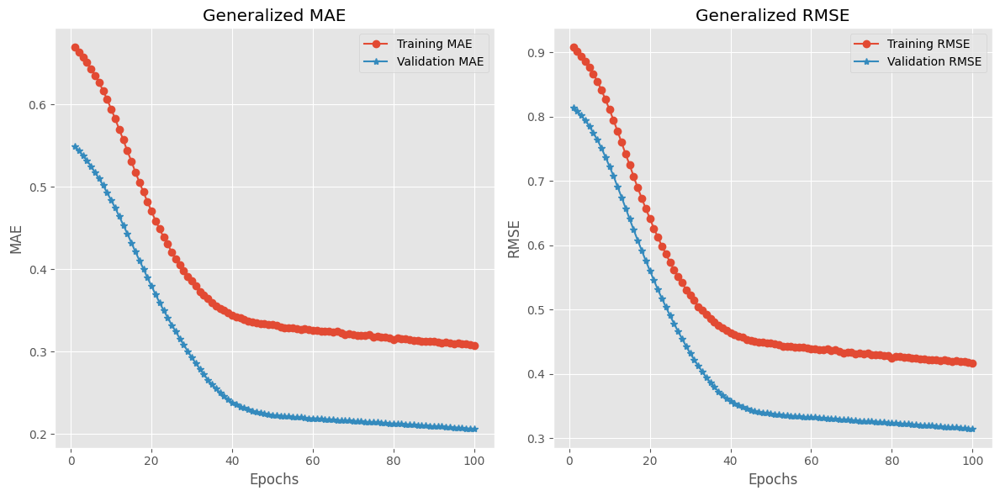

Prediction horizon 6


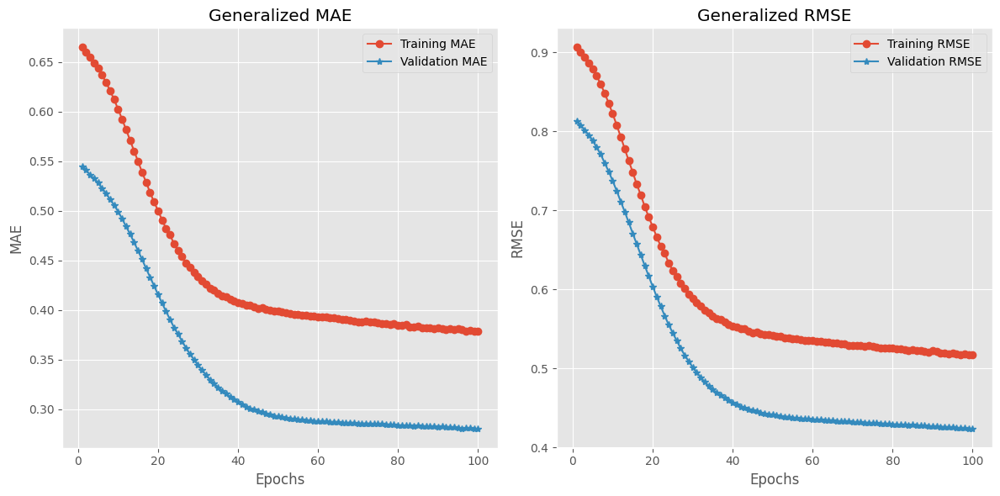

Prediction horizon 12


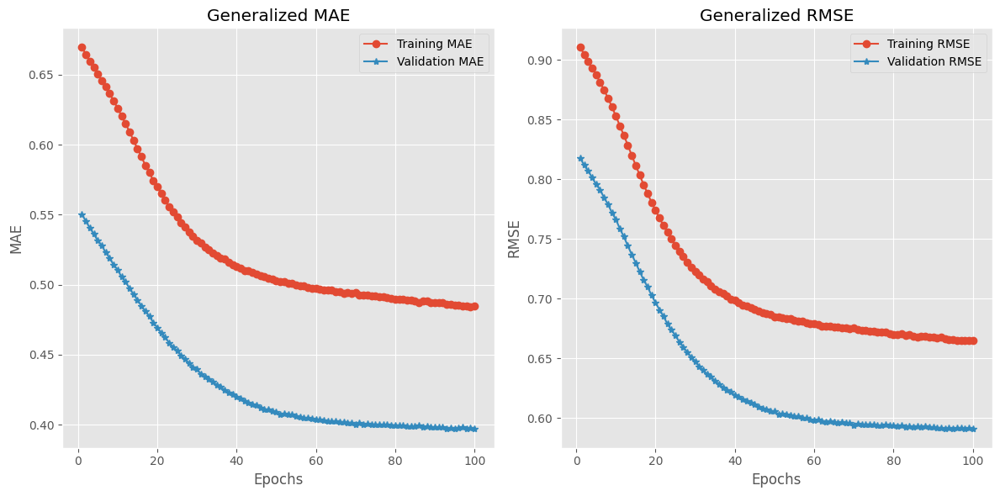

Prediction horizon 18


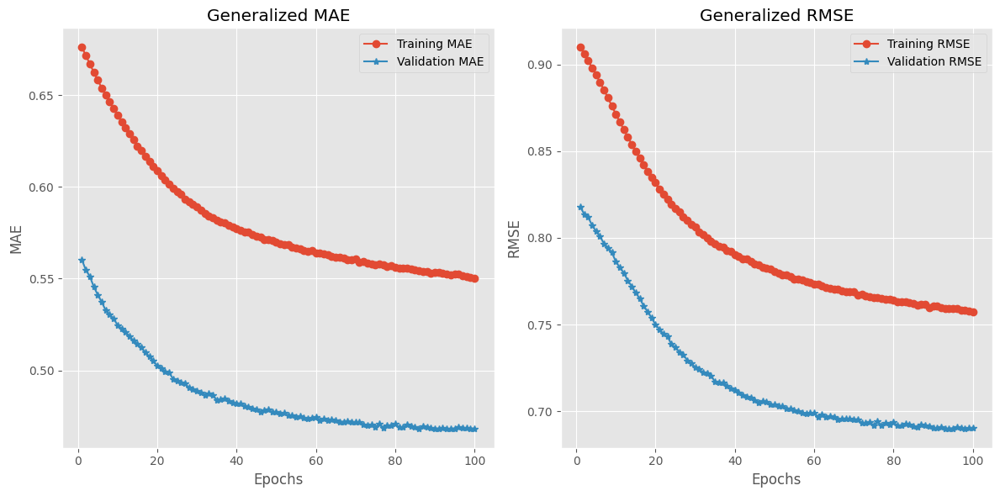

Prediction horizon 24


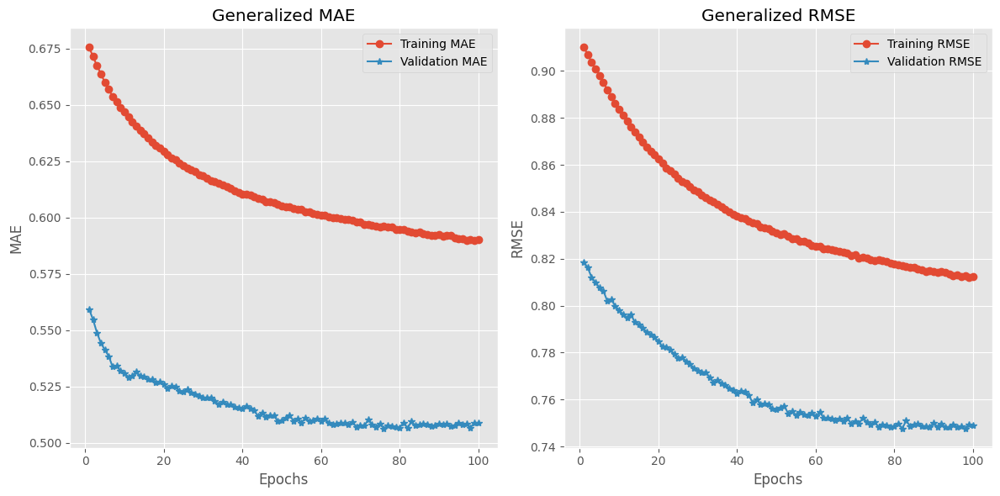

Prediction horizon 30


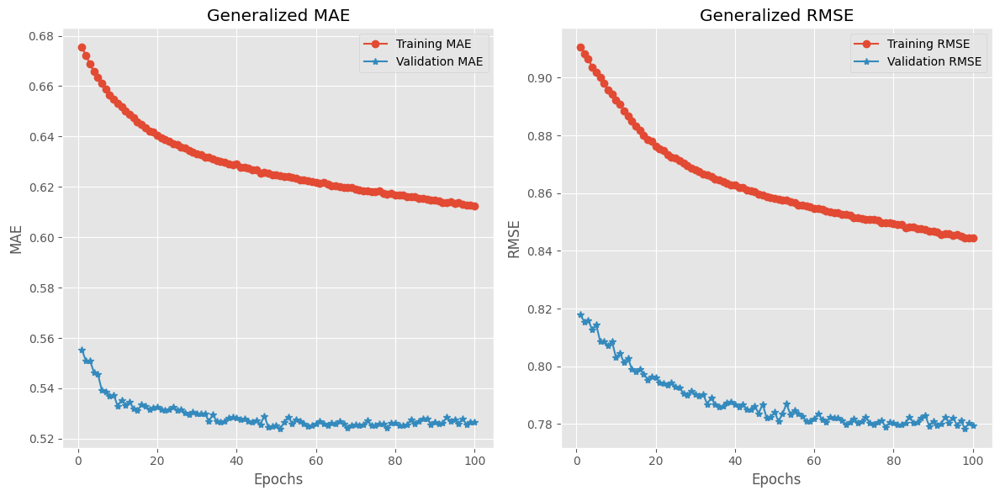

Prediction horizon 36


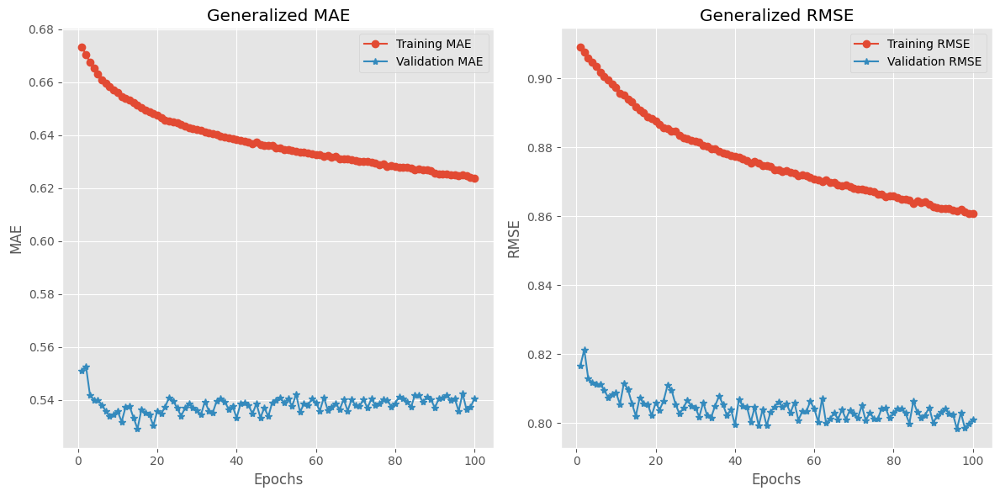

In [10]:
for i in histories_noval_PHs.items():
    print(f"Prediction horizon {i[0]}")
    plot_loss_curves(i[1])

In [12]:
abs_patients_errors_PHs_df = pd.DataFrame()
mean_ph = []
for i, patient_mae in enumerate(abs_patients_errors_PHs.values()):
    # abs_patients_errors_PHs_df[i] = patient_mae
    abs_patients_errors_PHs_df[prediction_horizons[i]] = patient_mae
    mean_ph.append(np.mean(list(patient_mae.values())))
    # abs_patients_errors_PHs_df['Mean'] = list(MAE_Patients_PHs.values())[i]
    # abs_patients_errors_PHs_df.loc[len(abs_patients_errors_PHs_df.columns)] = list(MAE_Patients_PHs.values())[i]
abs_patients_errors_PHs_df.loc[len(abs_patients_errors_PHs_df.index)] = mean_ph
# abs_patients_errors_PHs_df = abs_patients_errors_PHs_df.append(MAE_Patients_PHs,  ignore_index=True)
abs_patients_errors_PHs_df.index = patients_list+["Mean"]

abs_patients_errors_PHs_df

,3,6,12,18,24,30,36
559,8.506022,12.184721,17.040392,19.958379,22.478443,23.319994,23.601838
563,9.693039,13.741826,19.135212,22.944731,25.483147,26.087878,27.033407
570,8.571395,11.678270,16.822268,20.896997,24.182978,25.229179,26.709309
575,10.696649,14.241938,19.720784,23.982125,25.724928,26.201642,26.766984
588,10.823431,15.085576,20.665090,23.846582,25.974343,28.124102,29.219919
591,11.955370,15.732803,22.363600,25.428483,26.927827,28.358541,29.210939
540,10.790835,14.379050,21.339430,24.883681,27.022800,28.259042,29.113876
544,10.144890,13.029713,19.943722,23.419283,25.683926,26.436156,27.369970
552,9.626122,12.305421,17.095683,20.247059,21.382287,22.621550,23.379971
567,11.098449,15.370102,21.322851,24.008235,24.498756,24.137449,24.013793


In [11]:
squared_patients_errors_PHs_df = pd.DataFrame()
mean_ph2 = []

for i, patient_rmse in enumerate(squared_patients_errors_PHs.values()):
    # abs_patients_errors_PHs_df[i] = patient_mae
    squared_patients_errors_PHs_df[prediction_horizons[i]] = patient_rmse
    mean_ph2.append(np.mean(list(patient_rmse.values())))
    # print(patient_mae)
squared_patients_errors_PHs_df.loc[len(squared_patients_errors_PHs_df.index)] = mean_ph2
# abs_patients_errors_PHs_df = abs_patients_errors_PHs_df.append(MAE_Patients_PHs,  ignore_index=True)
squared_patients_errors_PHs_df.index = patients_list+["Mean"]

squared_patients_errors_PHs_df

,3,6,12,18,24,30,36
559,12.998586,18.080924,26.040035,30.937294,34.765792,36.830324,37.825899
563,15.223845,21.497237,29.272203,34.459271,37.720469,39.113679,40.224894
570,12.909567,16.868734,23.386523,28.122203,32.127405,33.988271,35.922238
575,16.756359,21.702839,29.479181,34.788839,37.262769,38.767986,39.435435
588,15.911965,22.310873,31.505615,36.287487,39.876953,41.846755,43.204096
591,17.511903,22.586925,31.115347,35.669819,38.108647,39.504657,40.884078
540,15.992129,21.291173,31.265643,36.470384,39.597874,41.147087,42.770650
544,14.875500,19.671160,28.859581,34.218930,36.815008,38.399539,39.792223
552,13.927366,18.754627,25.572403,30.323634,32.402141,35.044468,36.042531
567,17.435504,24.318286,32.749410,36.383578,38.452413,38.352018,38.460939


In [13]:
model_all_train_read =  GeneralizedModel(input_shape =input_shape , output_shape=output_shape)
model_all_train_read.load_state_dict(torch.load('saved_models\model_generalized_6.pth'))
model_all_train_read.to(device)
model_all_train_read.eval()


C:\Users\menna\AppData\Local\Temp\ipykernel_17800\1622539626.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_all_train_read.load_state_dict(torch.load('saved_model

GeneralizedModel(
  (conv_layer): Conv1d(12, 64, kernel_size=(4,), stride=(2,), padding=(1,), dilation=(2,))
  (shared_lstm): GRU(64, 128, batch_first=True)
  (fc): Linear(in_features=128, out_features=64, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (output_layer): Linear(in_features=64, out_features=12, bias=True)
)

In [14]:
_, _, _, test_loader, _, input_shape_test, _, output_shape_test =  prepare_data_loader(
                                                                                    window_size,BATCH_SIZE, prediction_horizon = 6,
                                                                                    model_type = model_type, split_ratio = 0.7, df = None, df_test = None, output_folder_train=output_folder_train, shuffle = False)


Shape of X (features): (12, 13618, 6)
Shape of y (targets): (12, 13618)
Shape of X_test (features): (12, 3939, 6)
Shape of y_test (targets): (12, 3939)


In [15]:
outputs_all_batches, targets_all_batches =  model_prediction(model_all_train_read,test_loader, device, model_type)
outputs = torch.cat(outputs_all_batches, dim=0)
targets = torch.cat(targets_all_batches, dim=0)

outputs = outputs.cpu()
targets = targets.cpu()
# Create a mask where arr1 equals 0

mask = (targets == 0.0)

# Set elements to None (or np.nan for float compatibility)
targets = np.where(mask, None, targets)
outputs = np.where(mask, None, outputs)

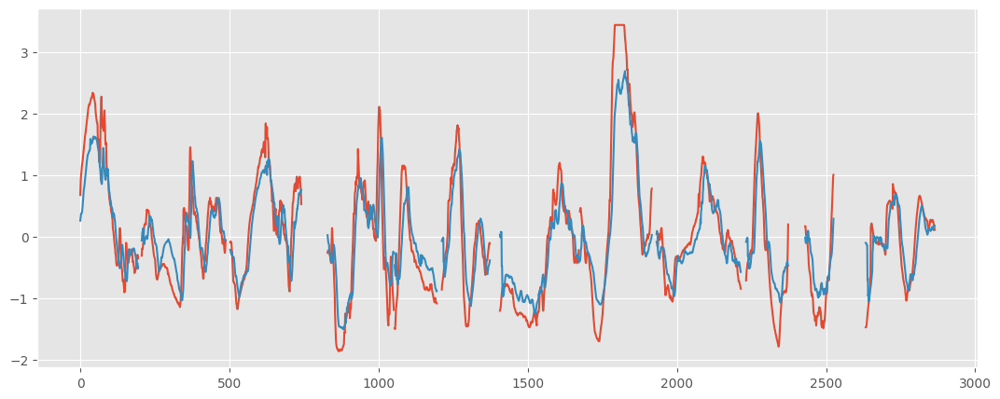

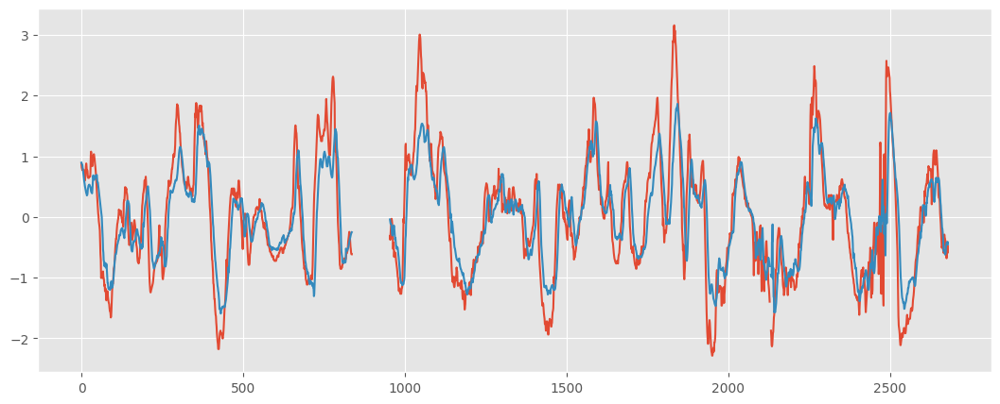

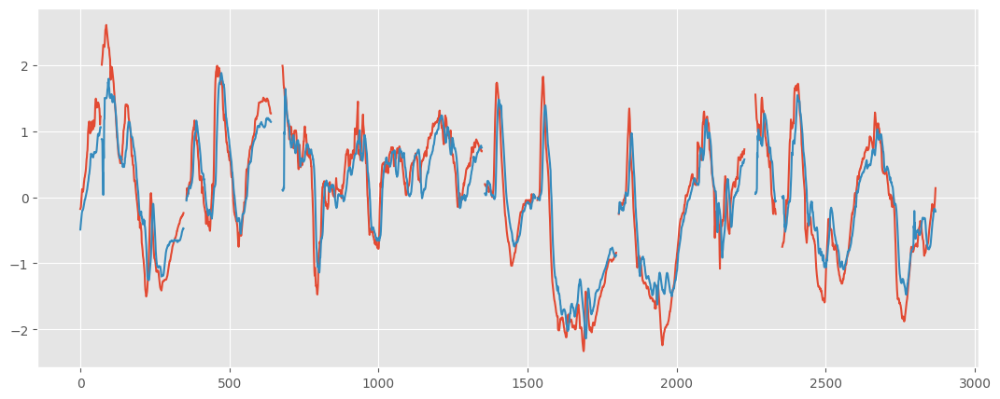

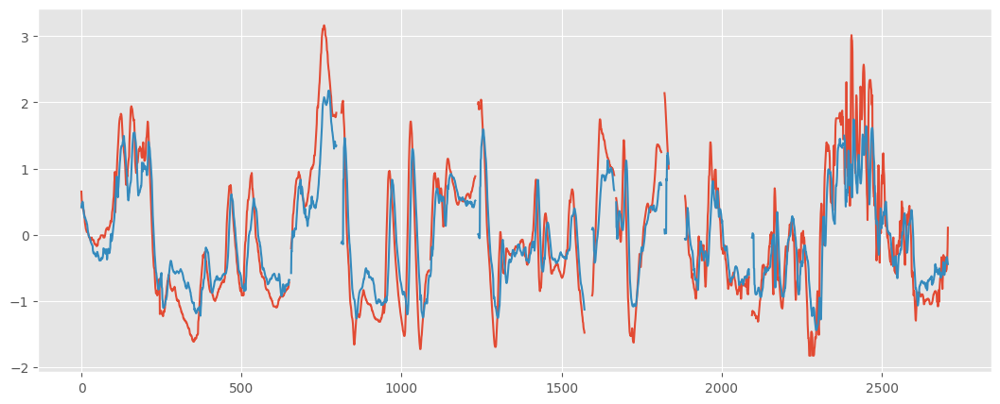

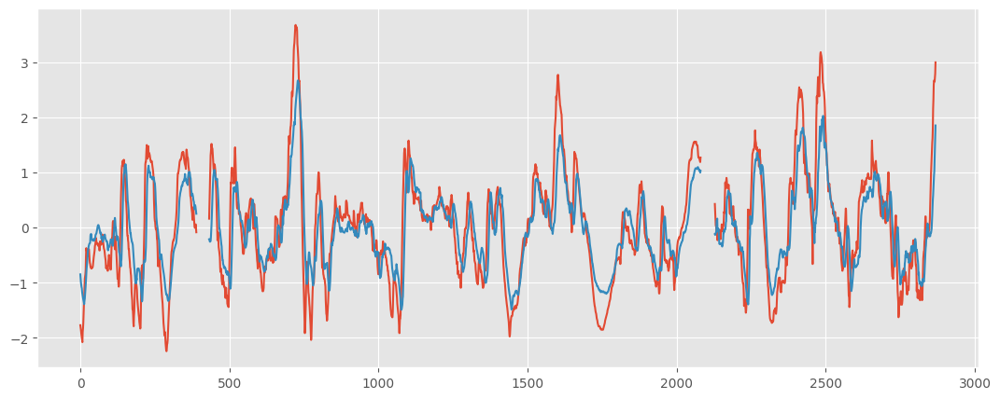

...

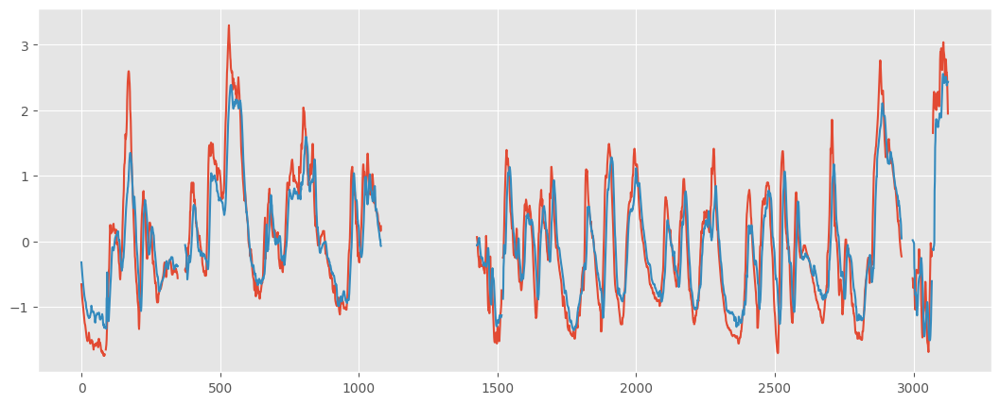

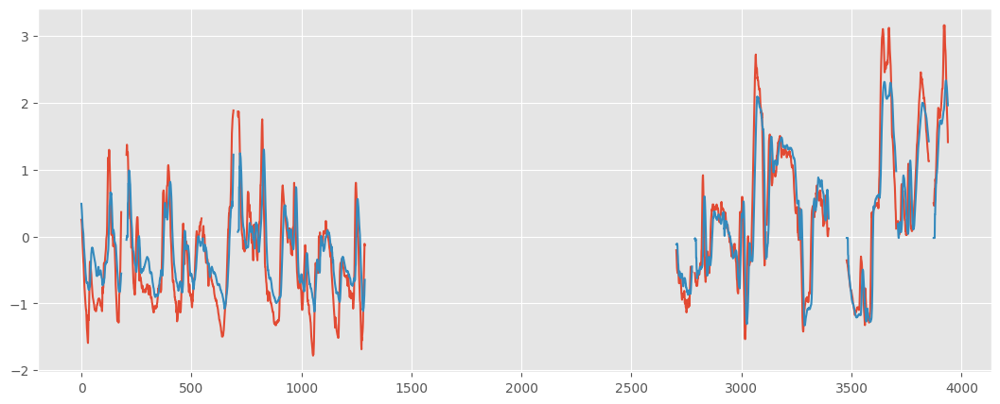

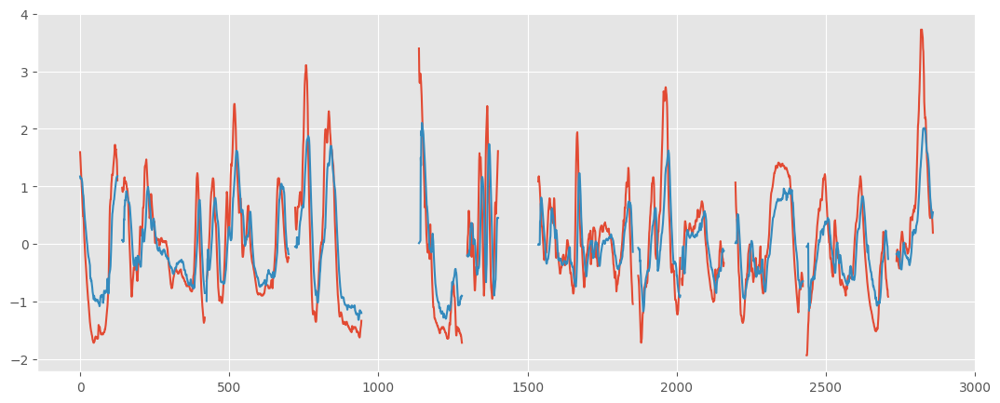

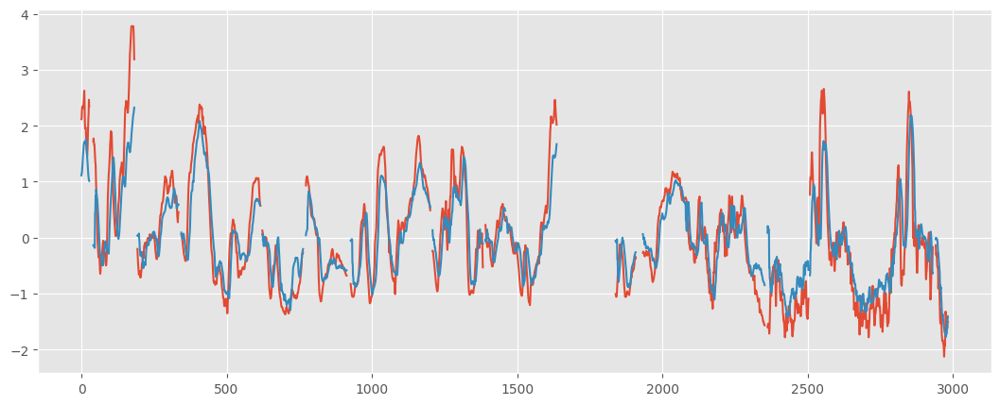

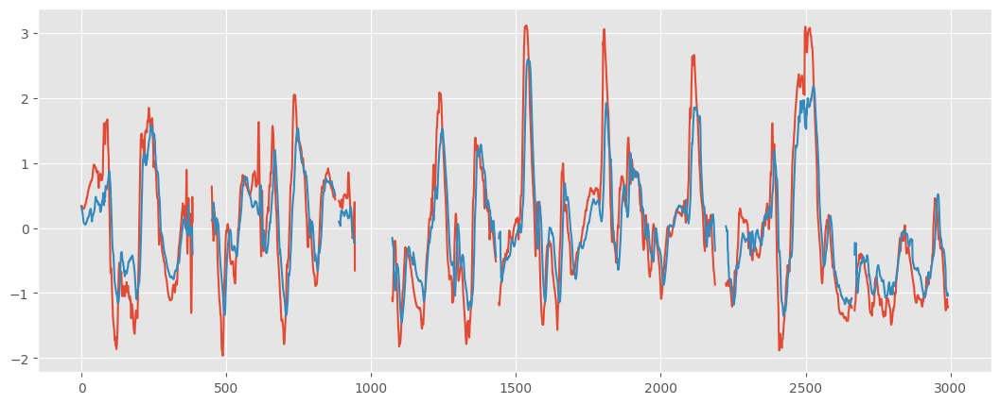

In [16]:
# index =4
for index in range(12):
    patient1_target = [sublist[index] for sublist in targets]
    patient1_output = [sublist[index]  for sublist in outputs]
    # patient1_output = outputs_all_batches[index]
    # patient1_target = targets_all_batches[index]

    # print(list(abs_patients_errors_PHs[6].values())[index])
    # print(list(squared_patients_errors_PHs[6].values())[index])

    plt.figure(figsize=(13,5))
    plt.plot(patient1_target)
    plt.plot(patient1_output)
    plt.show()

In [4]:
# from models.shared_layer import *
# from src.data_preprocessing import *

# class GeneralizedModel(nn.Module):
#     def __init__(self, input_shape, output_shape):
#         """
#         Generalized LSTM model for multiple patients.
        
#         Parameters:
#         - input_shape: Shape of the input data (sequence_length, features).
#         - output_shape: Shape of the output data (number of outputs, typically the number of patients).
#         """
#         super(GeneralizedModel, self).__init__()

#         # CNN Layer before LSTM
#         self.conv_layer = nn.Conv1d(
#             in_channels=input_shape[-1], out_channels=64, kernel_size=4, stride=2, padding=1, dilation=2
#         )
        
#         # Shared LSTM layer (across all patients)
#         self.shared_lstm = nn.GRU(input_size=64, hidden_size=128, batch_first=True)

#         # Fully connected layer for final output (shared for all patients)
#         self.fc = nn.Linear(128, 64)
#         self.dropout = nn.Dropout(0.2)

#         # Output layer for predicting for all patients in one go
#         self.output_layer = nn.Linear(64, output_shape[0])  # One output layer for all patients

#     def apply_mask(self, x):
#         """
#         Apply masking to the input tensor by replacing masked values with zeros.
#         Parameters:
#         - x: Input tensor of shape (batch_size, sequence_length, features)
#         Returns:
#         - masked_x: The input tensor where masked values are set to zero.
#         """
#         # print(np.array(x).shape)
#         if not isinstance(x, torch.Tensor):
#             # x = torch.from_numpy(x.detach().cpu().numpy())
#             x = torch.from_numpy(np.array(x))

#         mask = (x != -2.5).float()  # Create a mask where 1 indicates valid data
#         masked_x = x * mask  # Apply the mask by zeroing out the masked values
#         return masked_x, mask

#     def forward(self, x):
#         """
#         Forward pass for the model.
#         Parameters:
#         - x: Input tensor of shape (batch_size, sequence_length, features)
#         Returns:
#         - output: Tensor of shape (batch_size, num_patients)
#         """
#         # Apply mask to the input
#         masked_input, mask = self.apply_mask(x)
#         # print(masked_input.shape)

#         conv_input = masked_input.squeeze(-1).permute(1, 0, 2) # (batch_size, num_features, sequence_length)
#         # print(conv_input.shape)

#         # Convolution layer
#         conv_out = self.conv_layer(conv_input)  # (batch_size, 64, sequence_length after conv)
        
#         # LSTM layer: transpose back to (batch_size, sequence_length, features) after conv
#         lstm_input = conv_out.transpose(1, 2)  # (batch_size, sequence_length, 64)
#         lstm_out, _ = self.shared_lstm(lstm_input)

#         # Take the last output of the LSTM (corresponding to the last timestep)
#         lstm_out_last = lstm_out[:, -1, :]  # (batch_size, 128)

#         # Fully connected layer
#         fc_out = F.relu(self.fc(lstm_out_last))  # (batch_size, 64)
#         fc_out = self.dropout(fc_out)

#         # Output layer for predictions
#         output = self.output_layer(fc_out)  # (batch_size, num_patients)

#         return output

In [5]:

# def train_model(model, train_loader, val_loader, epochs, learning_rate):
#     """
#     Train the LSTM model using a custom training loop with tqdm progress bars.
#     Also evaluates the model on validation data after each epoch.
    
#     Logs key training events and results to both the console and a log file.
    
#     Parameters:
#     - model: The model to train.
#     - train_loader: DataLoader for training data.
#     - val_loader: DataLoader for validation data.
#     - epochs: Number of epochs to train for.
#     - learning_rate: Learning rate for optimizer.
    
#     Returns:
#     - history: Dictionary containing the training and validation MAE and RMSE for each epoch.
#     """
#     # Define the optimizer and the loss functions (MAE and MSE)
#     optimizer = optim.Adam(model.parameters(), lr=learning_rate)
#     criterion_mae = torch.nn.L1Loss()  # Mean Absolute Error
#     criterion_mse = torch.nn.MSELoss()  # Mean Squared Error (for RMSE calculation)

#     # Move model to GPU if available
#     device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#     model = model.to(device)
#     # print(device)
#     # Initialize lists to store the history of losses
#     history = {
#         'train_mae': [],
#         'train_rmse': [],
#         'val_mae': [],
#         'val_rmse': []
#     }

#     logger.info(f"Starting training for {epochs} epochs with learning rate {learning_rate}.")

#     # Training loop
#     for epoch in range(epochs):
#         model.train()  # Set model to training mode
#         running_mae_loss = 0.0
#         running_mse_loss = 0.0
#         num_batches = len(train_loader)

#         # Add tqdm progress bar for each epoch
#         with tqdm(total=num_batches, desc=f'Epoch {epoch + 1}/{epochs}', unit='batch') as pbar:
#             for batch_idx, (inputs, targets) in enumerate(train_loader):
#                 # Move data to device (GPU or CPU)
#                 inputs = [inp for inp in inputs]
#                 # print(inputs)
#                 inputs = torch.tensor(np.array(inputs)).to(device)
#                 targets = targets.to(device)
                
#                 # Zero the parameter gradients
#                 optimizer.zero_grad()
                
#                 # Forward pass
#                 # print(inputs.is_cuda)
#                 outputs = model(inputs)

#                 # Compute losses
#                 mae_loss = criterion_mae(outputs, targets)
#                 mse_loss = criterion_mse(outputs, targets)

#                 # Backward pass and optimization
#                 mae_loss.backward()  
#                 optimizer.step()
                
#                 running_mae_loss += mae_loss.item()
#                 running_mse_loss += mse_loss.item()

#                 # Update progress bar
#                 pbar.set_postfix(mae_loss=mae_loss.item())
#                 pbar.update(1)
        
#         # Calculate average training loss for the epoch
#         avg_train_mae = running_mae_loss / num_batches
#         avg_train_rmse = np.sqrt(running_mse_loss / num_batches)
#         history['train_mae'].append(avg_train_mae)
#         history['train_rmse'].append(avg_train_rmse)
#         # Log training loss

#         logger.info(f"Epoch [{epoch + 1}/{epochs}], Training MAE: {avg_train_mae:.4f}, Training RMSE: {avg_train_rmse:.4f}")

#         if val_loader != None:
#             # Validate the model after each epoch
#             avg_val_mae, avg_val_rmse = validate_model(model, val_loader, criterion_mae, criterion_mse, device)
            
#             # Log validation loss
#             logger.info(f"Epoch [{epoch + 1}/{epochs}], Validation MAE: {avg_val_mae:.4f}, Validation RMSE: {avg_val_rmse:.4f}")
            
#             # Print validation loss
#             print(f"Epoch [{epoch + 1}/{epochs}], Validation MAE: {avg_val_mae:.4f}, Validation RMSE: {avg_val_rmse:.4f}")
            
#             # Store the losses in history

#             history['val_mae'].append(avg_val_mae)
#             history['val_rmse'].append(avg_val_rmse)

#     # Return the model and the history of losses
#     return model, history


In [116]:
# conv_input = masked_input.squeeze(-1).permute(0, 2, 1) # (batch_size, num_features, sequence_length)
summary(model, input_size=(64,12, 1))


torch.Size([2, 64, 12, 1])
torch.Size([2, 12, 64])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1               [-1, 64, 30]           3,136
               GRU-2  [[-1, 30, 128], [-1, 2, 128]]               0
            Linear-3                   [-1, 64]           8,256
           Dropout-4                   [-1, 64]               0
            Linear-5                   [-1, 12]             780
Total params: 12,172
Trainable params: 12,172
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 7.48
Params size (MB): 0.05
Estimated Total Size (MB): 7.53
----------------------------------------------------------------
